<a href="https://colab.research.google.com/github/ggmins999/ImageRegistration/blob/master/CometNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Detectron2 Beginner's Tutorial

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


# Install detectron2

In [1]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 13.5MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=ff71983e1aa751f4c004563bb708c9cbaa743dca9d77e6faffd87ca2995c46d1
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 735kB/s 
     |████████████████████████████████| 2.2MB 18.1MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201218-cp36-none-any.whl size=40701 sha256=3053d77e728aabf3356b7ce14f2e2fbc1914c63405b4020d1ffd9a8becd5c254
  Stored in directory: /root/.cache/pip/wheels/b5/83/3f/e74a72d264351b5ada512da845a5c6abb81a34f6333c3a54ce
  Created wheel for iopath: filename=iopath-0.1.2-cp36-none-any.whl size=10508 sha256=c4f9a528f998df5e06434bc5b8c857e830e15c79cacec779b40f8c02fd7ec4fe
  Stored in directory: /root/.cache/pip/wheels/9e/01/e4/1b68f5a2a6b9450ea4246d91840a77e1169f7d4722d76bbc47
Successfully built fvcore iopath
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.

In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [2]:
from google.colab import drive
#drive.mount('/content/drive')
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


# Run a pre-trained detectron2 model

In [3]:
!wget https://storage.googleapis.com/icebear/tmp/testdata.tgz
!tar -zxvf testdata.tgz

--2020-12-28 00:38:41--  https://storage.googleapis.com/icebear/tmp/testdata.tgz
Resolving storage.googleapis.com (storage.googleapis.com)... 172.217.164.176, 172.217.2.112, 172.217.7.240, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.217.164.176|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1472880 (1.4M) [application/x-tar]
Saving to: ‘testdata.tgz’

testdata.tgz        100%[===================>]   1.40M  --.-KB/s    in 0.01s   

2020-12-28 00:38:41 (108 MB/s) - ‘testdata.tgz’ saved [1472880/1472880]

._TestforNN1
TestforNN1/
TestforNN1/comet109.png
TestforNN1/comet121.png
TestforNN1/comet135.png
TestforNN1/comet3.png
TestforNN1/comet43.png
TestforNN1/comet57.png
TestforNN1/comet80.png
TestforNN1/comet94.png
TestforNN1/comet95.png
TestforNN1/comet81.png
TestforNN1/comet56.png
TestforNN1/comet42.png
TestforNN1/comet2.png
TestforNN1/comet134.png
TestforNN1/comet120.png
TestforNN1/comet108.png
TestforNN1/comet136.png
TestforNN1/comet12

In [4]:
!wget https://storage.googleapis.com/icebear/tmp/mergedcomets.tgz
!tar -zxvf mergedcomets.tgz


--2020-12-28 00:38:44--  https://storage.googleapis.com/icebear/tmp/mergedcomets.tgz
Resolving storage.googleapis.com (storage.googleapis.com)... 172.217.2.112, 172.217.7.240, 172.217.8.16, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.217.2.112|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 449952 (439K) [application/x-tar]
Saving to: ‘mergedcomets.tgz’

mergedcomets.tgz    100%[===================>] 439.41K  --.-KB/s    in 0.005s  

2020-12-28 00:38:44 (89.7 MB/s) - ‘mergedcomets.tgz’ saved [449952/449952]

trainval.json
Merged/
Merged/Medium_comet78.json
Merged/High_comet20.json
Merged/Low_comet42.png
Merged/Medium_comet7.png
Merged/Low_comet49.json
Merged/Low_comet56.png
Merged/Medium_comet97.json
Merged/Low_comet8.json
Merged/Low_comet130.json
Merged/Low_comet81.png
Merged/Low_comet95.png
Merged/High_comet98.json
Merged/Low_comet122.png
Merged/Low_comet136.png
Merged/Medium_comet7.json
Merged/Medium_comet39.json
Merged/High_comet6

We first download an image from the COCO dataset:

In [5]:
path = f'/content/Merged/Low_comet1.png'
print(path)
im = cv2.imread(path)
cv2_imshow(im)

/content/Merged/Low_comet1.png


Then, we create a detectron2 config and a detectron2 `DefaultPredictor` to run inference on this image.

In [11]:
TRAINED_MODEL_DIR =  f'/content/drive/MyDrive/TrainingData/Model'


cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.OUTPUT_DIR = TRAINED_MODEL_DIR
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

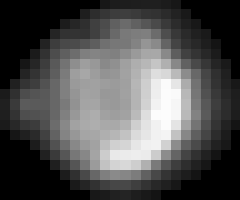

In [7]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=10)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the balloon segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)
which only has one class: balloon.
We'll train a balloon segmentation model from an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

Note that COCO dataset does not have the "balloon" category. We'll be able to recognize this new class in a few minutes.

## Prepare the dataset

Register the balloon dataset to detectron2, following the [detectron2 custom dataset tutorial](https://detectron2.readthedocs.io/tutorials/datasets.html).
Here, the dataset is in its custom format, therefore we write a function to parse it and prepare it into detectron2's standard format. User should write such a function when using a dataset in custom format. See the tutorial for more details.


In [8]:

# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("comets", {}, f'/content/drive/MyDrive/PyCharm Projects/LowMedHigh/trainval.json',
                        f'/content/drive/MyDrive/PyCharm Projects/LowMedHigh/Merged')
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

comet_metadata = MetadataCatalog.get("comets")

To verify the data loading is correct, let's visualize the annotations of randomly selected samples in the training set:



WARNING [12/28 00:39:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/28 00:39:30 d2.data.datasets.coco]: Loaded 1485 images in COCO format from /content/drive/MyDrive/PyCharm Projects/LowMedHigh/trainval.json


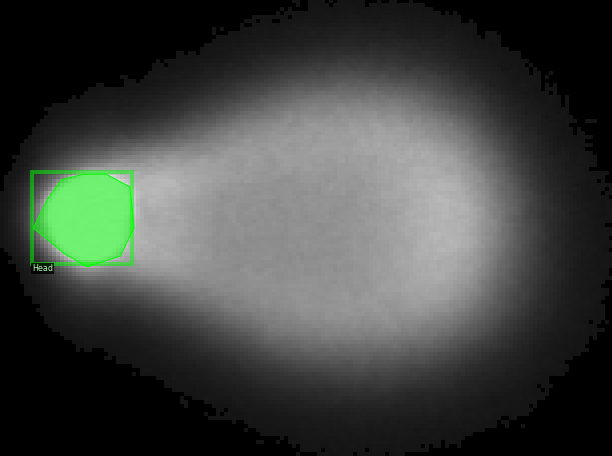

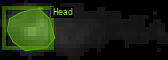

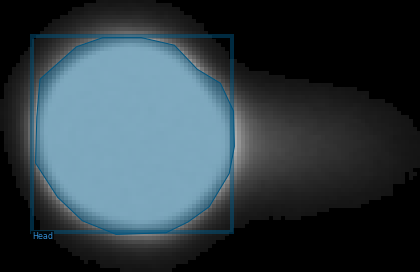

In [9]:
dataset_dicts = DatasetCatalog.get("comets")
metadata = MetadataCatalog.get("comets")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=4)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~6 minutes to train 300 iterations on Colab's K80 GPU, or ~2 minutes on a P100 GPU.


In [12]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.OUTPUT_DIR = TRAINED_MODEL_DIR
cfg.DATASETS.TRAIN = ("comets",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 3000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[12/28 00:46:33 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[12/28 00:46:39 d2.engine.train_loop]: Starting training from iteration 0
[12/28 00:46:48 d2.utils.events]:  eta: 0:23:26  iter: 19  total_loss: 1.786  loss_cls: 0.632  loss_box_reg: 0.4392  loss_mask: 0.6871  loss_rpn_cls: 0.02464  loss_rpn_loc: 0.009998  time: 0.4671  data_time: 0.0200  lr: 4.9953e-06  max_mem: 2848M
[12/28 00:46:58 d2.utils.events]:  eta: 0:23:49  iter: 39  total_loss: 1.687  loss_cls: 0.5444  loss_box_reg: 0.4018  loss_mask: 0.6722  loss_rpn_cls: 0.03342  loss_rpn_loc: 0.009895  time: 0.4805  data_time: 0.0051  lr: 9.9902e-06  max_mem: 2937M
[12/28 00:47:07 d2.utils.events]:  eta: 0:23:25  iter: 59  total_loss: 1.468  loss_cls: 0.417  loss_box_reg: 0.4189  loss_mask: 0.637  loss_rpn_cls: 0.02831  loss_rpn_loc: 0.009744  time: 0.4766  data_time: 0.0048  lr: 1.4985e-05  max_mem: 2937M
[12/28 00:47:17 d2.utils.events]:  eta: 0:23:16  iter: 79  total_loss: 1.396  loss_cls: 0.334  loss_box_reg: 0.4487  loss_mask: 0.5896  loss_rpn_cls: 0.01476  loss_rpn_loc: 0.008199  ti

In [15]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 565), started 0:00:30 ago. (Use '!kill 565' to kill it.)

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [16]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Then, we randomly select several samples to visualize the prediction results.

WARNING [12/28 01:17:08 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/28 01:17:08 d2.data.datasets.coco]: Loaded 1485 images in COCO format from /content/drive/MyDrive/PyCharm Projects/LowMedHigh/trainval.json


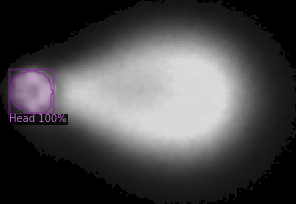

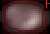

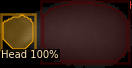

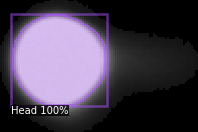

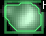

...

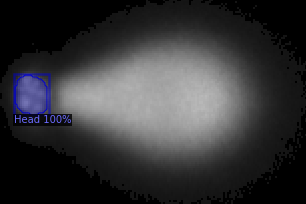

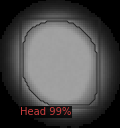

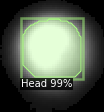

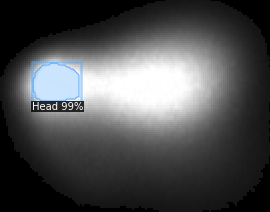

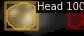

In [17]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("comets")
for d in random.sample(dataset_dicts, 20):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=metadata, 
                   scale=2, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

In [15]:
!wget https://storage.googleapis.com/icebear_comets/lowtest.tgz
!tar -zxvf lowtest.tgz


--2020-12-27 20:43:40--  https://storage.googleapis.com/icebear_comets/lowtest.tgz
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.20.128, 108.177.98.128, 74.125.197.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.20.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 66461 (65K) [application/x-gzip]
Saving to: ‘lowtest.tgz’

lowtest.tgz         100%[===================>]  64.90K  --.-KB/s    in 0.001s  

2020-12-27 20:43:40 (116 MB/s) - ‘lowtest.tgz’ saved [66461/66461]

Low/
Low/comet109.png
Low/comet121.png
Low/comet135.png
Low/comet3.png
Low/comet43.png
Low/comet57.png
Low/comet80.png
Low/comet94.png
Low/comet95.png
Low/comet81.png
Low/comet56.png
Low/comet42.png
Low/comet2.png
Low/comet134.png
Low/comet120.png
Low/comet108.png
Low/comet136.png
Low/comet122.png
Low/comet54.png
Low/comet40.png
Low/comet68.png
Low/comet97.png
Low/comet83.png
Low/comet82.png
Low/comet96.png
Low/comet69.png
Low/comet41.png
Low/

path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet39.png d=comet39.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


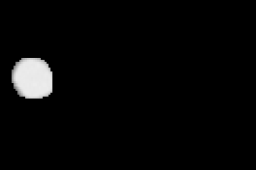

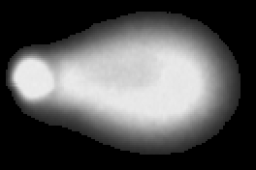

0.9164448647300361
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet206.png d=comet206.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


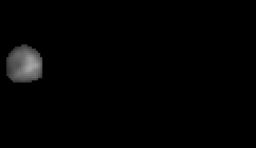

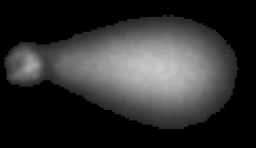

0.937518261078797
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet159.png d=comet159.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


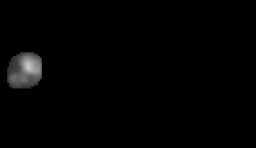

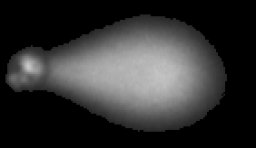

0.9421498201953871
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet62.png d=comet62.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


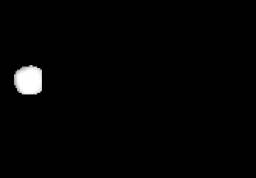

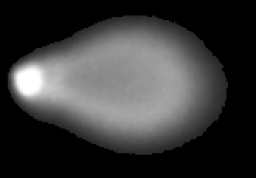

0.9358955842430676
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet23.png d=comet23.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


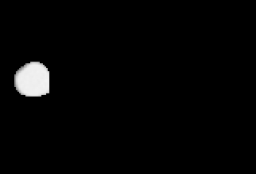

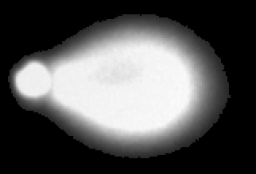

0.9390864345548913
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet84.png d=comet84.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


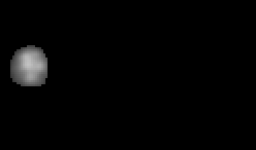

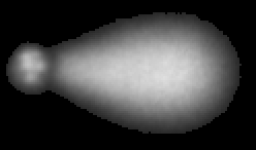

0.9346836999832937
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet137.png d=comet137.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


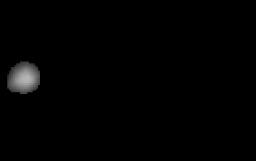

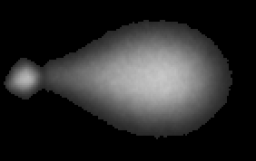

0.9454373763357653
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet178.png d=comet178.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


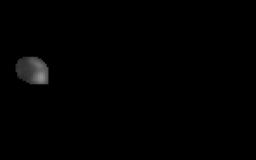

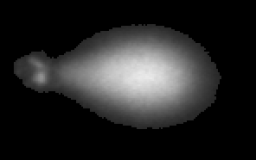

0.9617168873977741
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet307.png d=comet307.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


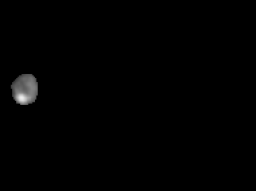

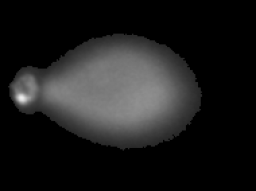

0.9450329675990315
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet320.png d=comet320.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


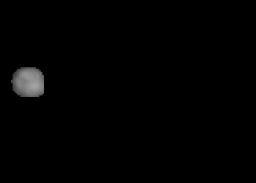

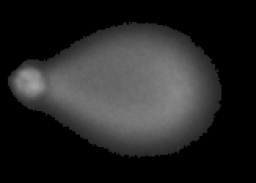

0.9429808211251384
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet220.png d=comet220.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


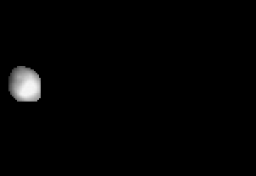

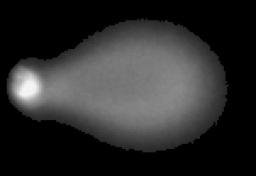

0.9159182695499802
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet309.png d=comet309.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


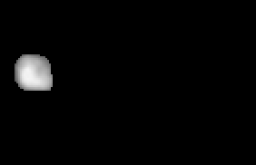

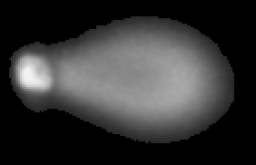

0.9019880236670901
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet335.png d=comet335.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


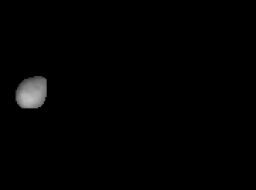

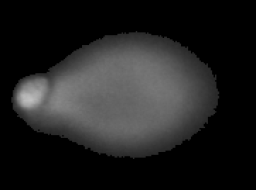

0.9293823483790911
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet332.png d=comet332.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


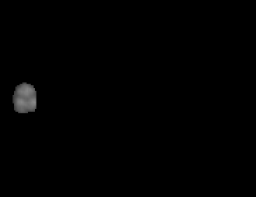

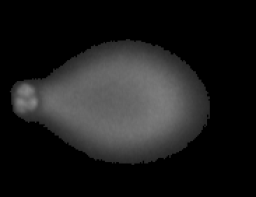

0.9571341448473578
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet300.png d=comet300.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


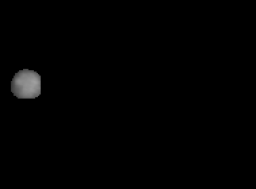

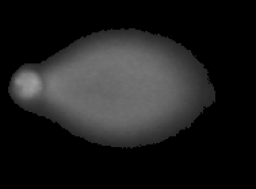

0.9405047324927799
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet234.png d=comet234.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


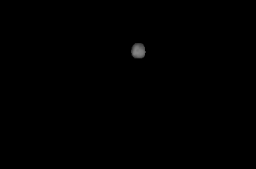

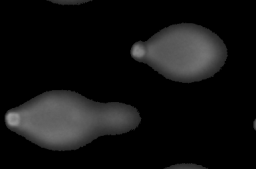

0.9762238130209084
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet223.png d=comet223.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


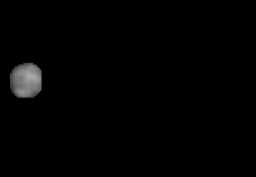

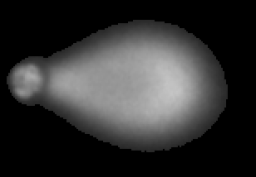

0.9493359225994382
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet264.png d=comet264.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


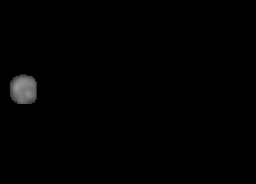

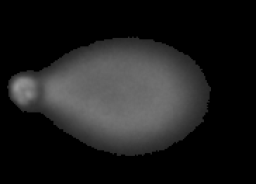

0.9462131570415686
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet72.png d=comet72.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


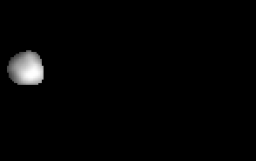

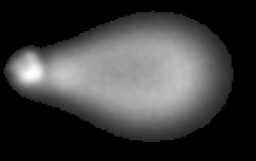

0.9312555720476214
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet38.png d=comet38.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


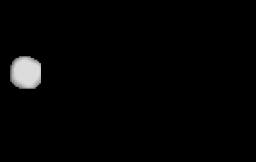

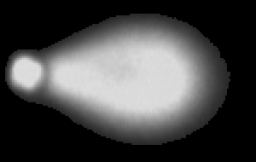

0.9410957801963341
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet279.png d=comet279.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


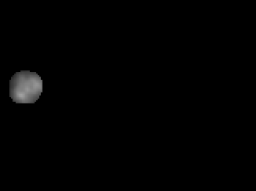

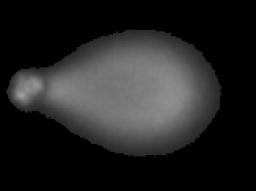

0.9443978349700644
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet180.png d=comet180.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


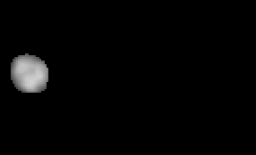

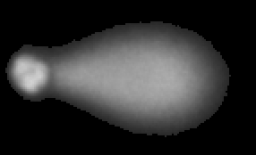

0.8990122747606362
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet193.png d=comet193.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


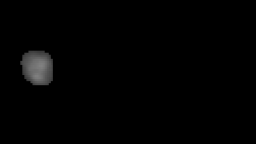

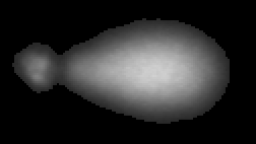

0.9458845049027467
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet265.png d=comet265.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


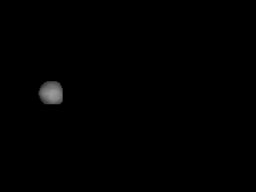

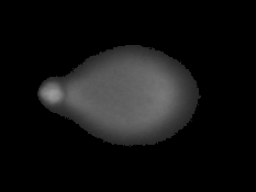

0.9432685842460129
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet174.png d=comet174.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


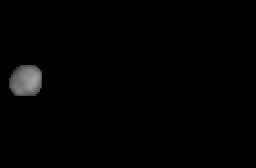

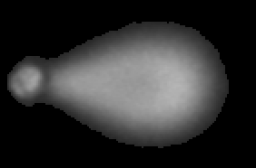

0.9504719504800568
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet33.png d=comet33.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


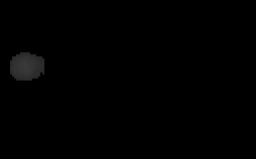

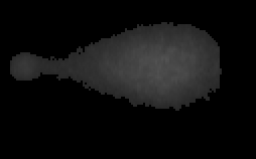

0.9362970774940678
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet25.png d=comet25.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


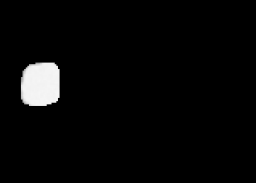

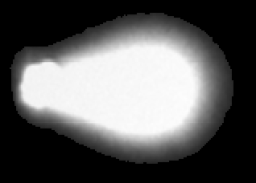

0.9152772313086501
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet34.png d=comet34.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


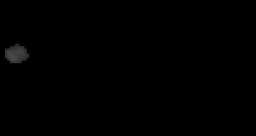

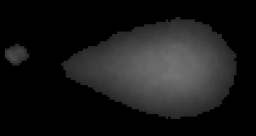

0.9768541528606141
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet58.png d=comet58.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


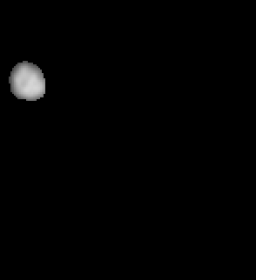

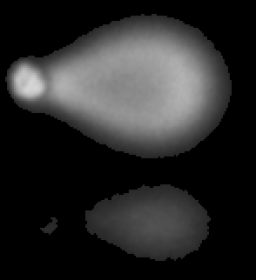

0.9385823412566157
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet60.png d=comet60.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


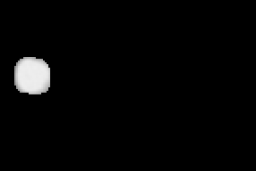

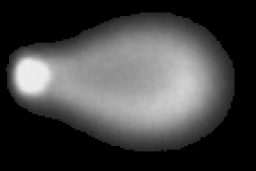

0.9134538165650373
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet4.png d=comet4.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet200.png d=comet200.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


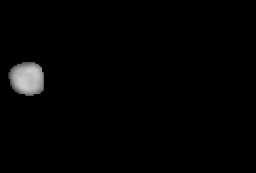

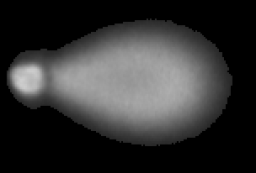

0.928978046643688
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet283.png d=comet283.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


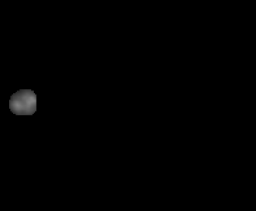

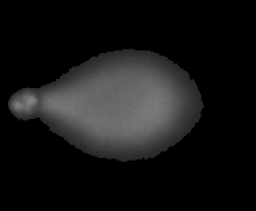

0.9546674364038034
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet197.png d=comet197.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


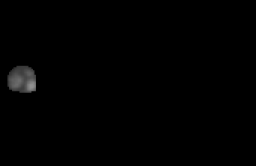

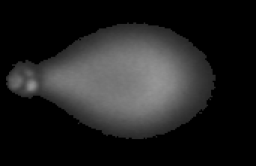

0.9618998747728492
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet291.png d=comet291.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


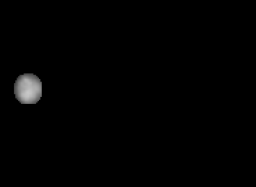

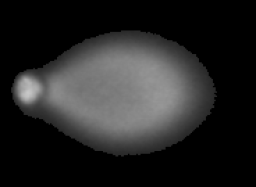

0.9442469128836992
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet284.png d=comet284.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


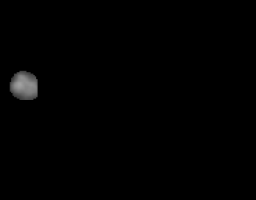

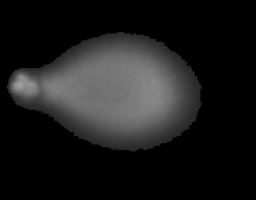

0.9470896779293988
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet219.png d=comet219.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


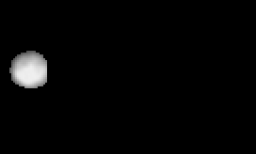

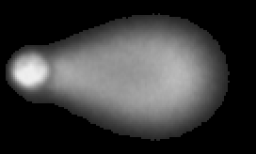

0.9077911141135862
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet294.png d=comet294.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


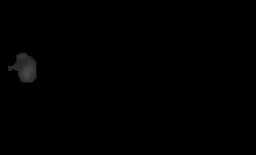

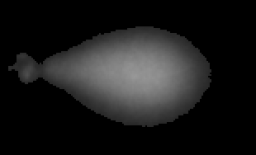

0.9738607010591616
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet168.png d=comet168.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


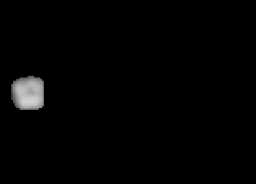

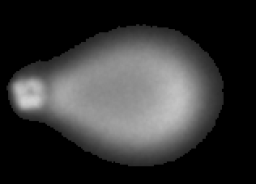

0.9373798458683695
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet164.png d=comet164.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


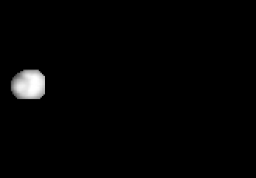

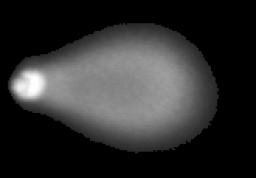

0.9158991980351573
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet292.png d=comet292.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet203.png d=comet203.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


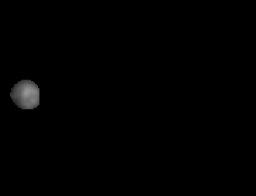

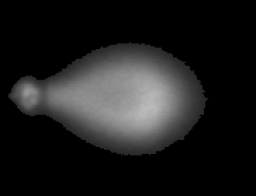

0.9551115682225418
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet51.png d=comet51.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


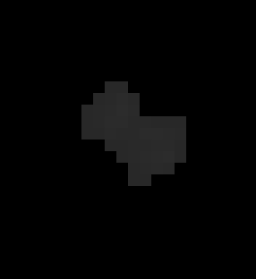

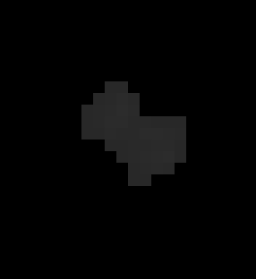

0.0
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet104.png d=comet104.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


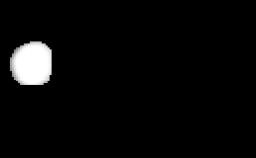

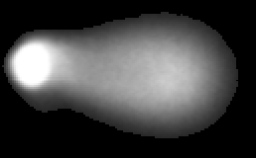

0.8611896140598782
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet213.png d=comet213.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


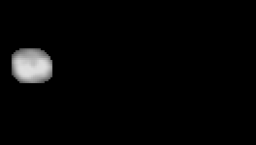

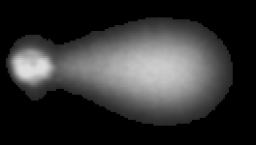

0.8853511433803092
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet248.png d=comet248.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


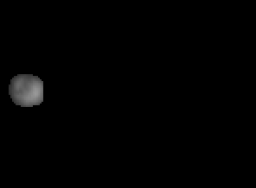

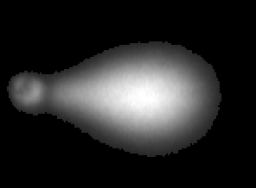

0.9520427580291299
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet92.png d=comet92.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


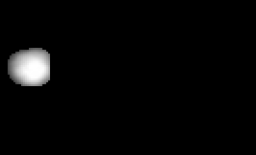

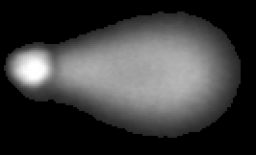

0.8926751459452943
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet117.png d=comet117.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


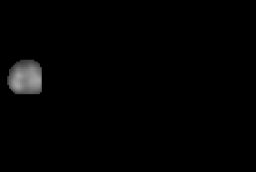

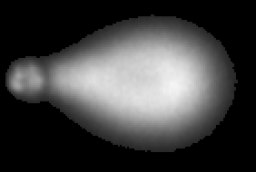

0.9568533293179021
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet131.png d=comet131.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


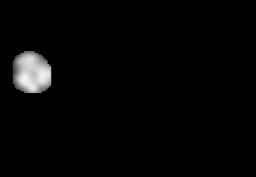

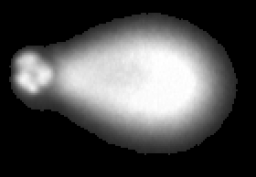

0.9288262700058818
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet132.png d=comet132.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


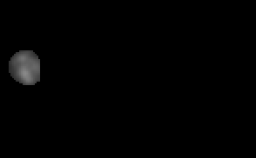

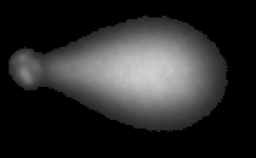

0.9559096190029028
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet133.png d=comet133.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


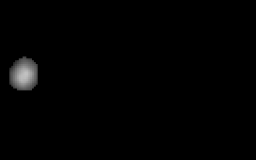

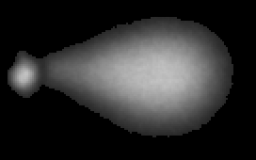

0.9493410752201777
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet338.png d=comet338.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


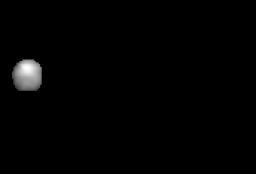

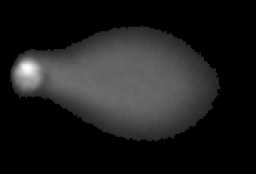

0.9075358189802334
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet160.png d=comet160.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


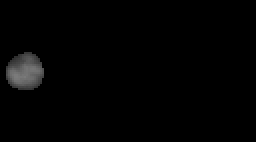

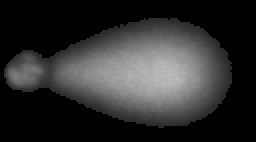

0.9406543156712671
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet329.png d=comet329.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


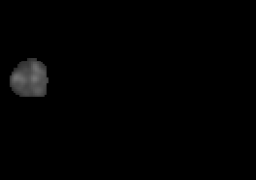

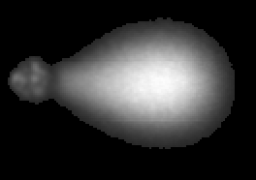

0.9586191193068732
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet44.png d=comet44.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


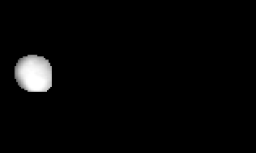

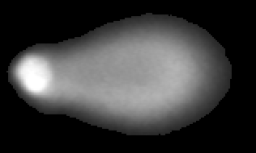

0.8924515555635355
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet158.png d=comet158.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


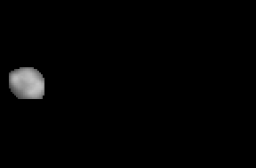

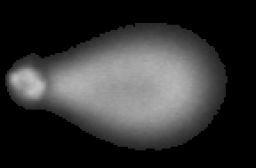

0.9337934476954339
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet207.png d=comet207.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


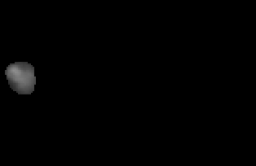

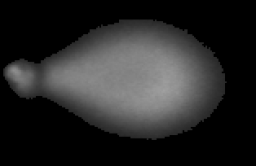

0.9579914174818365
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet102.png d=comet102.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


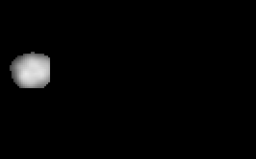

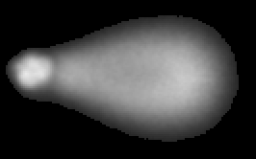

0.9151152894972138
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet18.png d=comet18.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


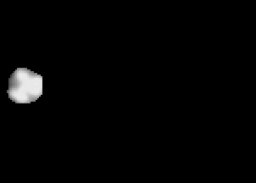

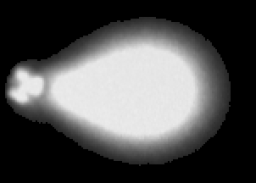

0.9472175562053416
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet202.png d=comet202.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


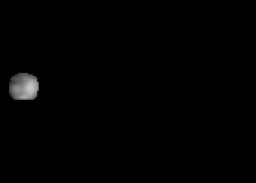

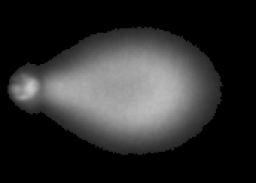

0.9588634258191894
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet112.png d=comet112.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


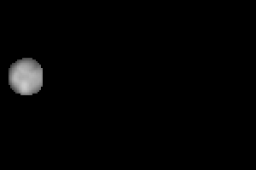

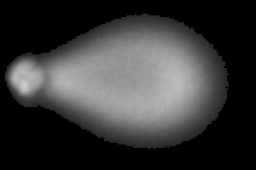

0.9345506470455235
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet113.png d=comet113.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


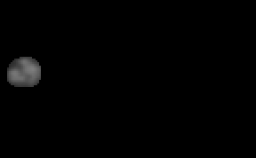

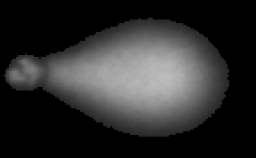

0.9583173218201134
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet21.png d=comet21.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


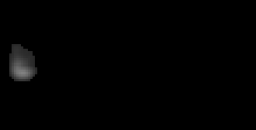

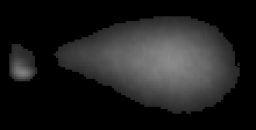

0.9464418057828987
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet49.png d=comet49.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


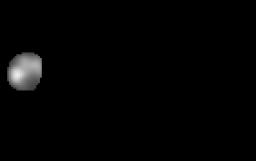

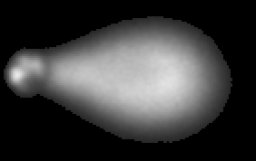

0.9399656483966329
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet125.png d=comet125.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


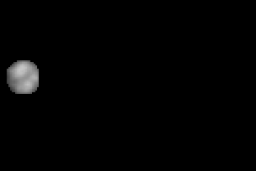

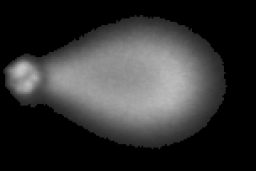

0.9419404291476423
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet251.png d=comet251.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


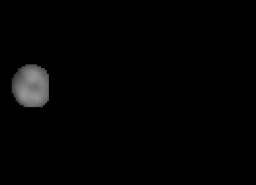

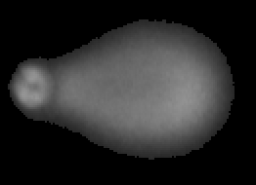

0.9225146478582171
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet239.png d=comet239.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


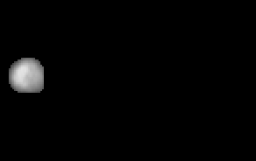

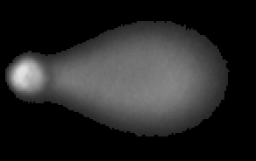

0.8950040652683173
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet116.png d=comet116.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


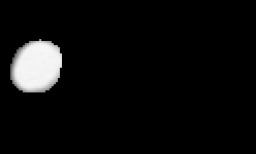

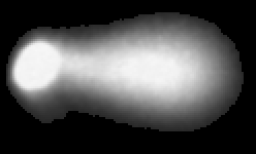

0.8398298805892598
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet272.png d=comet272.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


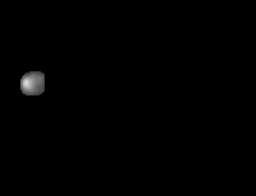

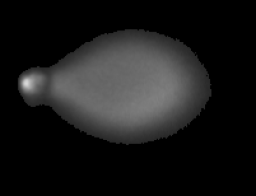

0.9537112811360443
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet308.png d=comet308.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


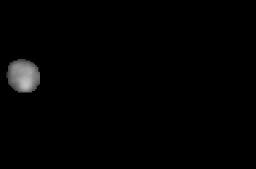

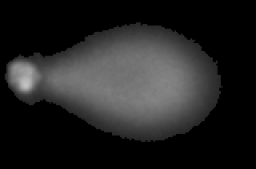

0.9238833835990234
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet5.png d=comet5.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


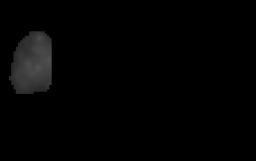

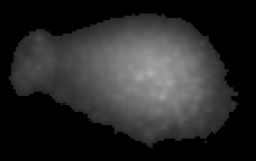

0.9248116970736647
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet204.png d=comet204.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


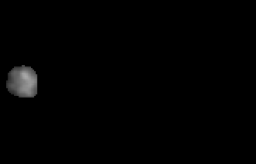

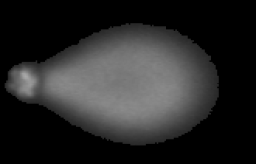

0.9482523588349155
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet258.png d=comet258.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


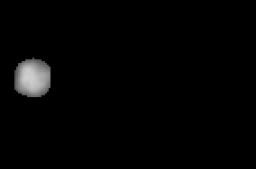

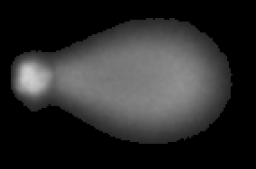

0.9060161674517974
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet86.png d=comet86.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


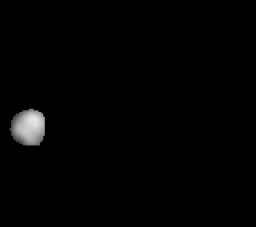

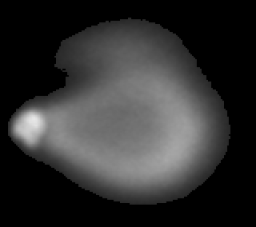

0.93966211441437
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet323.png d=comet323.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


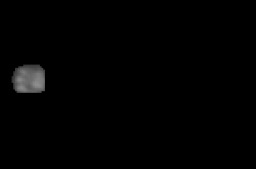

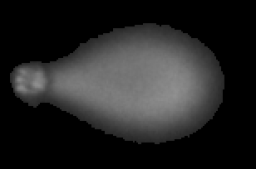

0.9457452611843464
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet40.png d=comet40.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


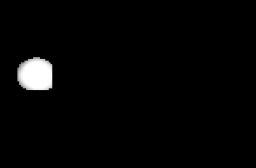

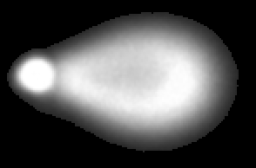

0.9322610142248237
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet129.png d=comet129.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


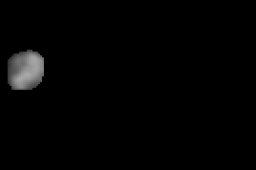

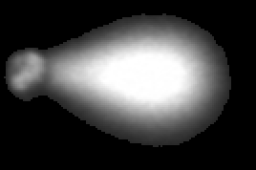

0.9480661807871658
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet199.png d=comet199.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


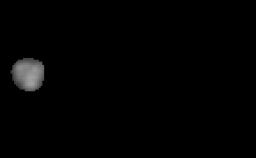

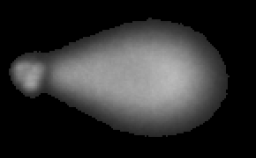

0.9452493000833412
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet124.png d=comet124.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


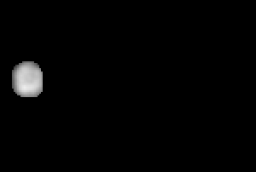

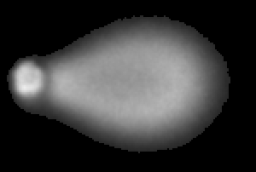

0.9335669727342819
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet215.png d=comet215.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


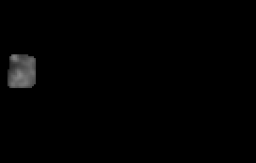

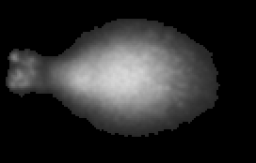

0.9530034510176814
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet47.png d=comet47.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


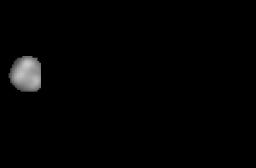

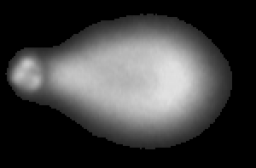

0.9496175599103134
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet14.png d=comet14.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


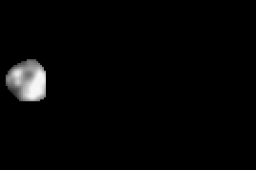

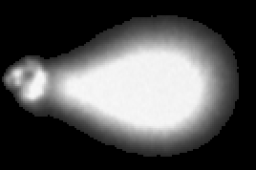

0.9359379006361339
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet222.png d=comet222.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


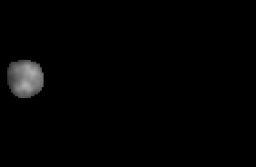

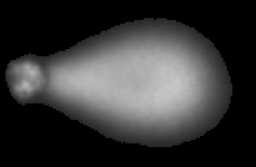

0.9424561805475999
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet297.png d=comet297.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


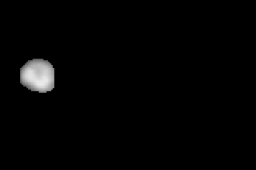

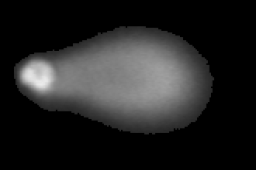

0.8901341761915198
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet153.png d=comet153.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


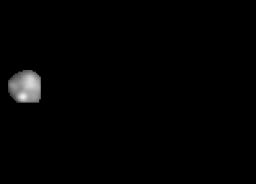

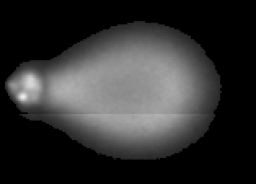

0.941125526088794
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet37.png d=comet37.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


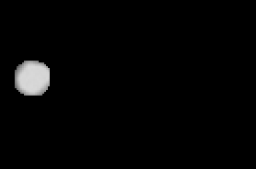

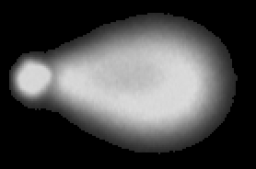

0.9353288484436676
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet119.png d=comet119.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


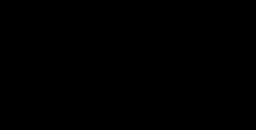

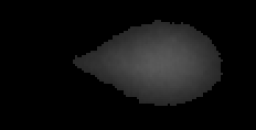

1.0
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet345.png d=comet345.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


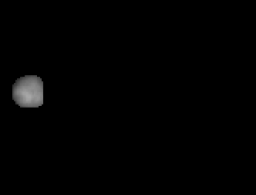

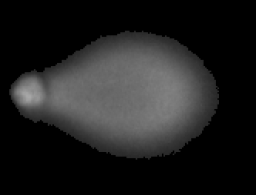

0.9362302599871677
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet257.png d=comet257.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


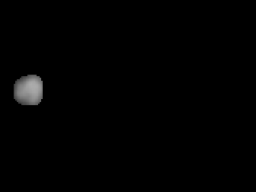

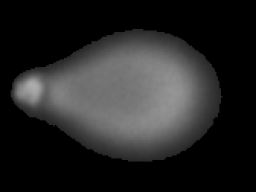

0.9482784562529779
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet41.png d=comet41.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


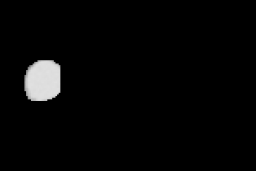

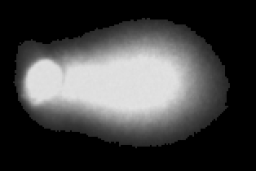

0.90450846890137
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet128.png d=comet128.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


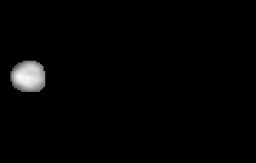

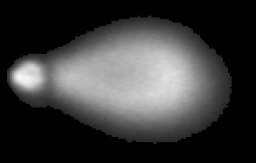

0.9325312643712264
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet254.png d=comet254.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


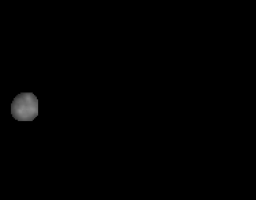

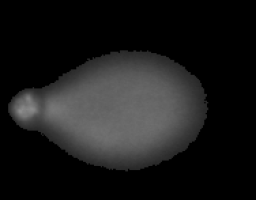

0.950203049341267
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet130.png d=comet130.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


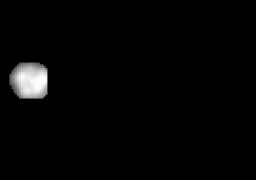

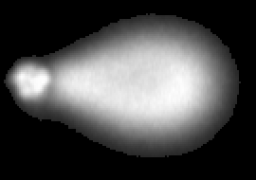

0.9331574374029831
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet183.png d=comet183.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


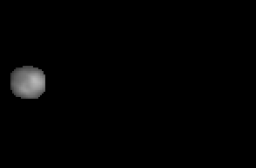

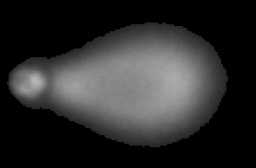

0.9387959988608177
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet121.png d=comet121.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


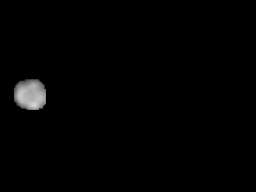

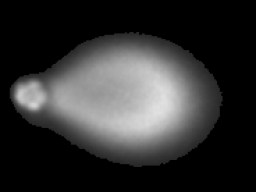

0.9458555497821656
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet259.png d=comet259.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


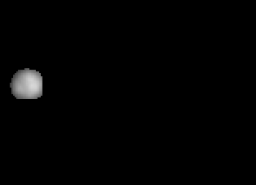

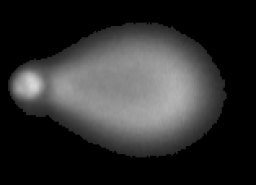

0.9441740985339422
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet303.png d=comet303.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


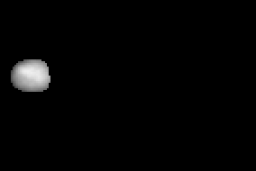

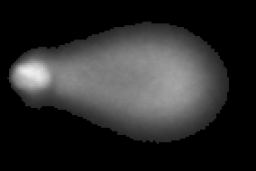

0.9025800213378744
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet301.png d=comet301.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


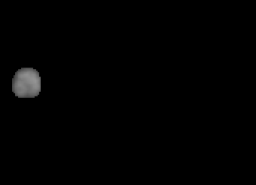

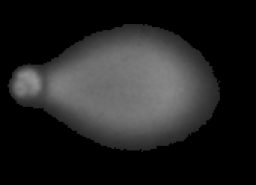

0.949166602467451
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet229.png d=comet229.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


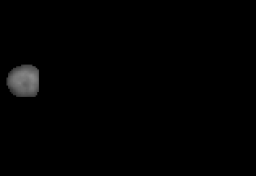

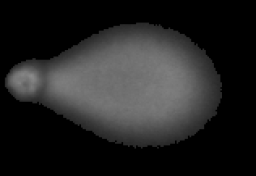

0.9446384408712585
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet166.png d=comet166.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


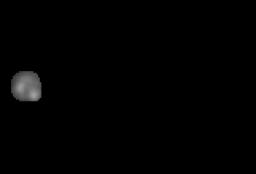

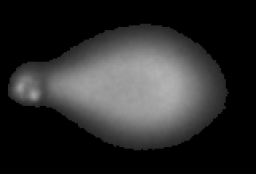

0.957723108280782
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet141.png d=comet141.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


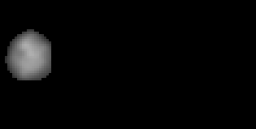

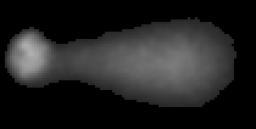

0.8034225467208606
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet185.png d=comet185.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


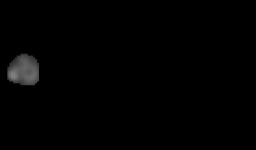

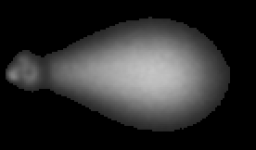

0.9593654810063339
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet191.png d=comet191.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


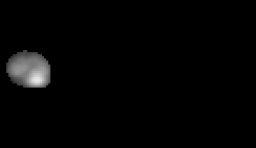

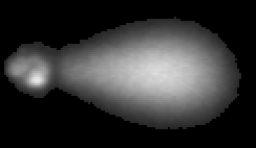

0.9146949196510247
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet184.png d=comet184.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


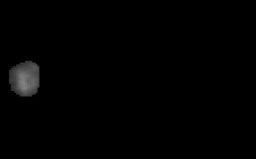

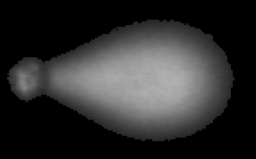

0.9600449530737951
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet211.png d=comet211.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


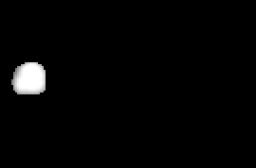

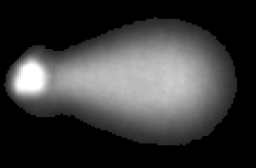

0.9143834539837501
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet328.png d=comet328.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


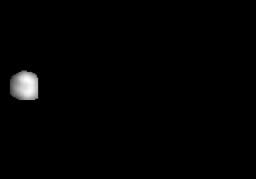

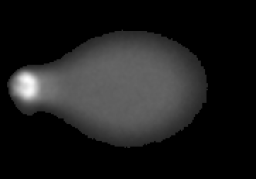

0.9044216174618931
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet165.png d=comet165.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


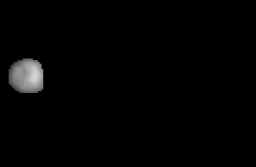

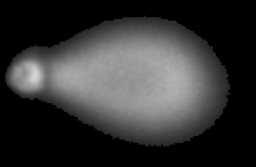

0.9349825362708222
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet152.png d=comet152.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


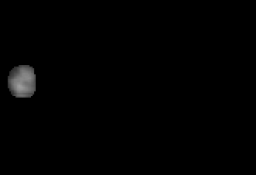

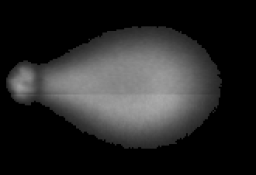

0.9550411421309182
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet190.png d=comet190.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


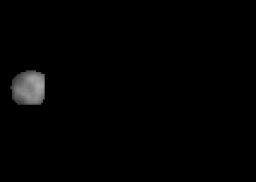

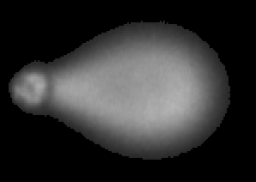

0.9469700617504864
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet82.png d=comet82.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


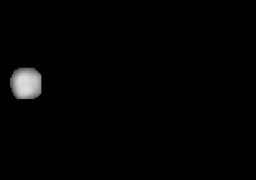

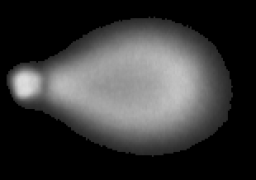

0.9451561746426548
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet27.png d=comet27.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


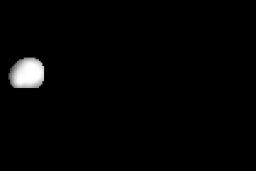

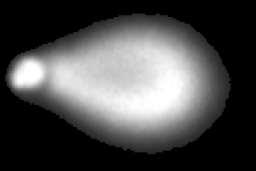

0.9411907255231832
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet107.png d=comet107.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet266.png d=comet266.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


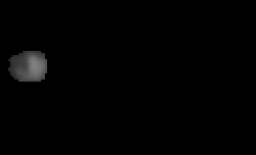

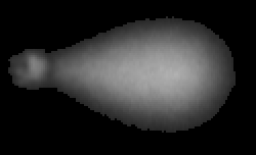

0.9510394025525275
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet273.png d=comet273.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


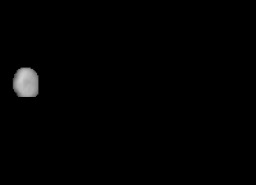

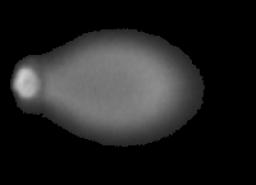

0.9339675272998761
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet97.png d=comet97.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


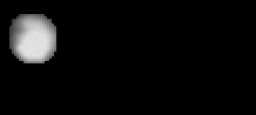

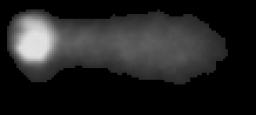

0.6702371390220104
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet339.png d=comet339.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


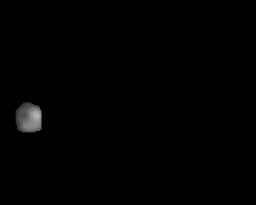

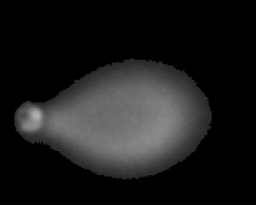

0.9500741998534429
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet22.png d=comet22.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


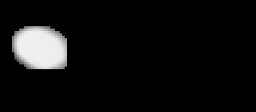

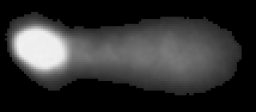

0.6850357389900853
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet81.png d=comet81.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


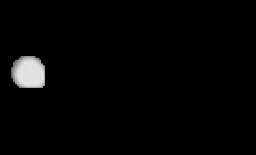

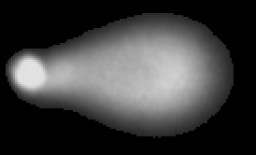

0.9224927163949409
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet243.png d=comet243.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


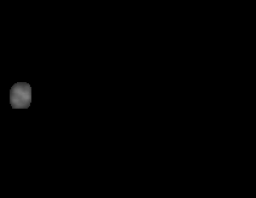

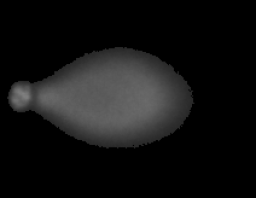

0.9515520512581257
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet278.png d=comet278.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


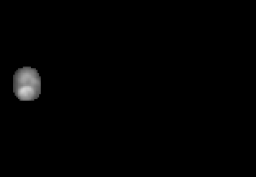

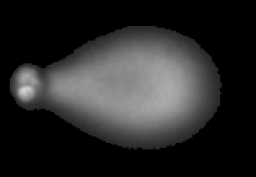

0.9445918066607721
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet144.png d=comet144.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


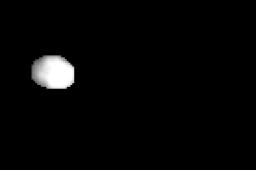

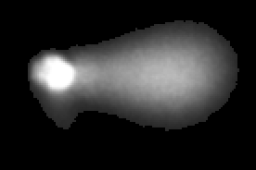

0.8577921550017678
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet262.png d=comet262.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


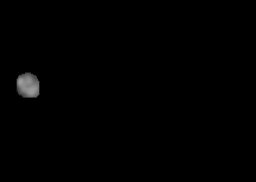

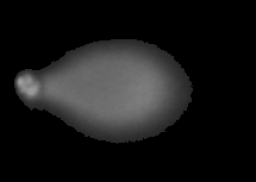

0.9470788570595373
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet186.png d=comet186.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


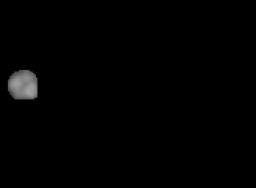

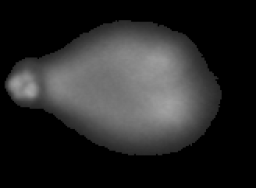

0.9515228530845522
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet218.png d=comet218.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


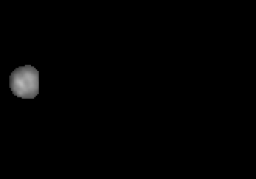

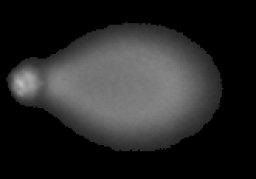

0.9434116974621133
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet67.png d=comet67.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


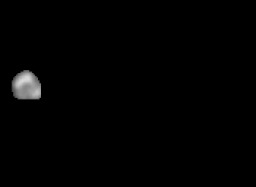

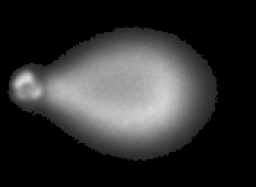

0.9542978648762629
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet225.png d=comet225.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


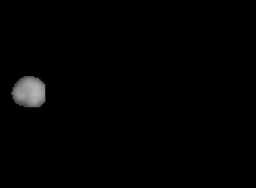

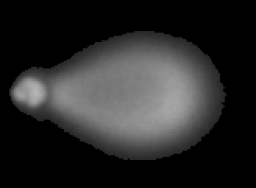

0.9394601529533222
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet74.png d=comet74.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


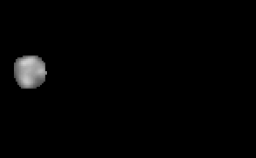

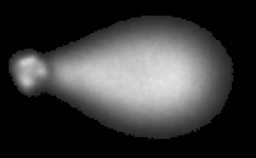

0.9435264427077891
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet89.png d=comet89.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


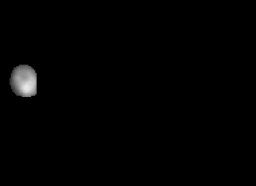

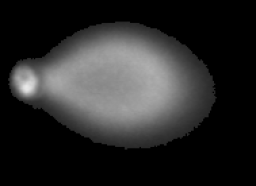

0.9467713127641574
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet93.png d=comet93.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


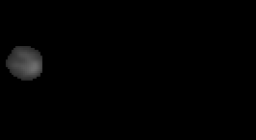

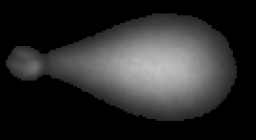

0.9556363268247652
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet15.png d=comet15.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


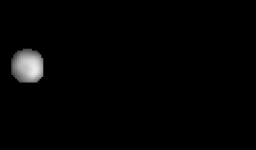

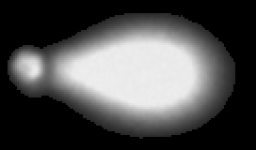

0.9515033132875786
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet26.png d=comet26.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


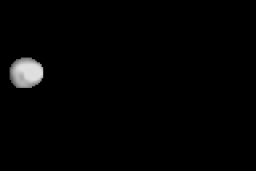

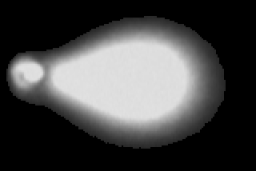

0.9495084410268627
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet28.png d=comet28.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


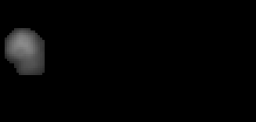

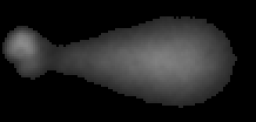

0.8686344827586207
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet87.png d=comet87.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


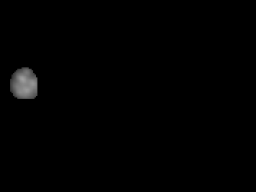

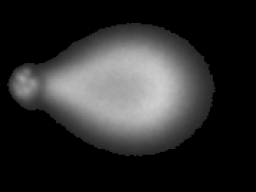

0.9634837825389279
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet73.png d=comet73.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


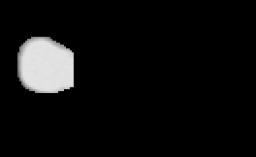

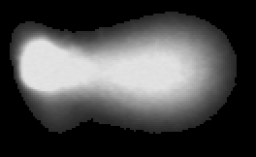

0.8048317304947805
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet267.png d=comet267.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


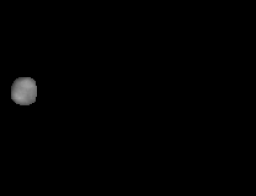

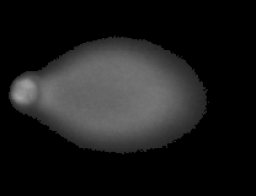

0.9453669091780742
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet136.png d=comet136.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


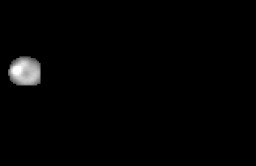

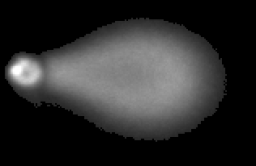

0.9261625369395817
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet88.png d=comet88.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


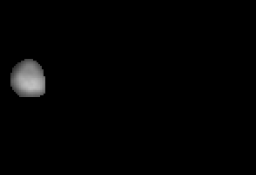

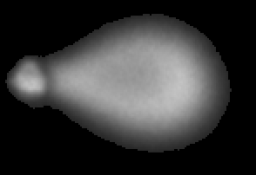

0.9413830996351671
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet210.png d=comet210.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


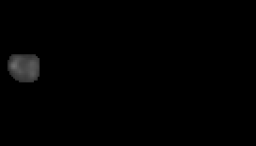

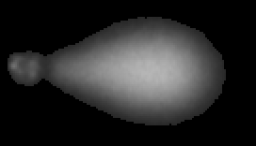

0.961996881967378
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet227.png d=comet227.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


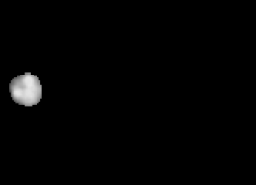

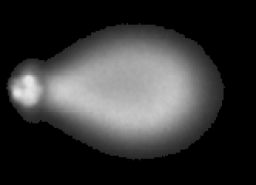

0.9395664633019042
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet312.png d=comet312.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


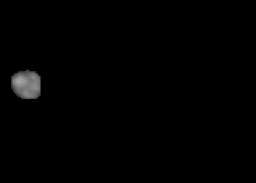

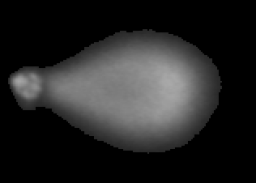

0.9519641188791119
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet1.png d=comet1.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet331.png d=comet331.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


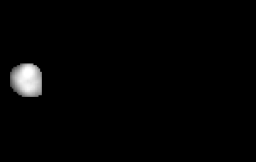

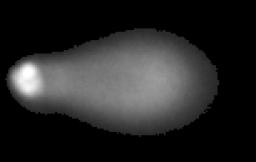

0.8902243308353057
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet216.png d=comet216.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


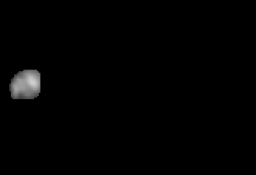

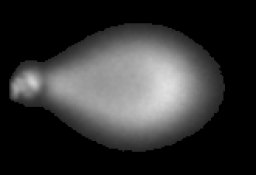

0.9543758015630947
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet2.png d=comet2.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


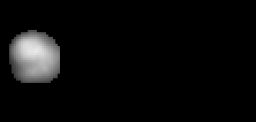

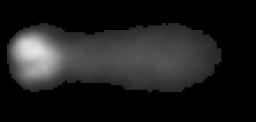

0.6432819029251045
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet247.png d=comet247.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


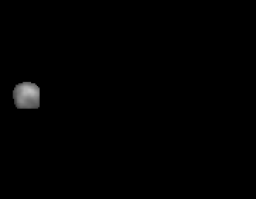

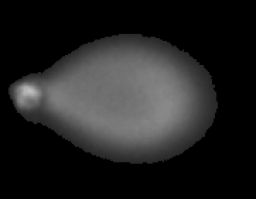

0.9545513945089296
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet64.png d=comet64.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


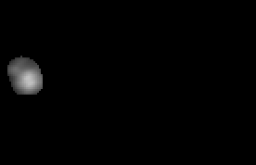

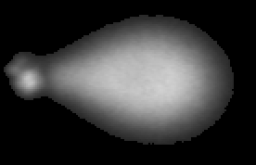

0.9492278226440467
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet290.png d=comet290.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


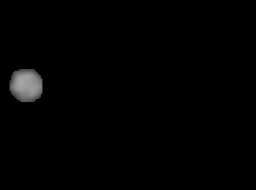

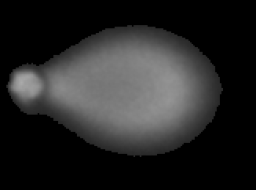

0.93909147111508
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet194.png d=comet194.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


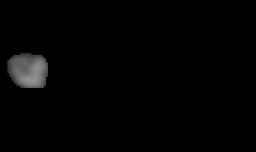

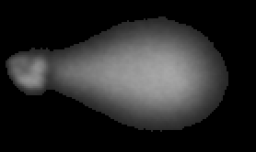

0.9221305316668742
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet324.png d=comet324.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


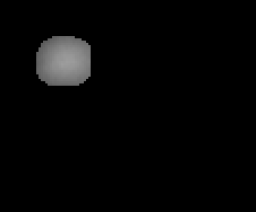

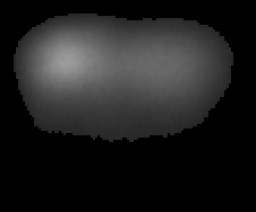

0.8242082638168673
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet135.png d=comet135.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


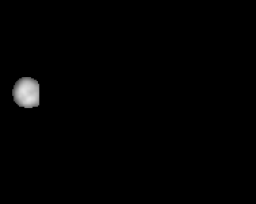

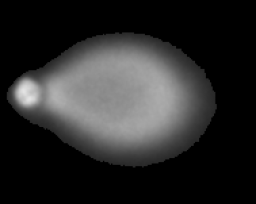

0.9462423242215315
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet221.png d=comet221.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


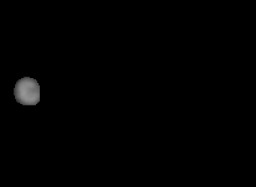

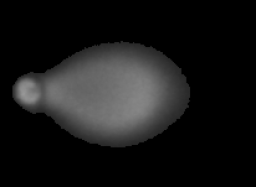

0.9378539458477454
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet142.png d=comet142.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


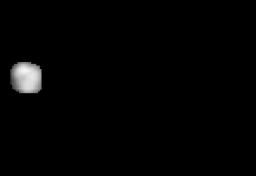

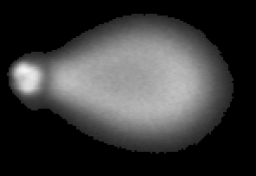

0.9423287199048551
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet289.png d=comet289.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


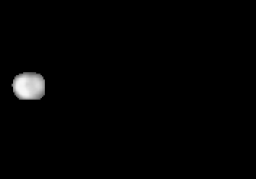

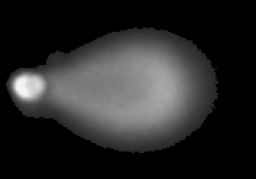

0.9208244075134733
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet299.png d=comet299.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


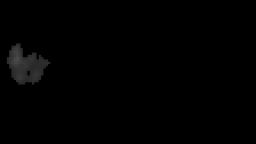

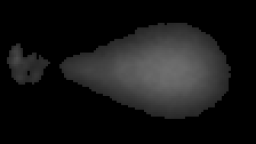

0.9372622344142232
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet91.png d=comet91.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


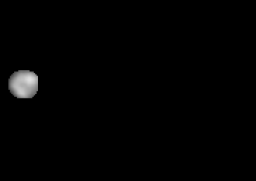

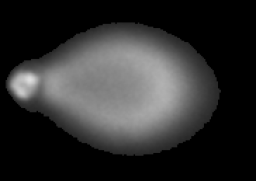

0.9479974870281164
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet287.png d=comet287.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


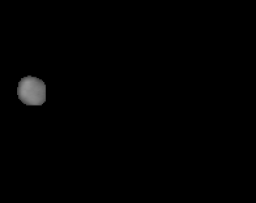

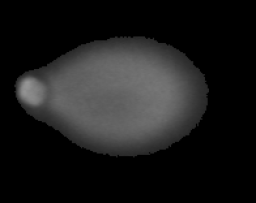

0.9418677437594364
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet149.png d=comet149.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


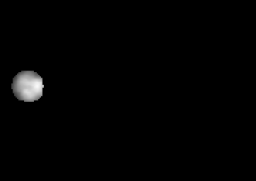

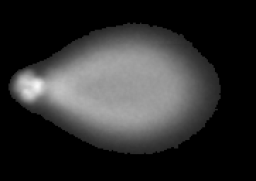

0.9405977098769882
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet77.png d=comet77.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet304.png d=comet304.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


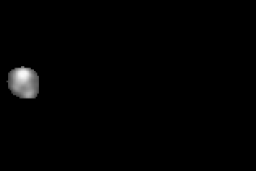

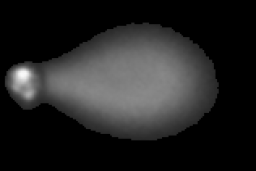

0.9240906321054257
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet148.png d=comet148.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


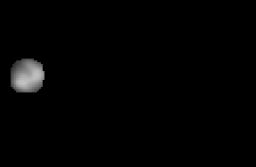

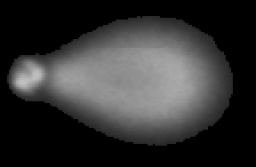

0.93908661574971
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet318.png d=comet318.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


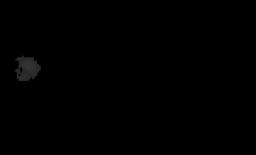

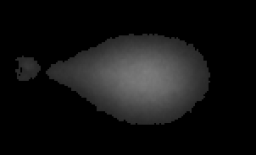

0.973725233351335
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet249.png d=comet249.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


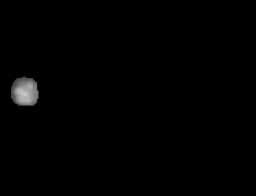

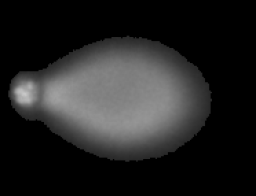

0.950205397934503
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet76.png d=comet76.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


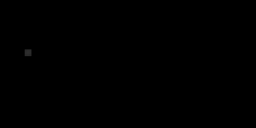

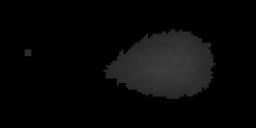

0.9926604806814725
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet134.png d=comet134.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


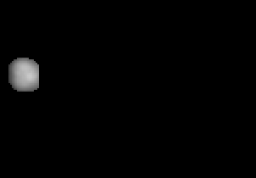

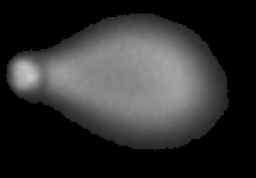

0.9413790290321902
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet55.png d=comet55.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


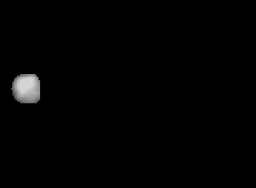

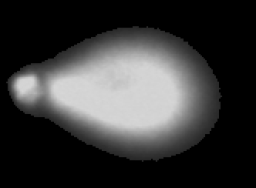

0.9553356142715487
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet270.png d=comet270.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


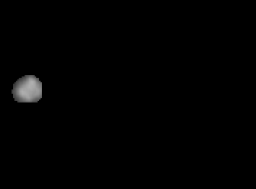

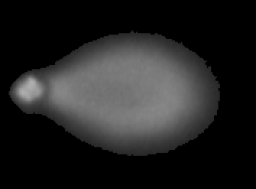

0.9474797298914351
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet226.png d=comet226.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


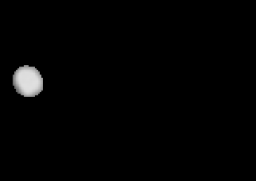

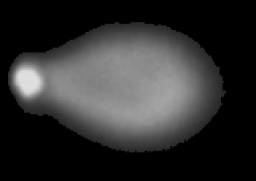

0.932162085046471
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet288.png d=comet288.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


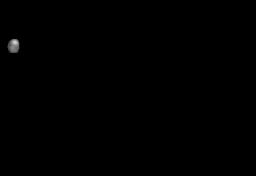

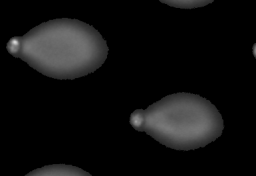

0.9777098340924074
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet71.png d=comet71.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


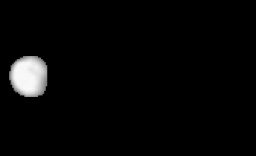

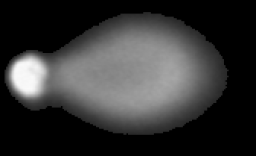

0.8691392350594972
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet122.png d=comet122.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


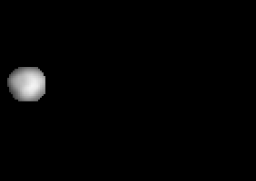

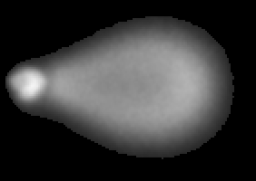

0.9291894272230679
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet145.png d=comet145.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


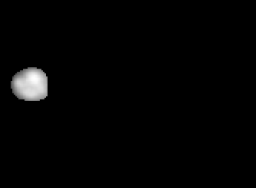

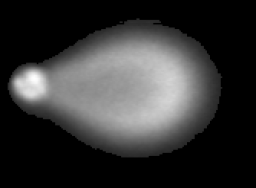

0.9250587034391989
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet275.png d=comet275.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


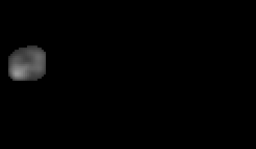

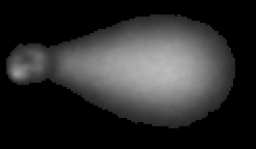

0.9421445108018149
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet120.png d=comet120.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


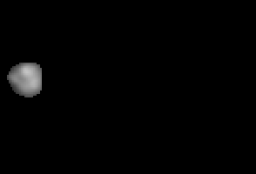

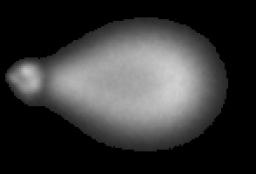

0.9484402773999531
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet285.png d=comet285.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


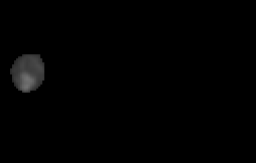

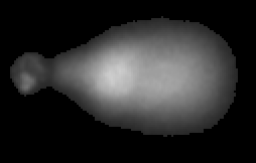

0.9597814556694916
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet319.png d=comet319.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


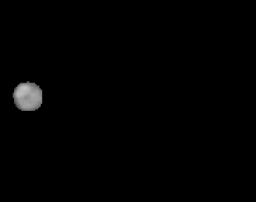

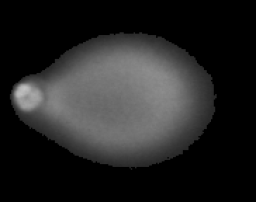

0.9459778190131446
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet109.png d=comet109.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


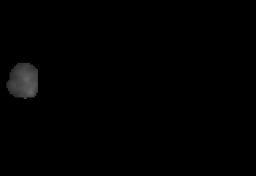

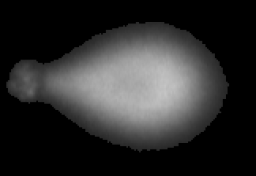

0.9681255567887164
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet172.png d=comet172.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


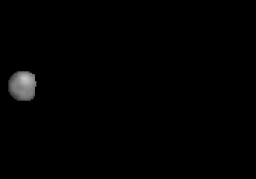

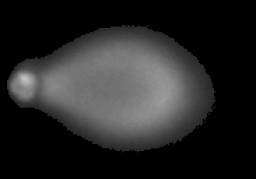

0.9503074343840403
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet236.png d=comet236.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


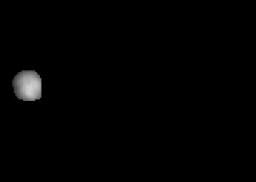

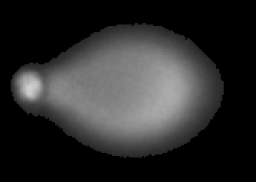

0.947965414857962
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet50.png d=comet50.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


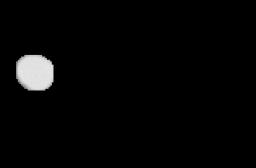

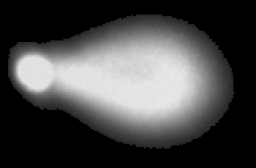

0.9191426554032787
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet114.png d=comet114.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


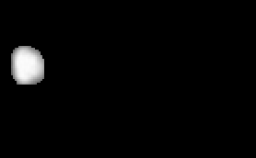

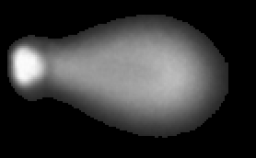

0.8975168528423818
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet342.png d=comet342.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


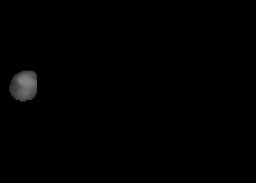

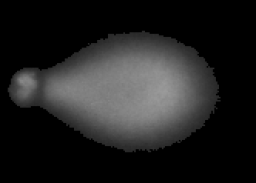

0.9602348853264951
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet147.png d=comet147.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


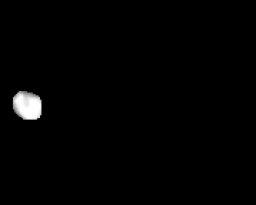

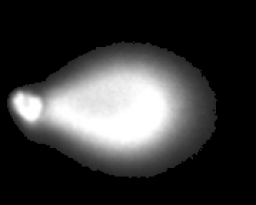

0.9480590719913224
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet96.png d=comet96.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


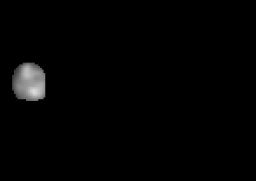

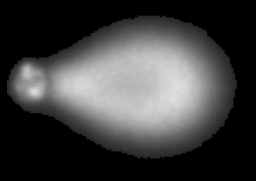

0.9478988073245962
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet171.png d=comet171.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


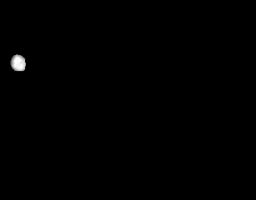

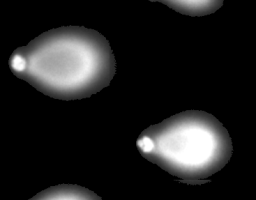

0.9744804085319422
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet146.png d=comet146.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


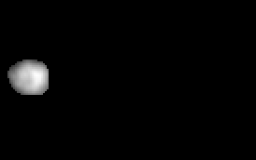

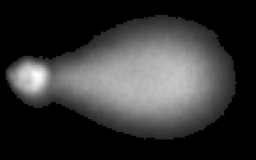

0.9099125419982598
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet29.png d=comet29.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


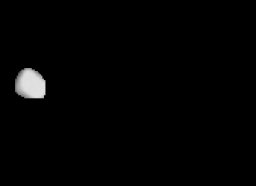

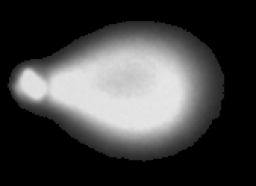

0.9515363477391956
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet195.png d=comet195.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


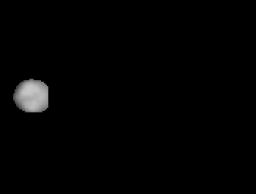

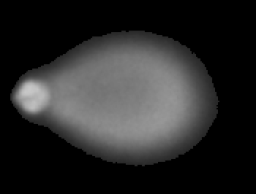

0.9256909342856727
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet217.png d=comet217.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


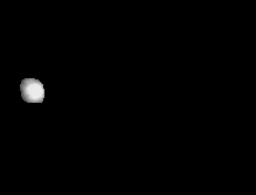

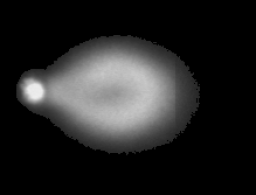

0.9485574904986103
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet212.png d=comet212.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


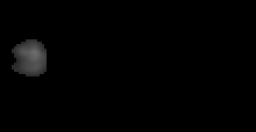

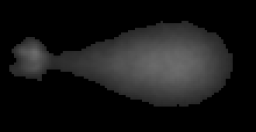

0.9066924021758204
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet271.png d=comet271.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


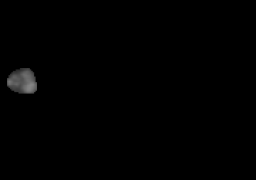

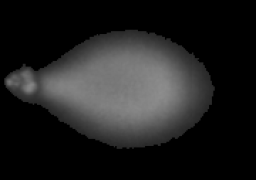

0.9632701454131682
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet6.png d=comet6.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet30.png d=comet30.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


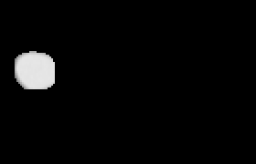

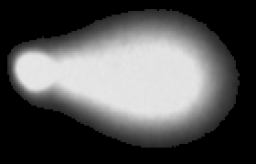

0.9174436094448037
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet105.png d=comet105.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


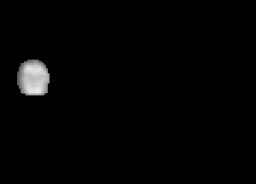

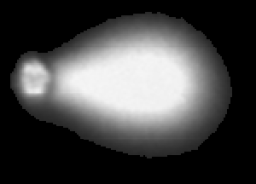

0.9469815779389432
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet296.png d=comet296.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


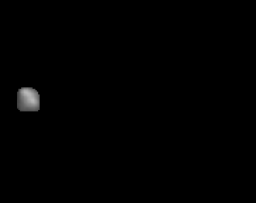

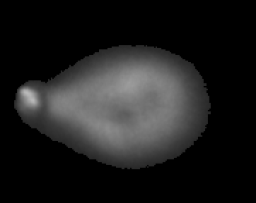

0.9611829473217177
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet333.png d=comet333.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


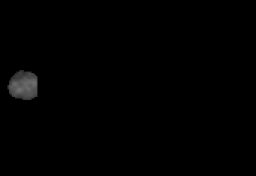

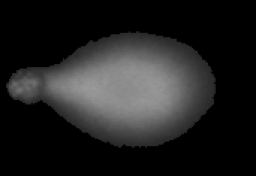

0.961617922638704
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet123.png d=comet123.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


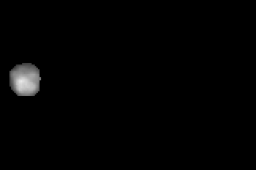

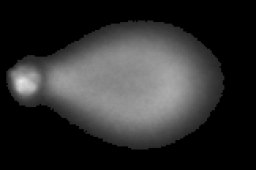

0.9404297187273242
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet106.png d=comet106.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


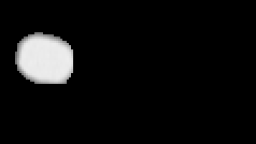

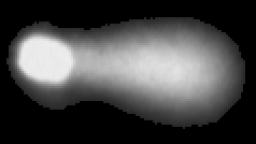

0.793917693492837
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet66.png d=comet66.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


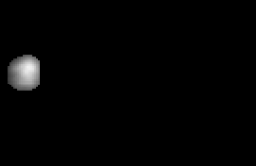

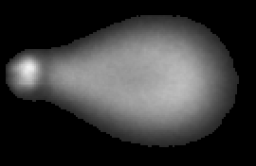

0.9408312102006173
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet315.png d=comet315.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


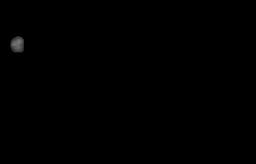

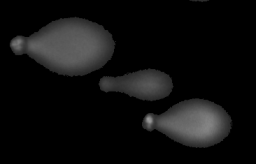

0.9769495215634251
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet298.png d=comet298.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


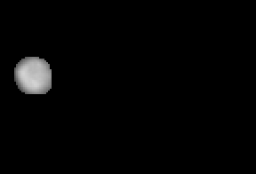

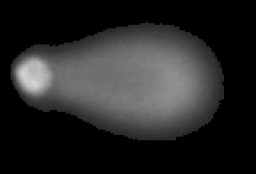

0.8888905009938627
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet69.png d=comet69.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


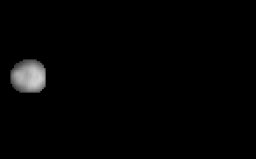

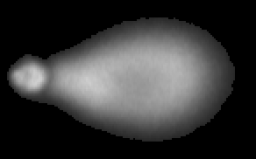

0.9337902148502727
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet16.png d=comet16.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


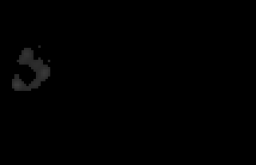

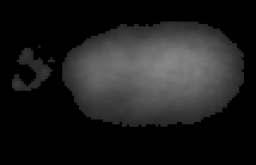

0.9716793106422776
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet255.png d=comet255.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


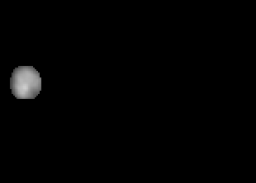

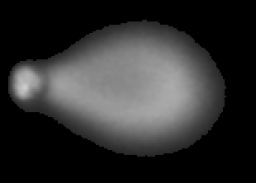

0.9442707099325557
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet79.png d=comet79.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


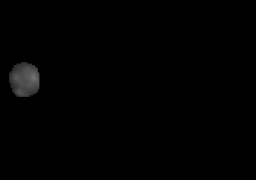

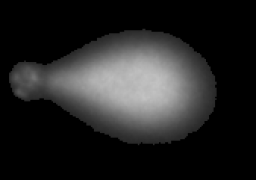

0.9624183253623377
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet231.png d=comet231.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


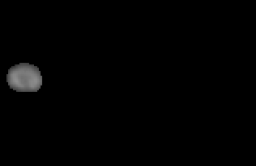

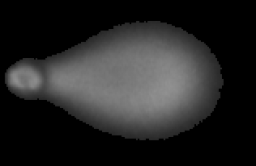

0.9425471839289327
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet150.png d=comet150.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


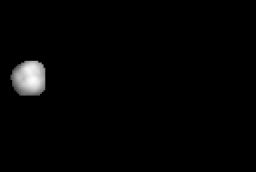

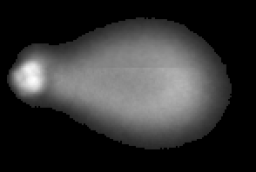

0.9193611557199872
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet13.png d=comet13.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


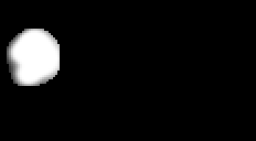

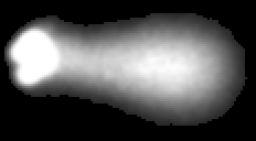

0.8061587286833028
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet326.png d=comet326.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


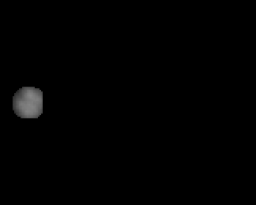

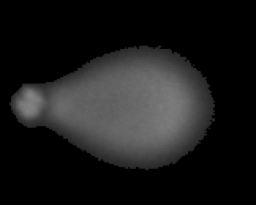

0.941478826580958
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet240.png d=comet240.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


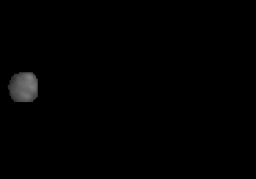

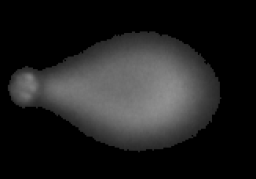

0.9542150850099788
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet127.png d=comet127.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


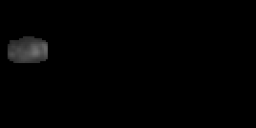

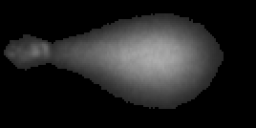

0.9417257588504734
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet7.png d=comet7.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


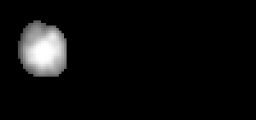

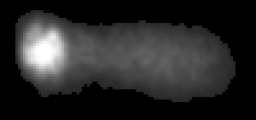

0.6810947827761021
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet313.png d=comet313.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet233.png d=comet233.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


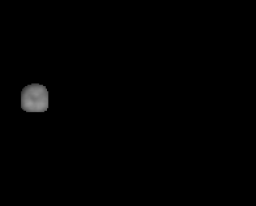

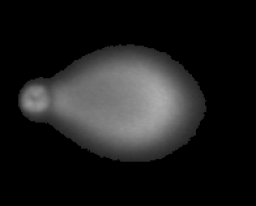

0.9468611766605952
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet103.png d=comet103.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


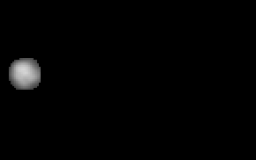

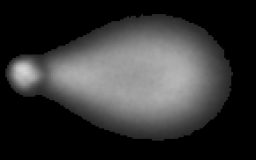

0.9448431569934278
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet246.png d=comet246.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


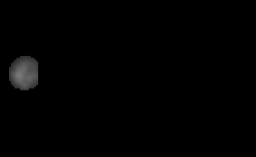

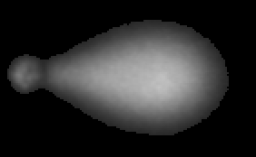

0.9608792099070252
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet245.png d=comet245.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


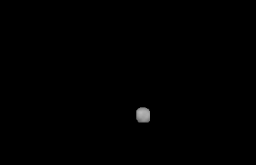

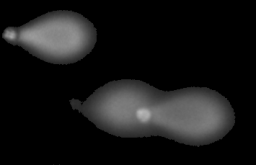

0.9705217741366144
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet94.png d=comet94.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


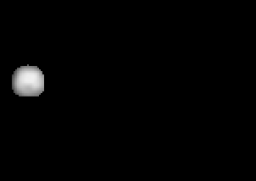

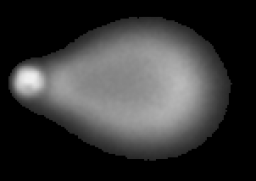

0.9401730545483299
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet334.png d=comet334.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


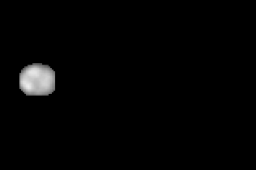

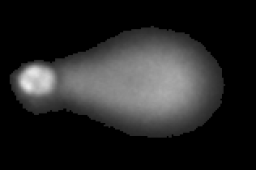

0.8924267755521975
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet9.png d=comet9.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


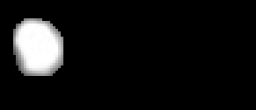

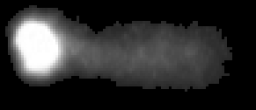

0.5772721601050296
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet325.png d=comet325.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


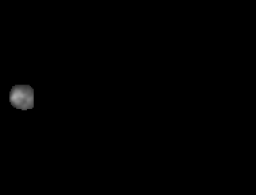

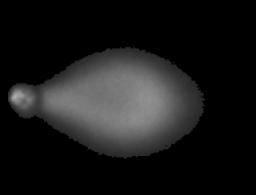

0.9574368763582409
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet163.png d=comet163.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


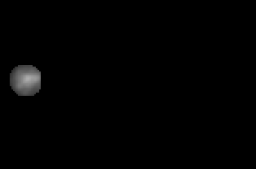

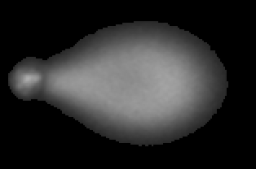

0.9561486347772531
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet48.png d=comet48.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


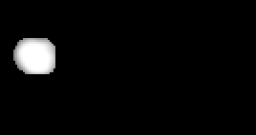

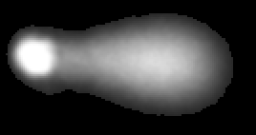

0.854704458526809
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet340.png d=comet340.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


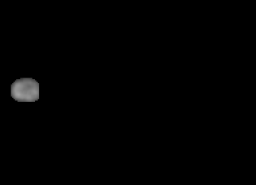

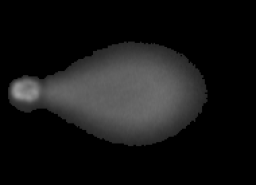

0.932769896783659
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet187.png d=comet187.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


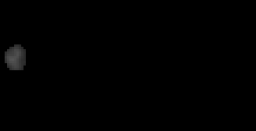

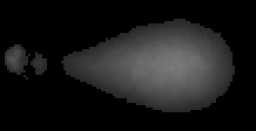

0.9679155914154117
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet85.png d=comet85.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


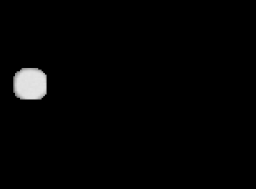

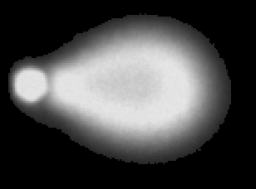

0.9437954896123935
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet36.png d=comet36.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


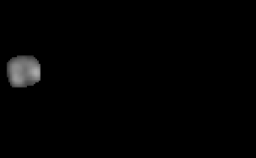

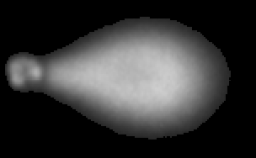

0.9517465221269045
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet11.png d=comet11.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


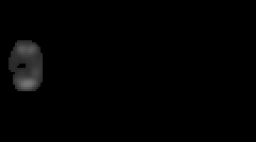

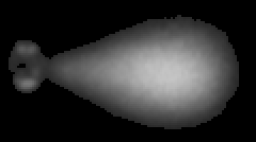

0.9484192425904112
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet261.png d=comet261.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


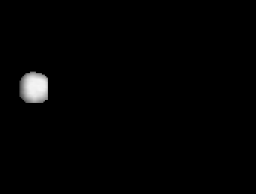

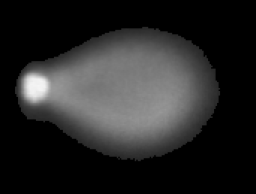

0.9238417562314201
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet235.png d=comet235.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


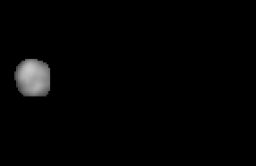

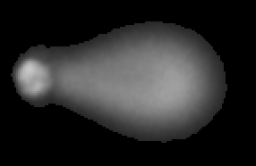

0.9076588394770213
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet232.png d=comet232.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


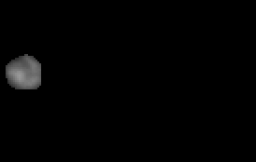

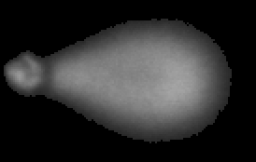

0.9438558824137665
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet170.png d=comet170.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


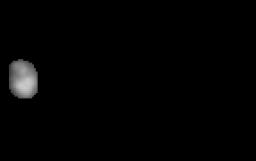

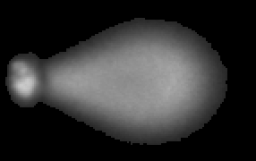

0.9353946068963065
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet175.png d=comet175.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


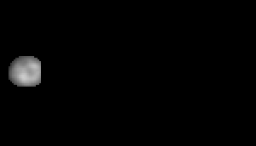

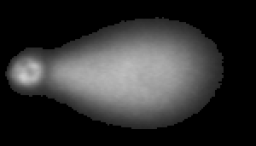

0.9339984810328976
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet182.png d=comet182.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


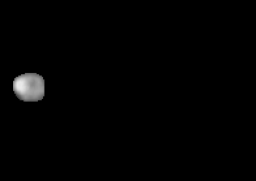

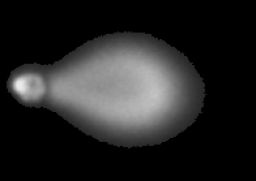

0.9301014916501329
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet111.png d=comet111.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


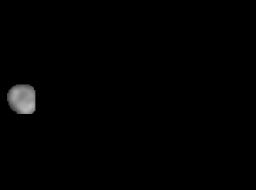

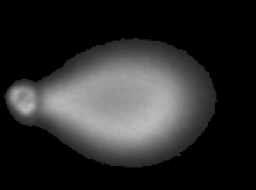

0.9539829588069475
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet224.png d=comet224.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


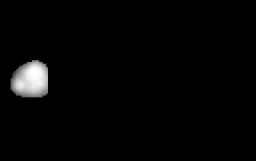

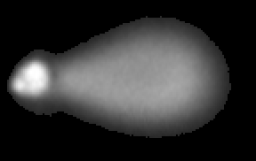

0.8935613293569912
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet256.png d=comet256.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


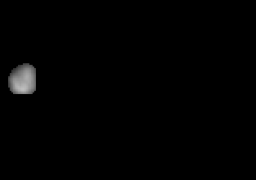

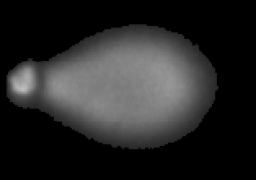

0.9477642114458916
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet188.png d=comet188.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


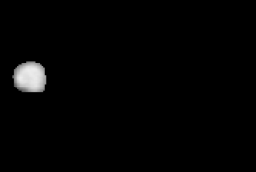

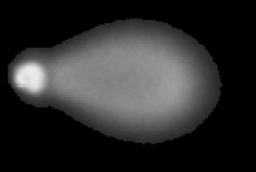

0.9156057134912623
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet118.png d=comet118.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


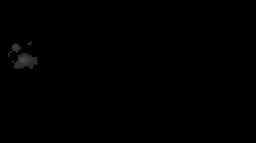

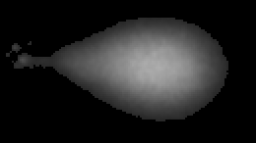

0.9855829196894489
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet110.png d=comet110.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


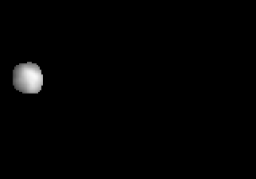

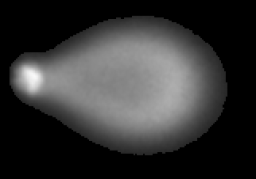

0.9426005567019587
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet98.png d=comet98.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


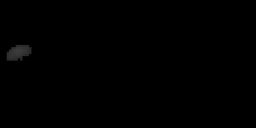

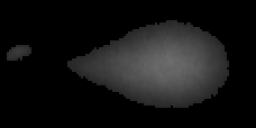

0.9776237221371182
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet198.png d=comet198.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


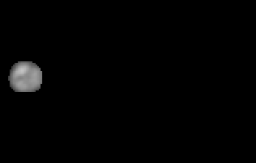

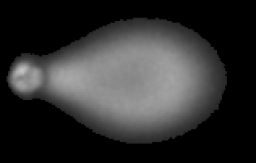

0.9420778448734395
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet321.png d=comet321.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


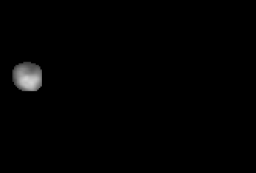

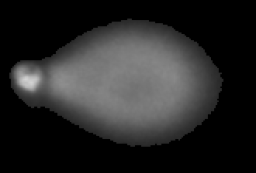

0.9438908283084735
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet52.png d=comet52.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


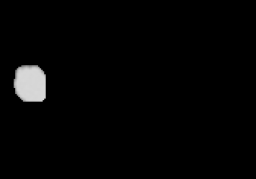

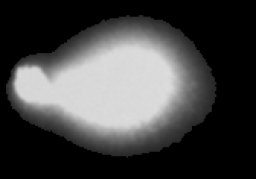

0.9309586747764361
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet314.png d=comet314.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


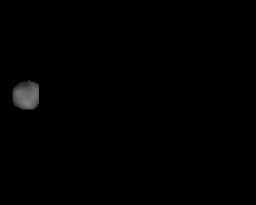

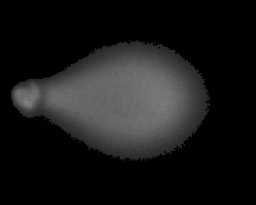

0.9533158378957212
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet139.png d=comet139.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


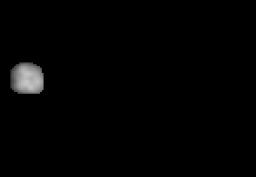

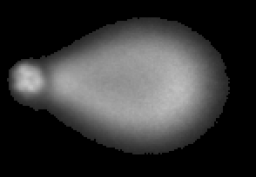

0.9450332297400214
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet65.png d=comet65.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


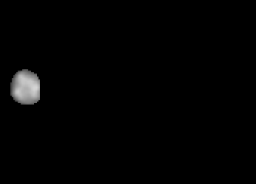

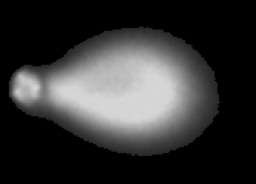

0.9454203868223409
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet311.png d=comet311.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


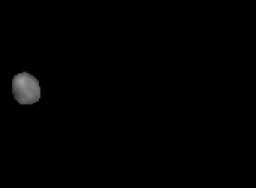

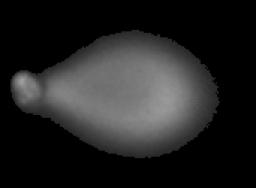

0.952501041878159
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet214.png d=comet214.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


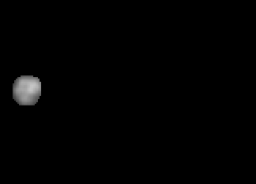

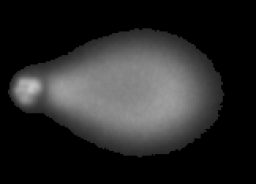

0.9480427129537666
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet99.png d=comet99.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


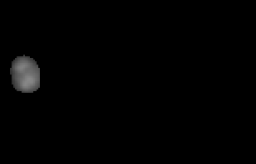

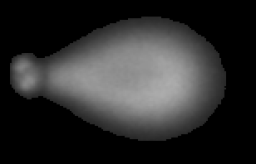

0.9534629647601318
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet151.png d=comet151.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


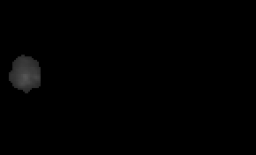

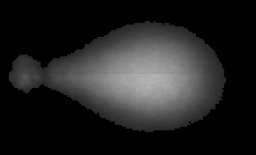

0.9624552057446487
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet59.png d=comet59.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


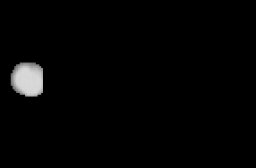

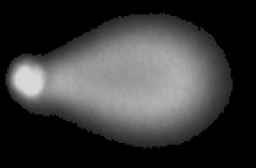

0.9279235691881907
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet201.png d=comet201.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


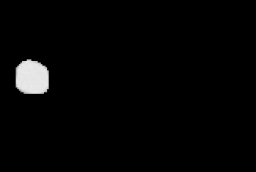

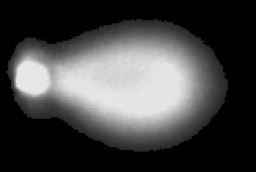

0.9275126259244741
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet209.png d=comet209.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


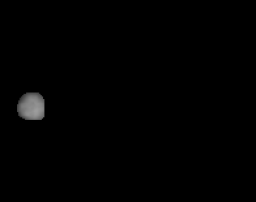

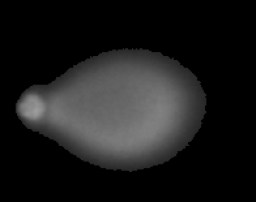

0.9460332478007617
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet46.png d=comet46.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


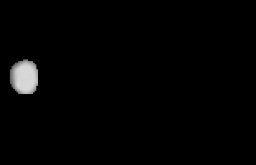

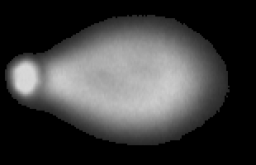

0.9419831862565924
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet45.png d=comet45.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


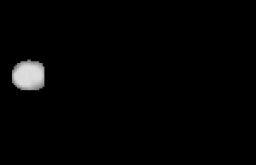

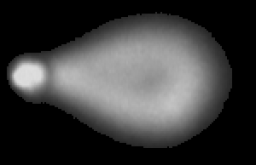

0.9357518242960631
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet293.png d=comet293.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


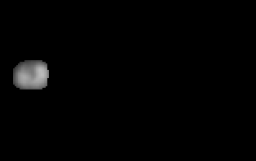

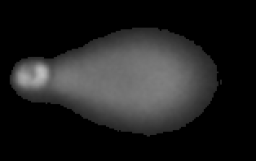

0.9123299340036461
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet100.png d=comet100.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


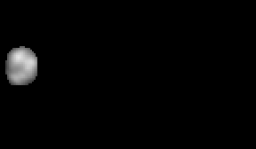

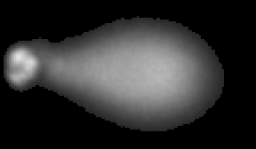

0.9139294224046473
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet63.png d=comet63.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


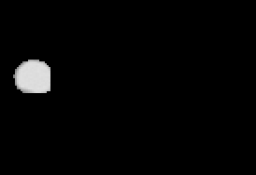

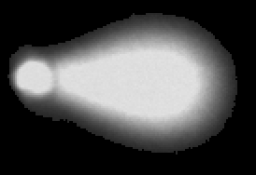

0.933806242189485
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet310.png d=comet310.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


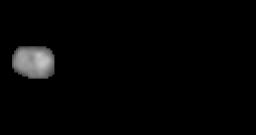

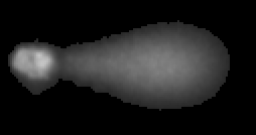

0.84464655484308
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet282.png d=comet282.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


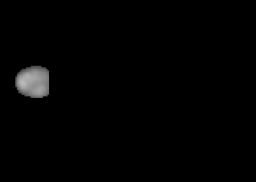

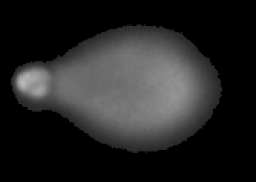

0.926663257471857
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet154.png d=comet154.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


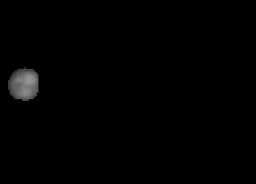

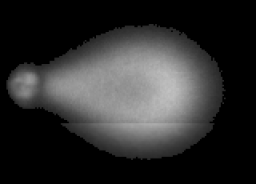

0.9607080422707532
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet115.png d=comet115.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


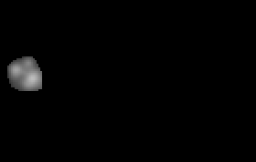

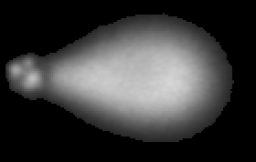

0.9518147274176015
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet302.png d=comet302.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


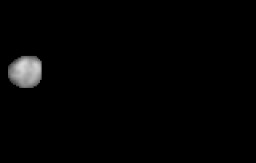

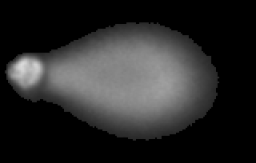

0.9184605611025067
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet138.png d=comet138.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet306.png d=comet306.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


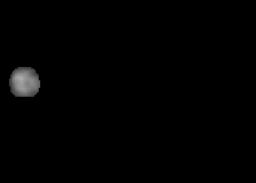

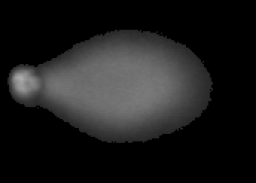

0.934085599492212
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet344.png d=comet344.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


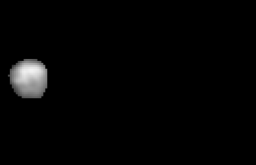

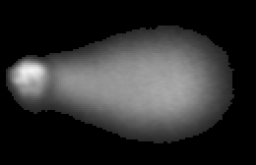

0.9025678811061641
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet68.png d=comet68.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


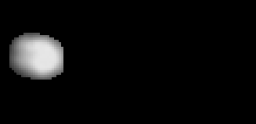

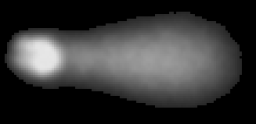

0.7890202868249976
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet61.png d=comet61.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


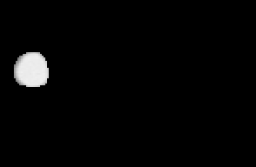

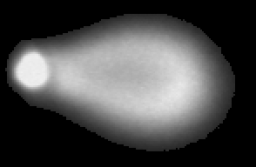

0.9272708217428439
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet78.png d=comet78.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


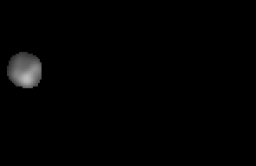

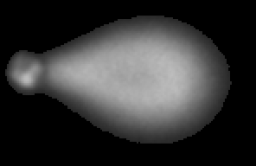

0.9508018909755714
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet75.png d=comet75.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


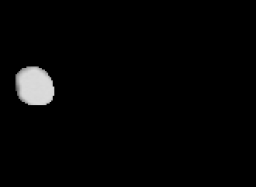

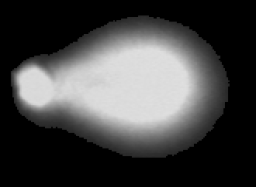

0.9208057004993547
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet252.png d=comet252.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


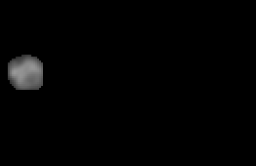

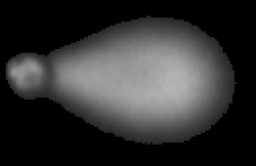

0.9450507329702834
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet35.png d=comet35.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


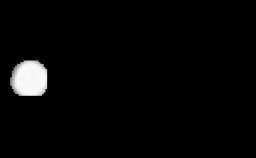

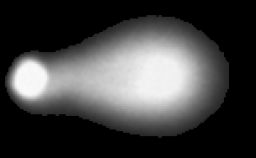

0.903209845149738
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet169.png d=comet169.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


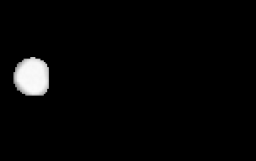

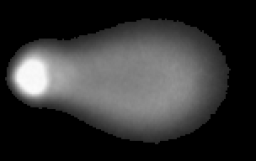

0.878397820841512
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet196.png d=comet196.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


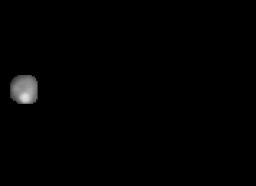

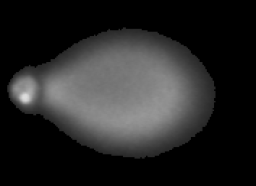

0.9495836292775319
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet263.png d=comet263.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


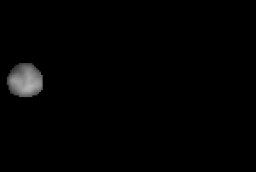

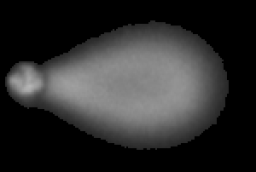

0.9389844721182208
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet161.png d=comet161.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


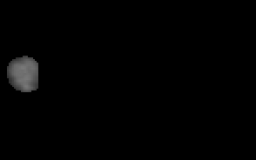

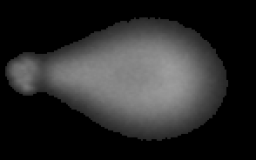

0.9496125461578886
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet268.png d=comet268.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


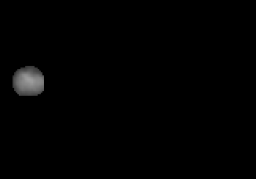

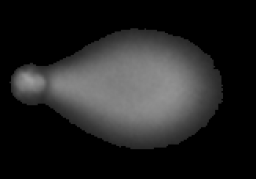

0.9486076364431274
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet189.png d=comet189.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


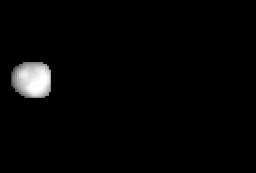

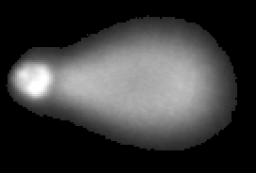

0.9075083358999424
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet3.png d=comet3.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet177.png d=comet177.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


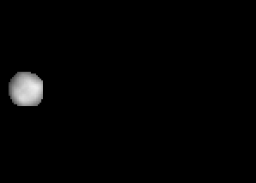

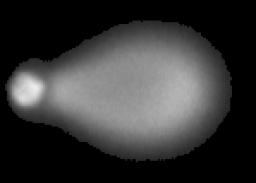

0.9311413740201332
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet277.png d=comet277.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


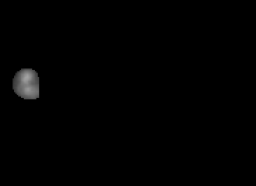

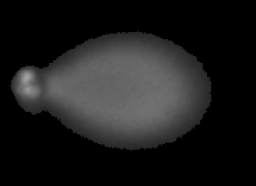

0.9465538712335062
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet162.png d=comet162.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


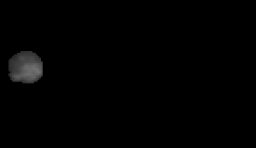

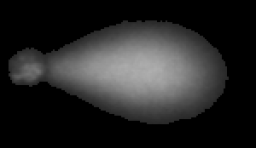

0.9520952235617275
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet31.png d=comet31.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


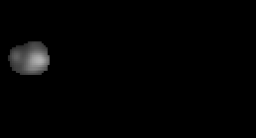

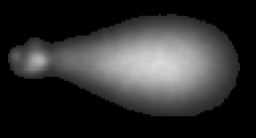

0.9378801643555134
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet337.png d=comet337.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


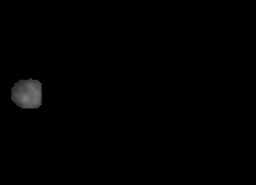

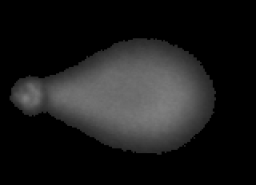

0.9505418439828044
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet327.png d=comet327.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


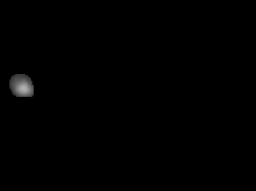

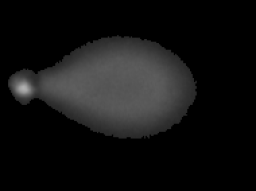

0.9484893432110263
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet83.png d=comet83.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


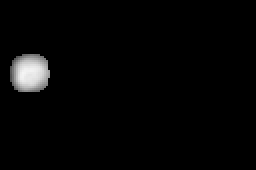

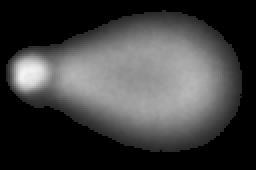

0.9157276467092471
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet90.png d=comet90.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


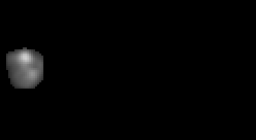

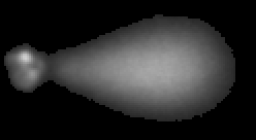

0.9133598114018279
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet56.png d=comet56.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


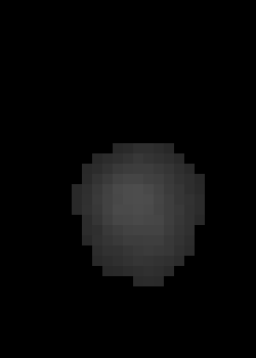

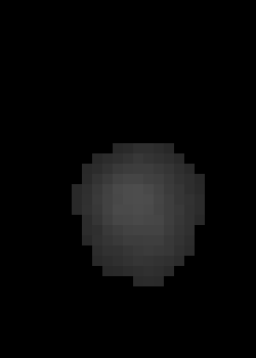

0.0
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet101.png d=comet101.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


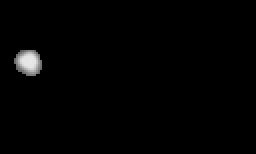

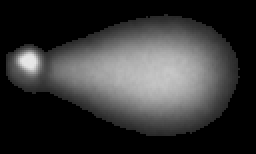

0.9529264566979809
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet24.png d=comet24.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


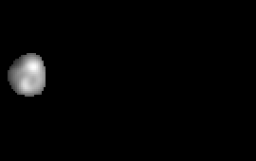

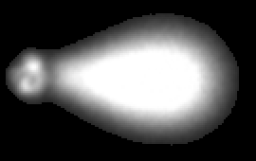

0.940009861333148
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet237.png d=comet237.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


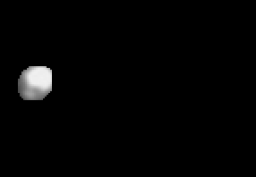

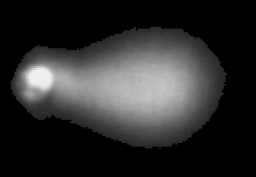

0.911281406318804
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet192.png d=comet192.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


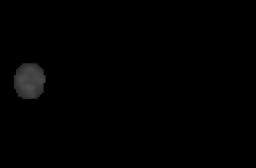

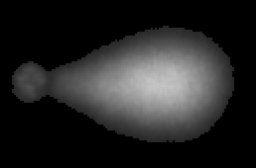

0.9640001175986359
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet173.png d=comet173.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


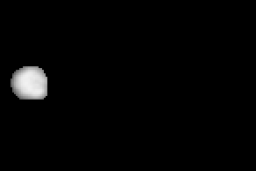

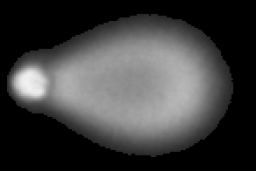

0.9253342929143664
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet54.png d=comet54.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


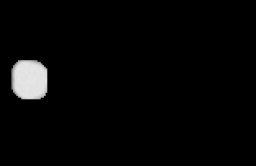

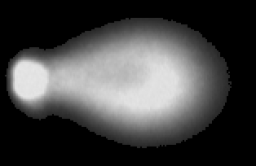

0.9040334951981756
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet95.png d=comet95.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


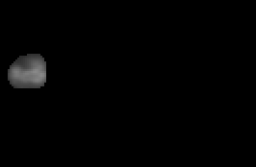

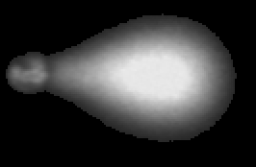

0.9567687132496827
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet140.png d=comet140.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


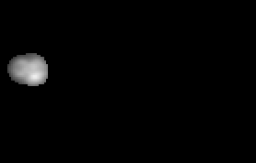

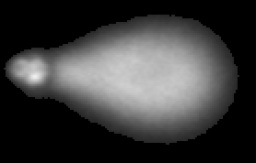

0.937067342276359
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet156.png d=comet156.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


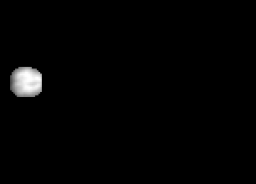

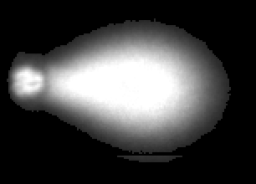

0.9479470495849226
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet179.png d=comet179.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


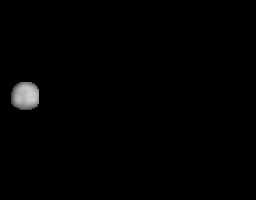

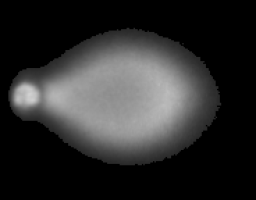

0.953854198923259
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet32.png d=comet32.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


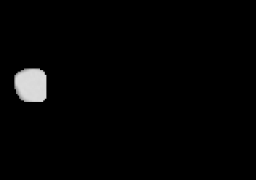

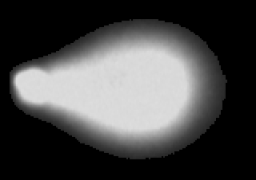

0.9389273995523588
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet341.png d=comet341.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


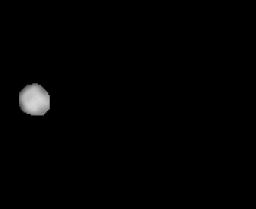

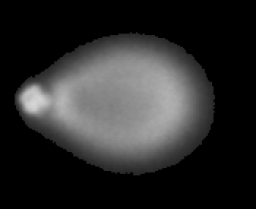

0.9414725104653222
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet12.png d=comet12.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


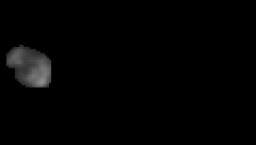

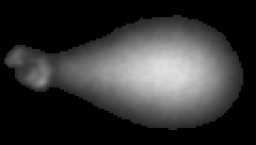

0.9413482922295615
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet253.png d=comet253.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


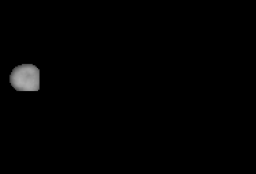

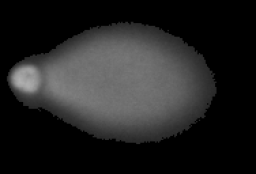

0.9369964074244188
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet280.png d=comet280.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


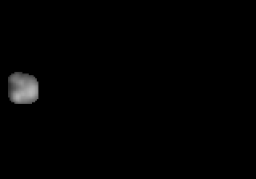

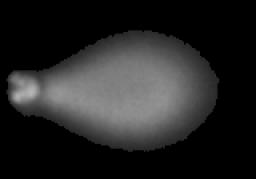

0.9384596634750881
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet330.png d=comet330.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


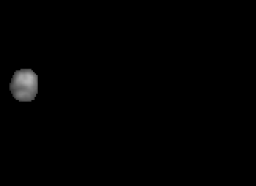

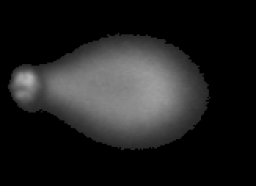

0.9421741806506724
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet295.png d=comet295.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


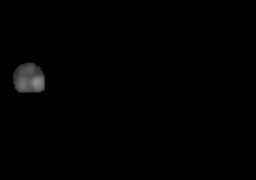

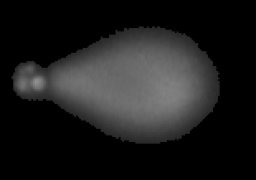

0.9499881889122396
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet305.png d=comet305.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


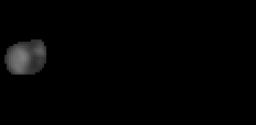

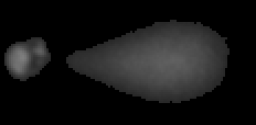

0.8619109195402299
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet244.png d=comet244.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


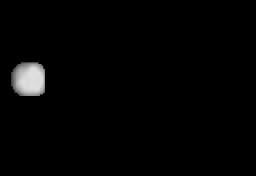

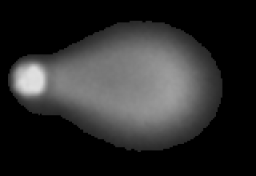

0.9078702680628732
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet286.png d=comet286.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


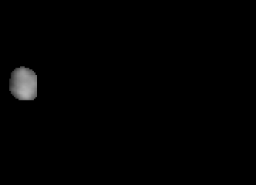

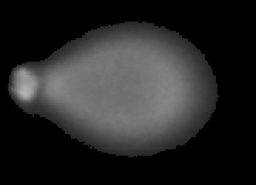

0.9455701828757586
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet208.png d=comet208.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


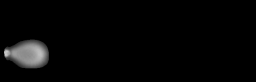

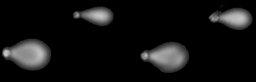

0.6696451466409599
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet8.png d=comet8.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


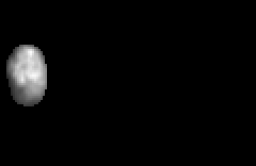

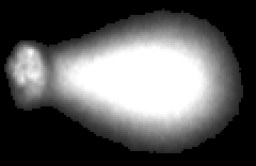

0.9214141394955708
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet167.png d=comet167.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


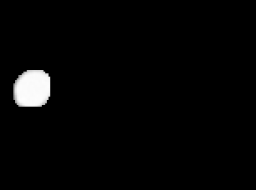

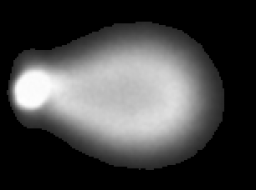

0.914196114039734
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet238.png d=comet238.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


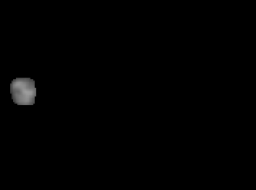

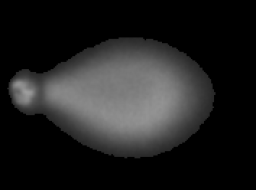

0.9564603402282994
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet260.png d=comet260.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


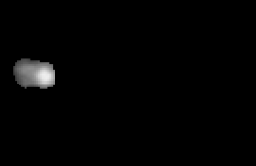

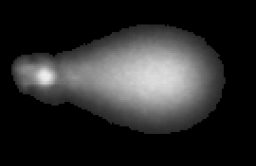

0.9238526293473283
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet70.png d=comet70.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


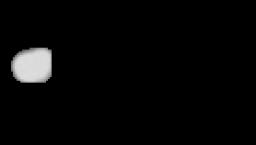

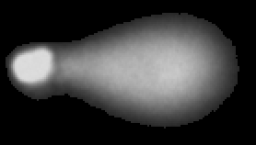

0.8838993736562244
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet53.png d=comet53.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


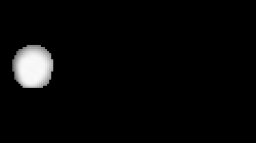

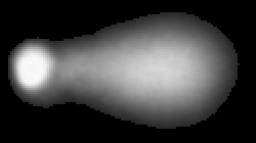

0.8694226170140075
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet250.png d=comet250.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


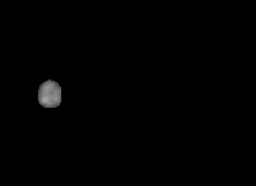

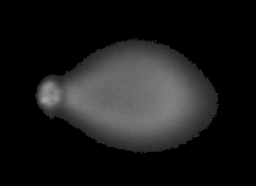

0.9487559309155452
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet276.png d=comet276.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


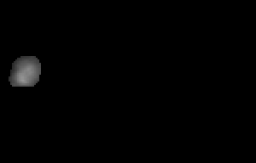

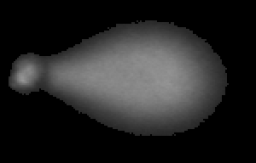

0.9504640973108486
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet155.png d=comet155.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


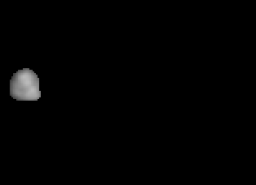

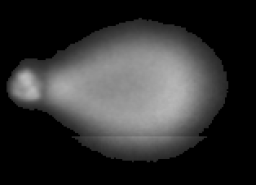

0.9521838549434782
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet10.png d=comet10.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


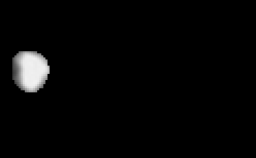

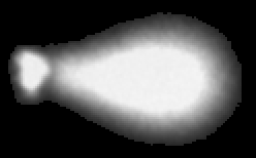

0.9287249048266657
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet281.png d=comet281.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


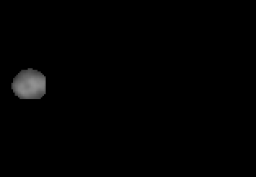

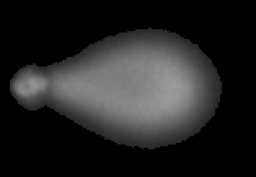

0.944299126193863
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet143.png d=comet143.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


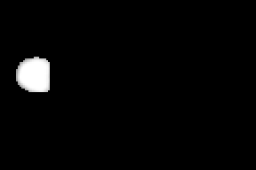

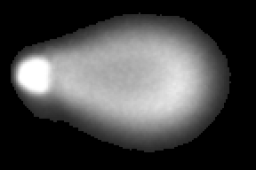

0.9197308181171254
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet19.png d=comet19.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


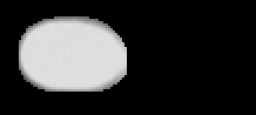

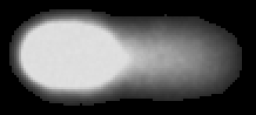

0.4252964152266564
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet108.png d=comet108.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


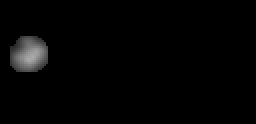

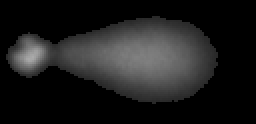

0.8708518697299014
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet20.png d=comet20.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


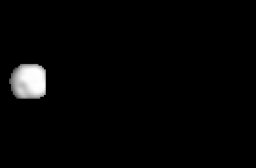

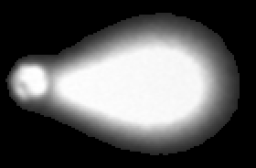

0.9404576679063662
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet230.png d=comet230.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


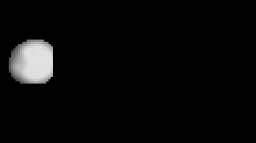

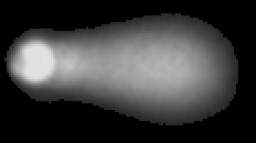

0.8552453094924639
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet181.png d=comet181.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


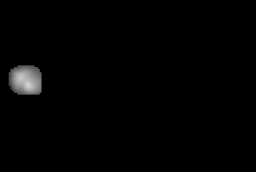

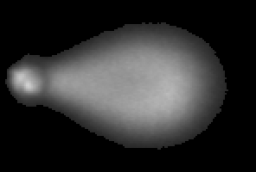

0.9425004442088276
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet241.png d=comet241.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


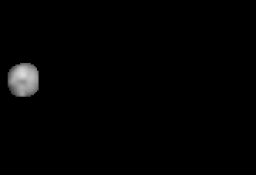

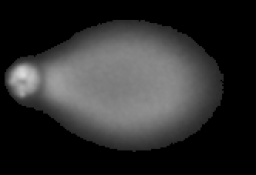

0.9352693620125127
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet322.png d=comet322.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


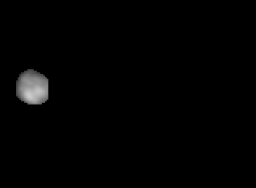

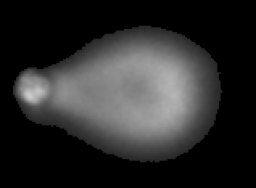

0.938678339621136
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet17.png d=comet17.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


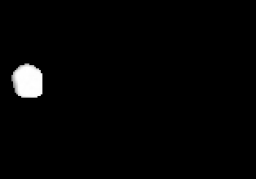

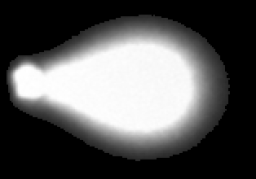

0.9473279312753513
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet336.png d=comet336.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


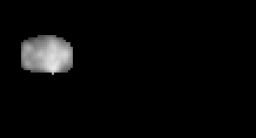

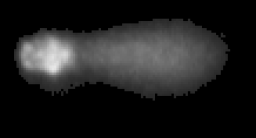

0.7460044008761098
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet57.png d=comet57.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


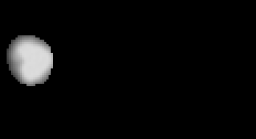

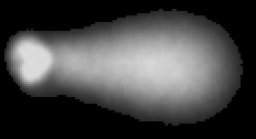

0.8666134281219603
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet43.png d=comet43.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


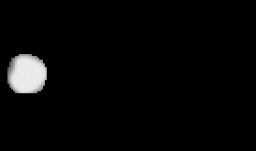

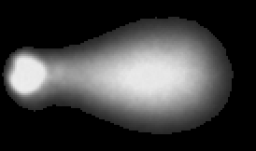

0.886771361657495
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet80.png d=comet80.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


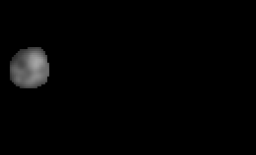

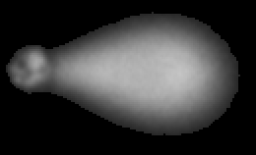

0.936653432456678
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet228.png d=comet228.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


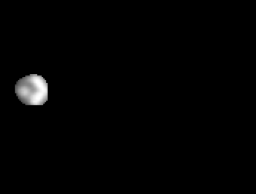

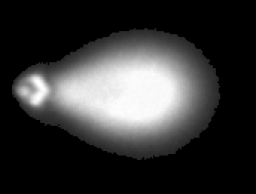

0.9440169479828957
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet317.png d=comet317.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


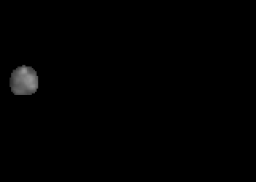

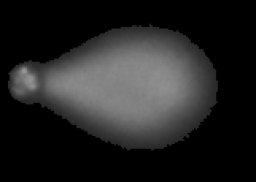

0.9570013158318991
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet274.png d=comet274.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


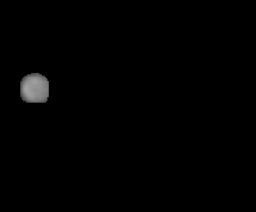

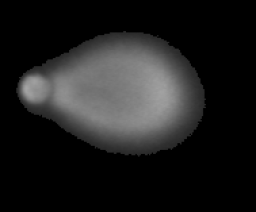

0.9418215546993245
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet343.png d=comet343.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


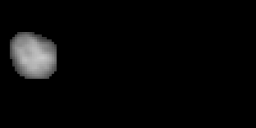

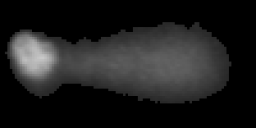

0.7471798274717982
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet157.png d=comet157.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


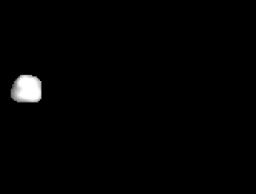

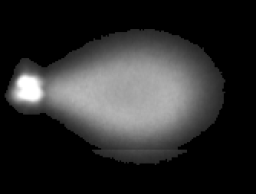

0.9292413150414195
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet42.png d=comet42.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


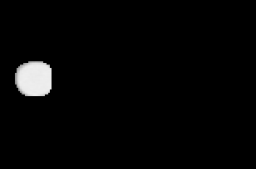

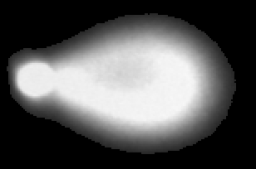

0.9316773249232853
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet269.png d=comet269.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


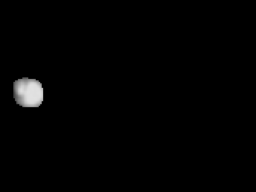

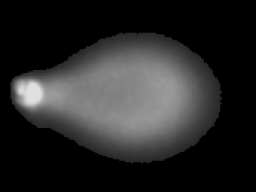

0.929977392036534
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet205.png d=comet205.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


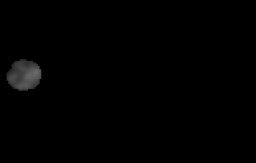

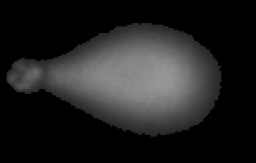

0.9574219017187974
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet126.png d=comet126.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


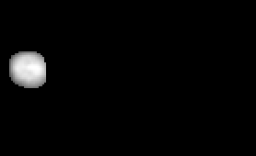

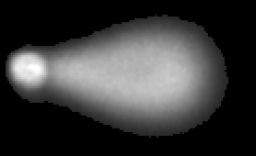

0.903541691530853
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet316.png d=comet316.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


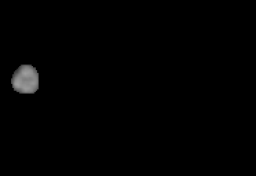

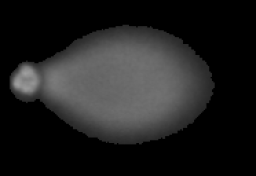

0.9428241887188907
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet176.png d=comet176.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


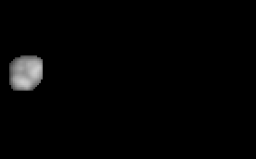

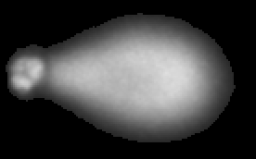

0.9401878999488226
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet242.png d=comet242.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


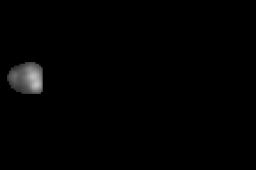

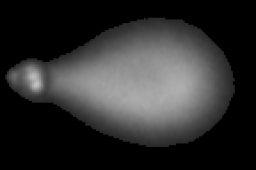

0.9503457093402778
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet369.png d=comet369.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


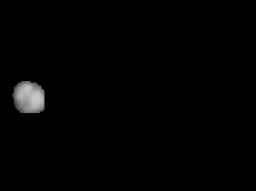

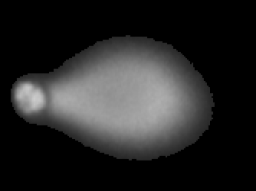

0.9316749178597445
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet393.png d=comet393.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


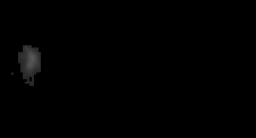

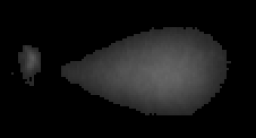

0.949792349726776
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet445.png d=comet445.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


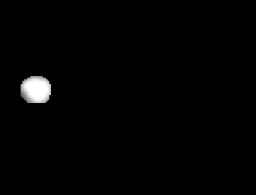

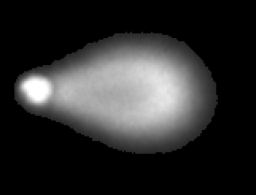

0.931420878487897
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet448.png d=comet448.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


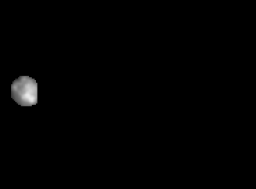

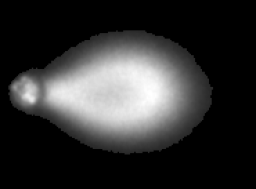

0.9584524074747841
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet416.png d=comet416.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


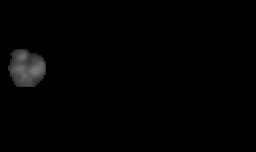

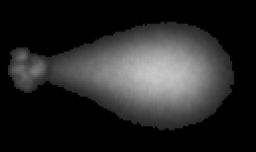

0.9429937571305875
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet447.png d=comet447.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


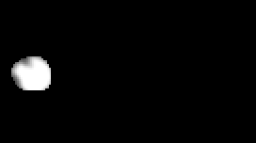

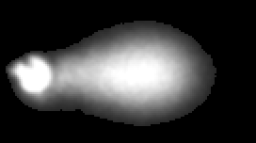

0.8836368921391812
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet370.png d=comet370.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


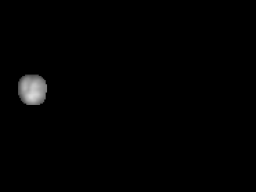

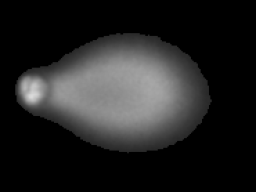

0.9358370640825928
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet385.png d=comet385.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


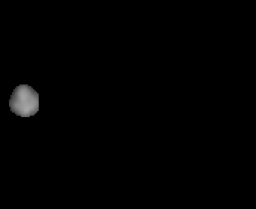

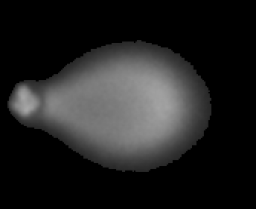

0.9482833641185043
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet363.png d=comet363.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


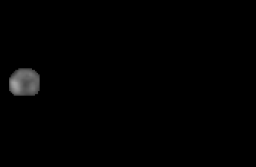

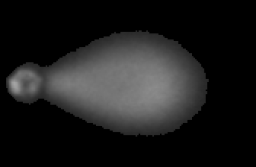

0.9388190147299883
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet429.png d=comet429.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


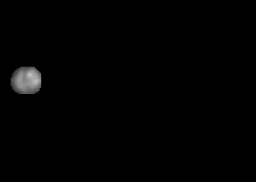

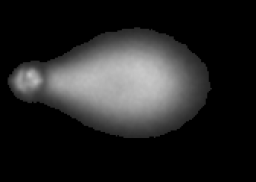

0.948407444161988
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet439.png d=comet439.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


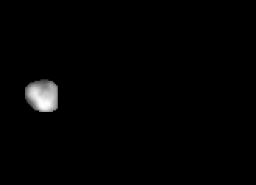

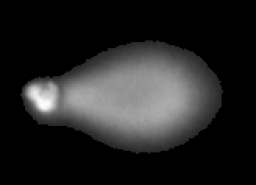

0.9095834725074798
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet431.png d=comet431.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


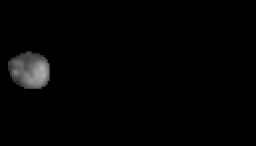

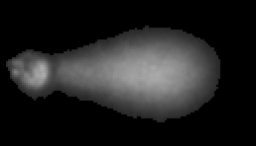

0.8965215246863618
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet441.png d=comet441.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


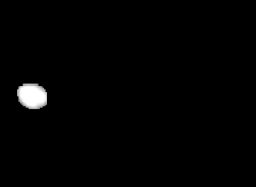

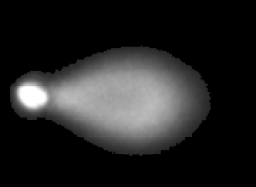

0.9157218307622478
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet394.png d=comet394.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


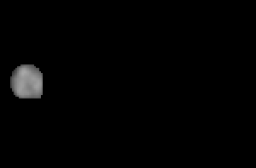

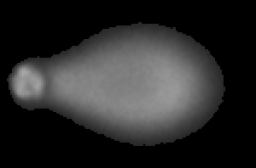

0.9315667751546803
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet357.png d=comet357.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


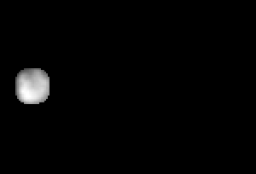

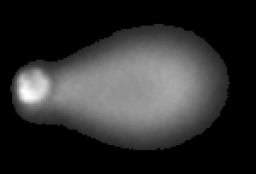

0.9088930797366094
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet436.png d=comet436.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


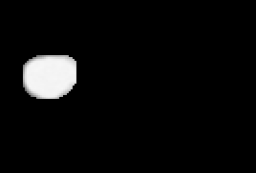

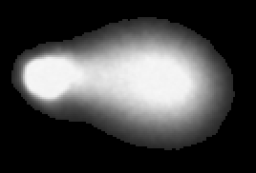

0.8452252472109909
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet426.png d=comet426.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


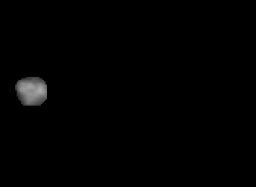

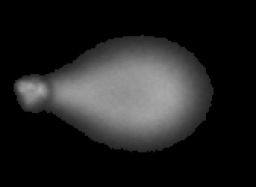

0.9456789949081561
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet362.png d=comet362.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


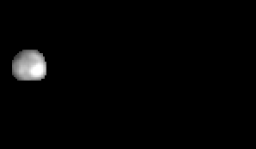

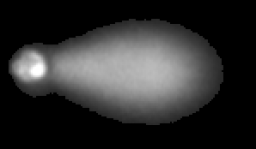

0.9118738560508183
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet424.png d=comet424.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


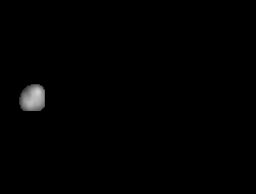

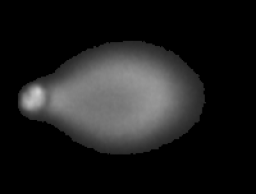

0.94351864979732
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet399.png d=comet399.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


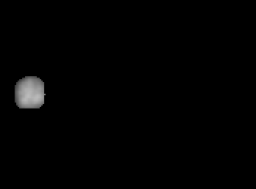

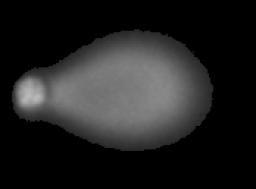

0.9267117277871841
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet383.png d=comet383.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


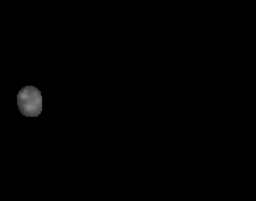

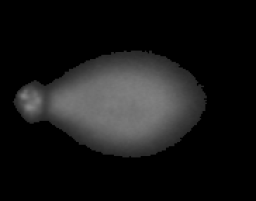

0.9500517731687007
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet350.png d=comet350.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


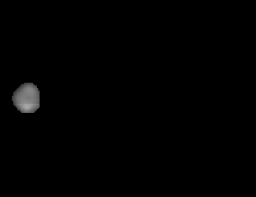

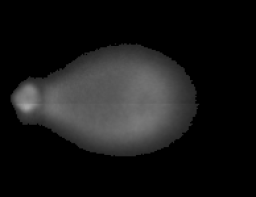

0.937454795785878
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet434.png d=comet434.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet353.png d=comet353.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


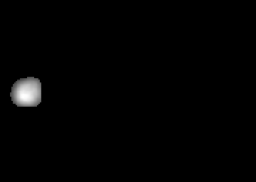

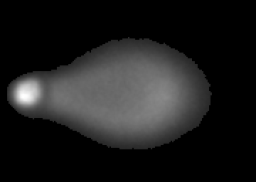

0.9084464037928696
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet458.png d=comet458.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


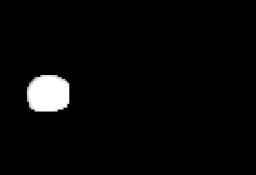

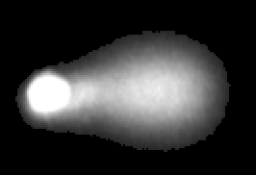

0.8608706169459971
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet422.png d=comet422.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


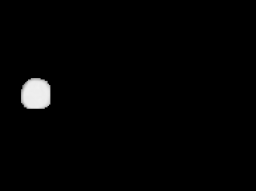

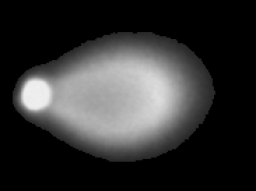

0.9274038029871192
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet446.png d=comet446.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


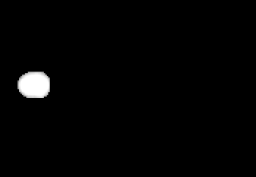

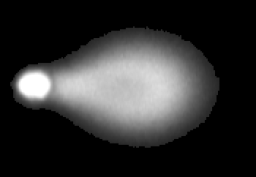

0.9202279535211652
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet397.png d=comet397.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


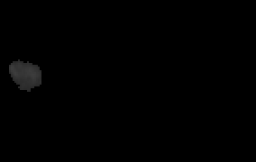

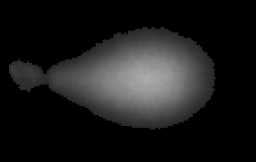

0.9668966516886506
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet364.png d=comet364.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


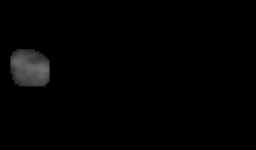

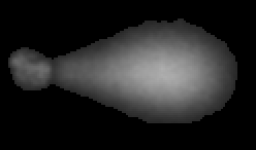

0.9286353717898506
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet400.png d=comet400.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet402.png d=comet402.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


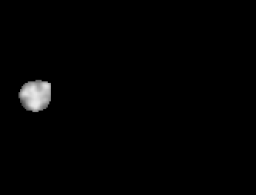

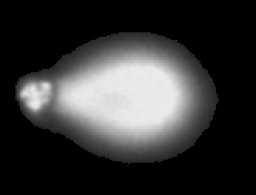

0.944996897452355
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet384.png d=comet384.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


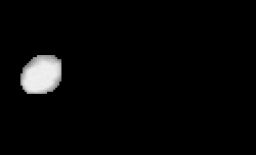

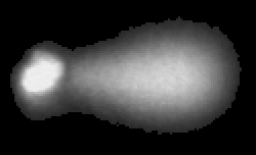

0.874522711319622
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet398.png d=comet398.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


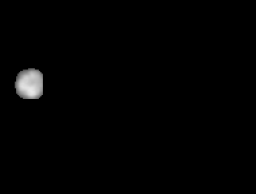

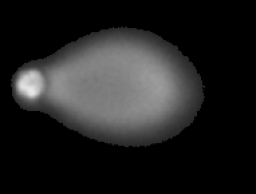

0.9243071127743666
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet443.png d=comet443.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet359.png d=comet359.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


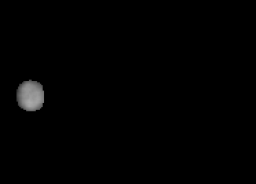

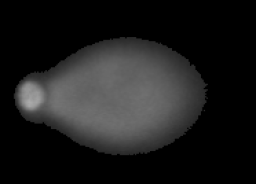

0.9322989089458519
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet450.png d=comet450.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


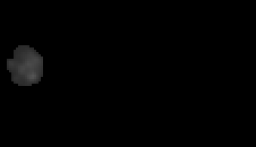

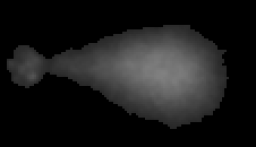

0.9338185393588654
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet414.png d=comet414.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


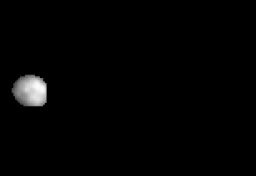

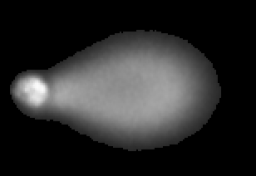

0.9181357485974112
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet373.png d=comet373.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


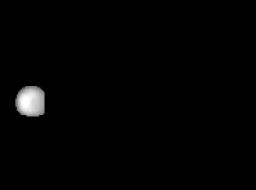

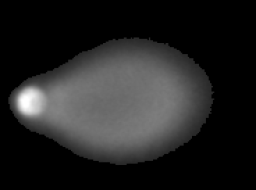

0.915139816642778
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet411.png d=comet411.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


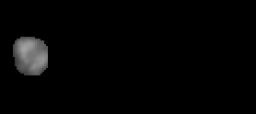

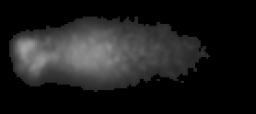

0.8453637441189678
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet437.png d=comet437.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


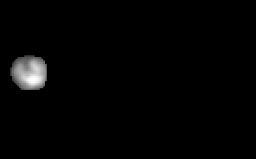

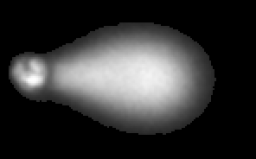

0.9221490513138163
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet371.png d=comet371.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


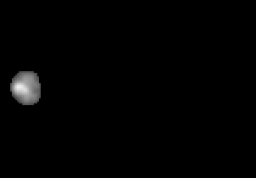

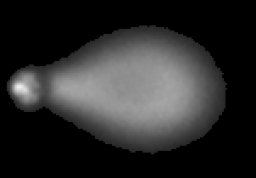

0.9424797896977274
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet379.png d=comet379.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


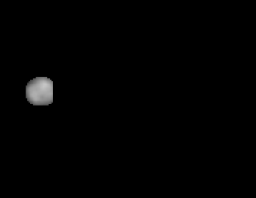

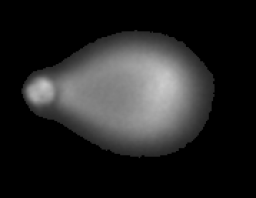

0.9468502793112333
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet352.png d=comet352.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


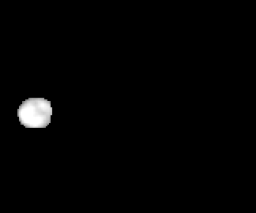

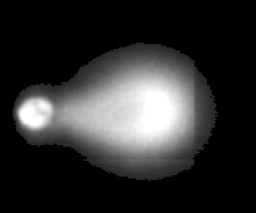

0.9237179543654698
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet374.png d=comet374.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


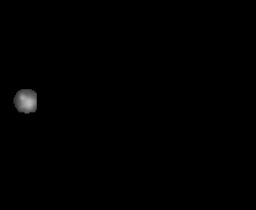

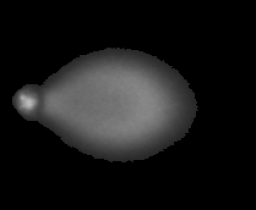

0.9587103886660568
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet407.png d=comet407.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


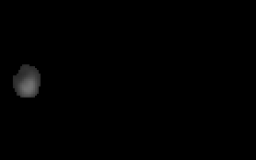

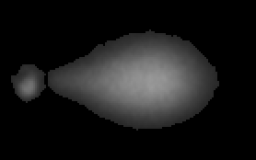

0.9500863292020237
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet360.png d=comet360.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


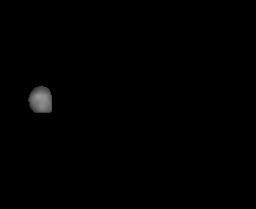

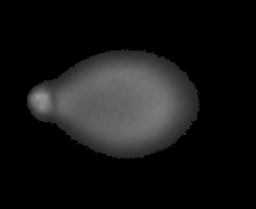

0.9489930406478089
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet444.png d=comet444.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


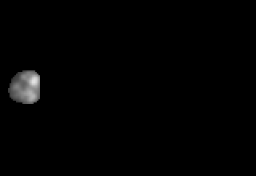

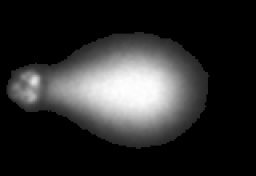

0.9458042359496952
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet372.png d=comet372.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


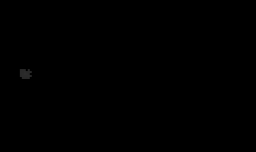

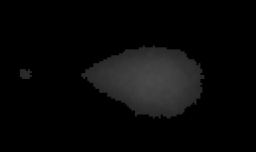

0.9874679405365326
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet454.png d=comet454.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


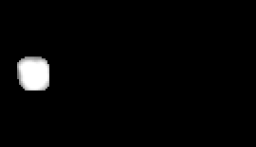

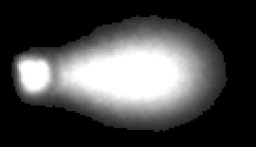

0.9170923749937749
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet432.png d=comet432.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


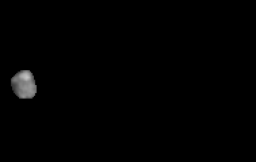

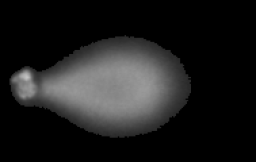

0.9420798114373244
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet380.png d=comet380.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


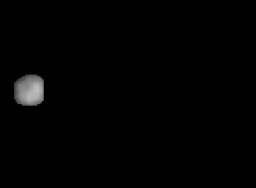

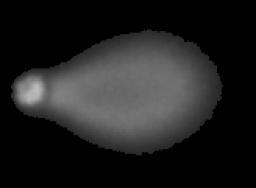

0.9294221548934779
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet354.png d=comet354.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


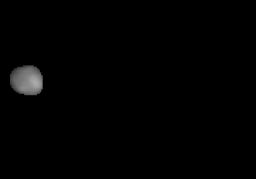

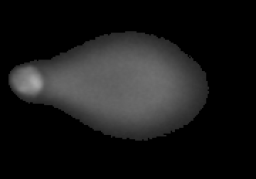

0.9197489646869151
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet390.png d=comet390.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


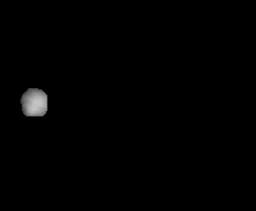

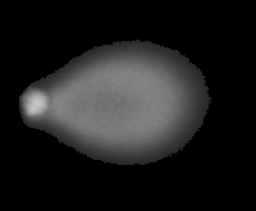

0.9426980409378126
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet376.png d=comet376.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


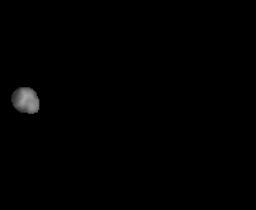

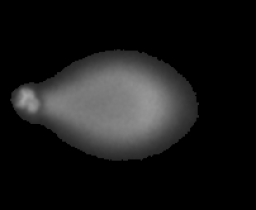

0.9505973340568653
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet367.png d=comet367.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


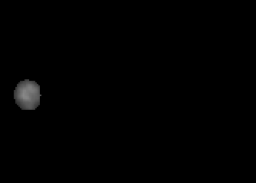

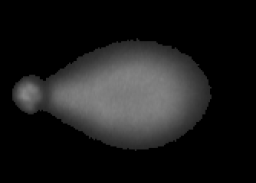

0.9525034208747548
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet405.png d=comet405.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


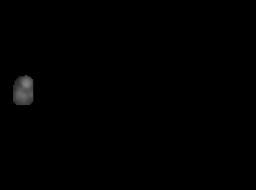

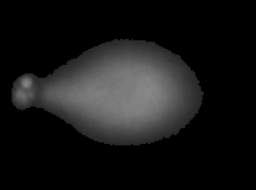

0.9617114399482246
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet406.png d=comet406.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


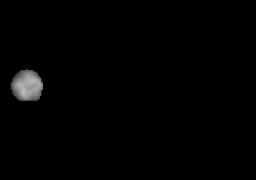

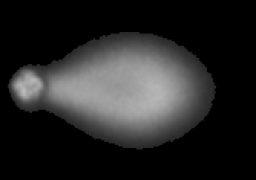

0.9374409514458791
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet366.png d=comet366.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


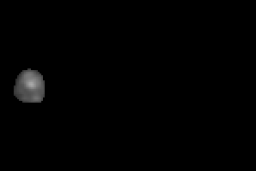

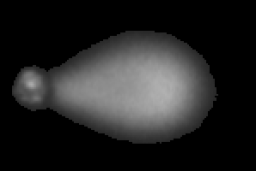

0.9486046616473558
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet382.png d=comet382.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


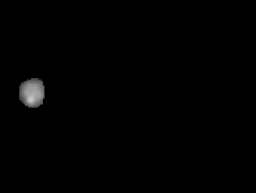

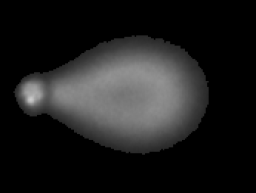

0.947318984331404
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet413.png d=comet413.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


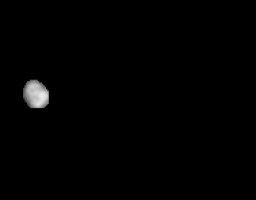

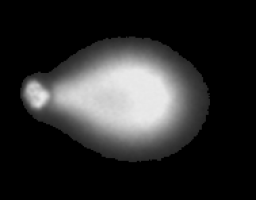

0.9549567205080235
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet438.png d=comet438.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


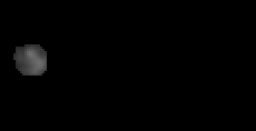

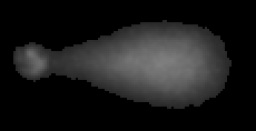

0.9275768630069703
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet440.png d=comet440.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


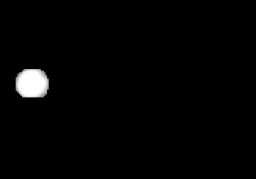

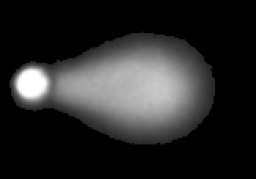

0.8975274670889835
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet449.png d=comet449.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


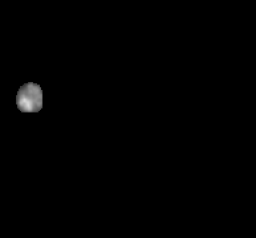

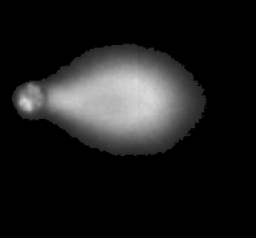

0.9500641104808838
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet433.png d=comet433.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


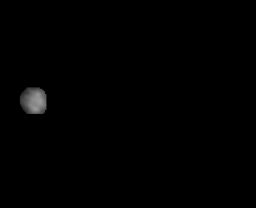

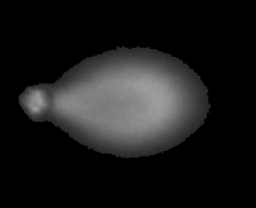

0.9545672927608102
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet347.png d=comet347.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


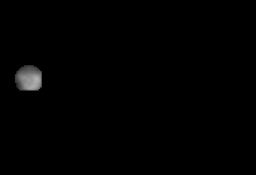

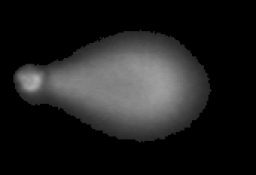

0.9505605631111252
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet368.png d=comet368.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


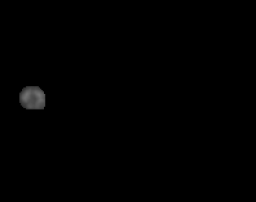

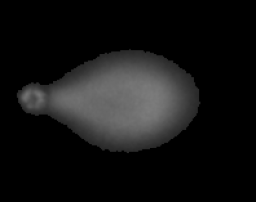

0.9578057344912542
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet415.png d=comet415.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


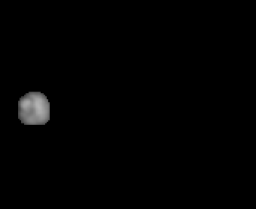

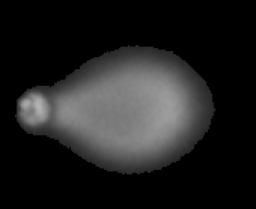

0.9328296208047905
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet381.png d=comet381.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


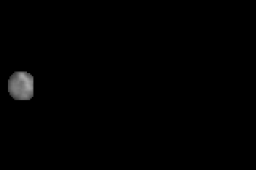

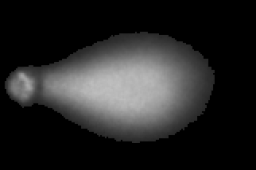

0.9559078193685893
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet417.png d=comet417.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


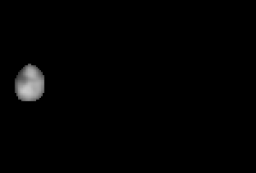

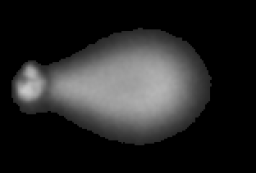

0.9275544663843585
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet455.png d=comet455.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


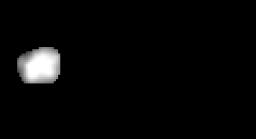

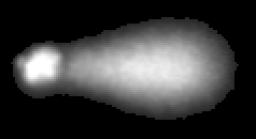

0.8718887147510637
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet410.png d=comet410.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


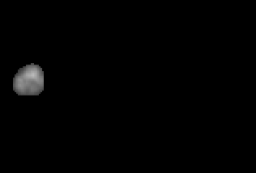

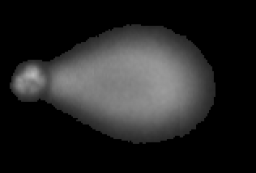

0.9420320647458095
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet388.png d=comet388.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


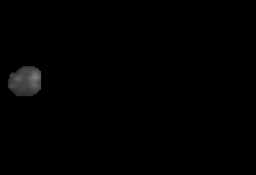

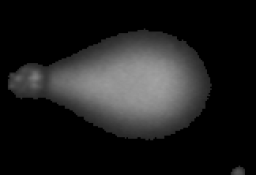

0.9561880508510493
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet430.png d=comet430.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


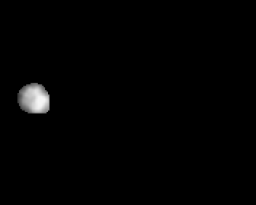

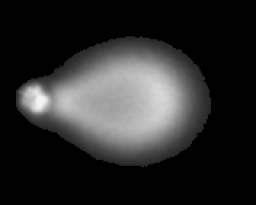

0.9376401267216254
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet346.png d=comet346.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


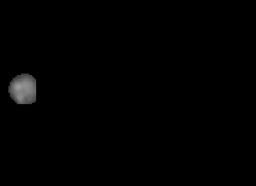

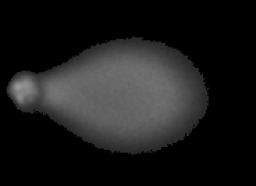

0.9419228943148666
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet418.png d=comet418.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


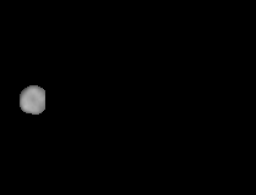

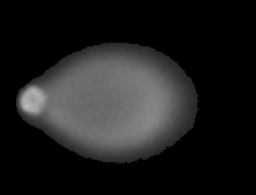

0.9359847466670946
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet423.png d=comet423.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


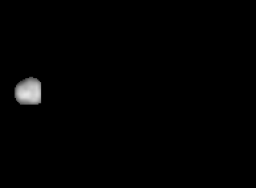

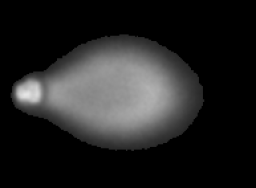

0.938164497478371
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet425.png d=comet425.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


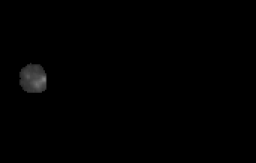

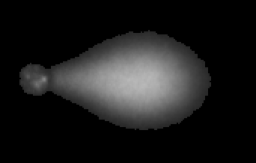

0.9617566650508967
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet412.png d=comet412.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


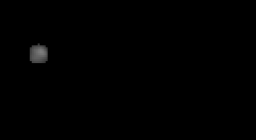

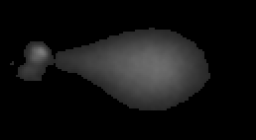

0.9584896069035206
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet386.png d=comet386.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


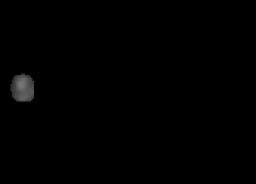

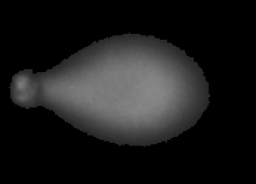

0.9652689255657815
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet392.png d=comet392.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


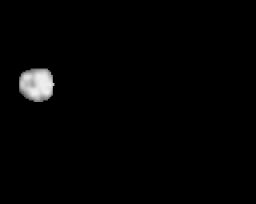

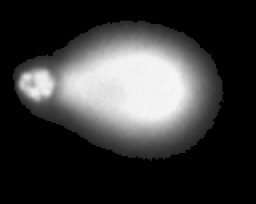

0.9385024826283308
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet456.png d=comet456.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


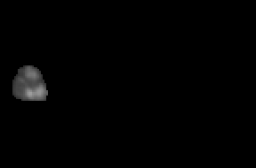

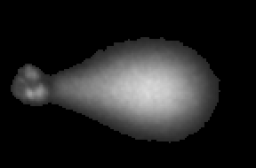

0.9408772758502233
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet403.png d=comet403.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


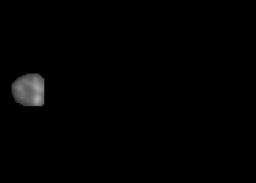

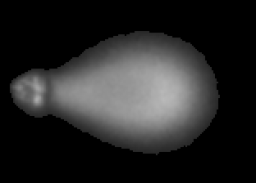

0.945672296516774
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet358.png d=comet358.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


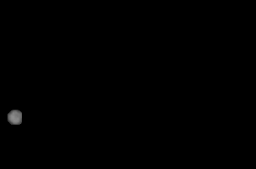

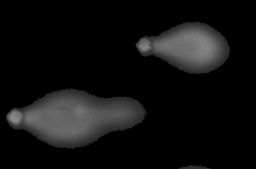

0.9705655983647705
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet355.png d=comet355.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


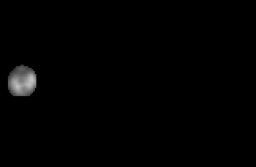

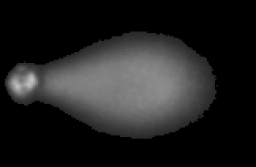

0.9358712154481236
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet395.png d=comet395.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


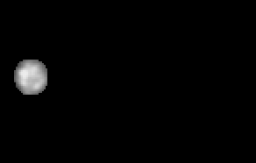

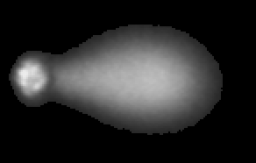

0.9061277165598102
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet457.png d=comet457.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


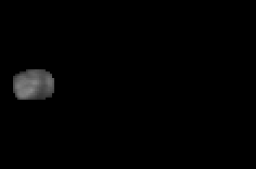

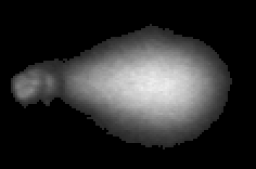

0.9465329644546984
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet451.png d=comet451.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


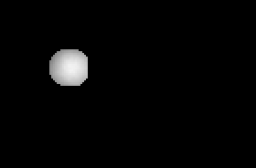

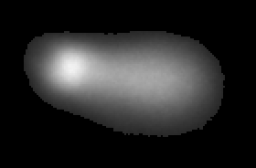

0.8607807231200478
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet361.png d=comet361.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


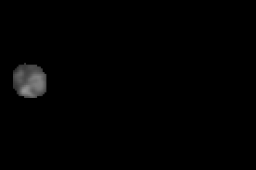

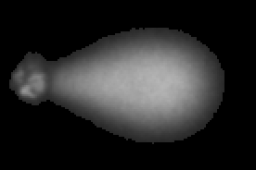

0.9482819007667351
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet427.png d=comet427.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


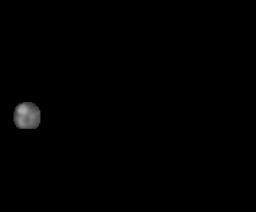

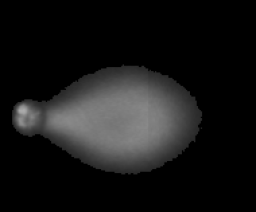

0.9473377186811125
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet404.png d=comet404.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


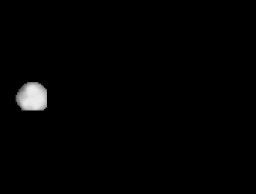

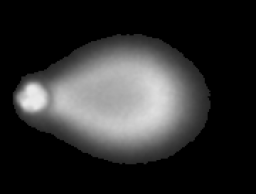

0.9378697336158607
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet428.png d=comet428.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


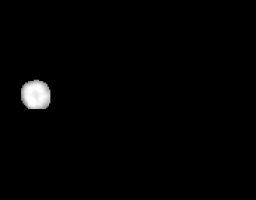

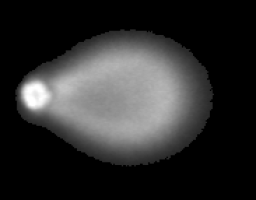

0.9321035273260533
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet408.png d=comet408.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


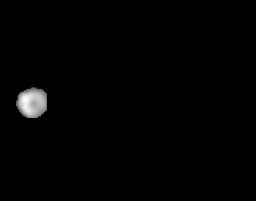

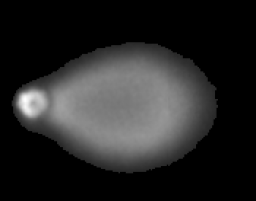

0.9325577063447197
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet435.png d=comet435.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


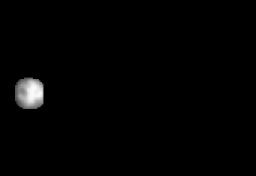

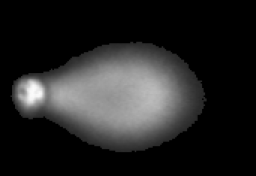

0.9195110165693955
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet453.png d=comet453.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


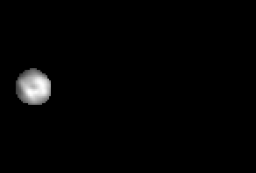

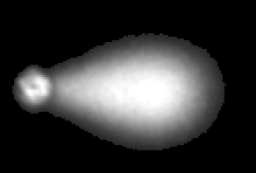

0.9275404870212598
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet375.png d=comet375.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


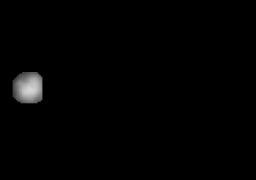

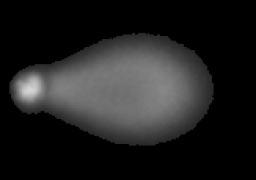

0.9204657956529997
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet421.png d=comet421.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet378.png d=comet378.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


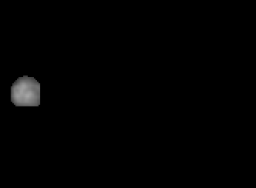

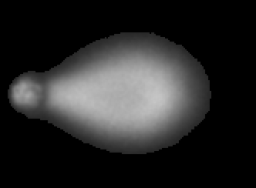

0.9529703826724795
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet396.png d=comet396.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


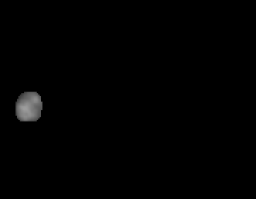

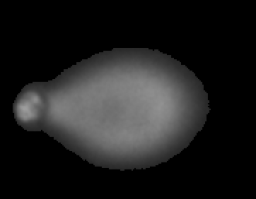

0.9506320121692263
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet420.png d=comet420.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


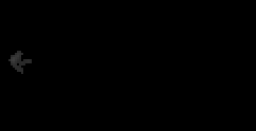

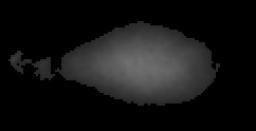

0.9832085847137858
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet348.png d=comet348.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


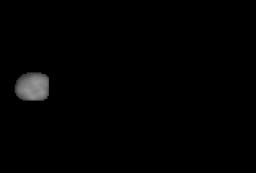

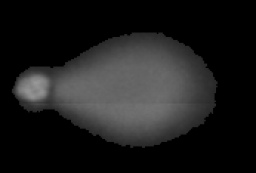

0.9232896690017969
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet389.png d=comet389.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet349.png d=comet349.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


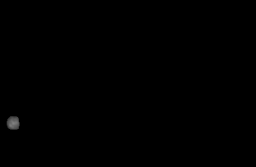

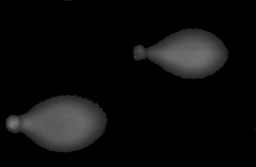

0.9752205809795055
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet356.png d=comet356.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


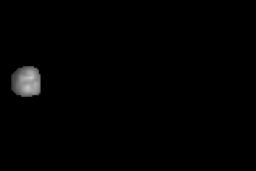

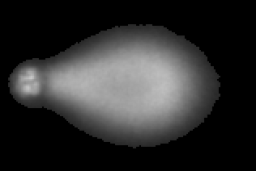

0.9499460318589948
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet401.png d=comet401.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


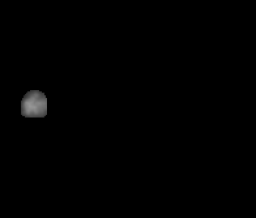

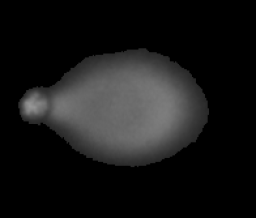

0.9513283021154563
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet351.png d=comet351.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


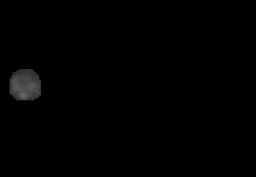

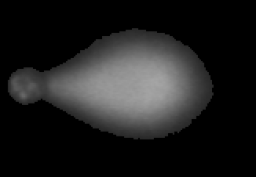

0.9575182544332195
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet409.png d=comet409.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


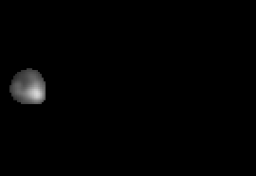

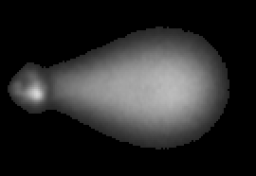

0.9419155824087524
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet387.png d=comet387.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


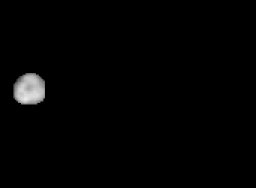

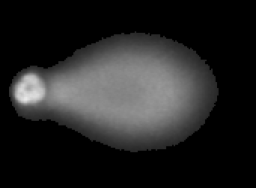

0.9157471303961756
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet419.png d=comet419.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


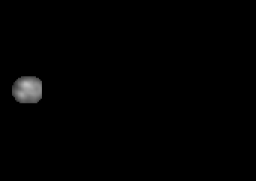

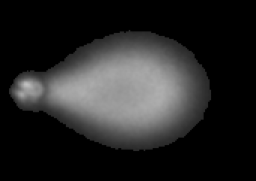

0.9518826575075614
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet391.png d=comet391.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


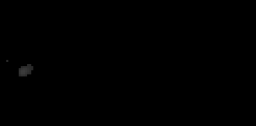

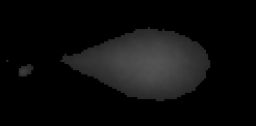

0.9841088241159615
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet452.png d=comet452.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


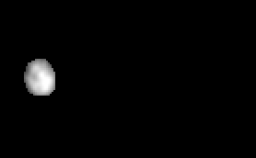

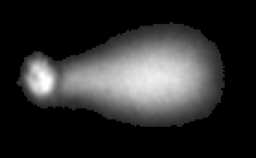

0.9079101580217348
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet377.png d=comet377.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


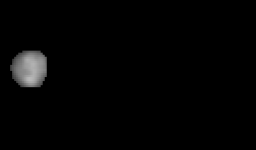

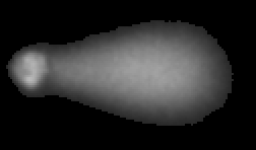

0.9094005396821299
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet442.png d=comet442.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


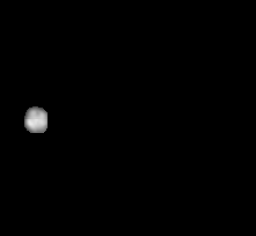

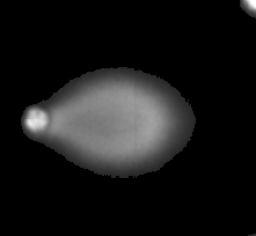

0.9388907623693248
path=/content/drive/MyDrive/PyCharm Projects/A4/A4./comet365.png d=comet365.png, dir=/content/drive/MyDrive/PyCharm Projects/A4/A4.


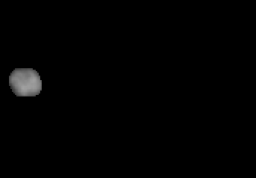

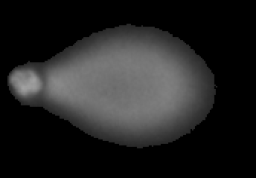

0.9405109167681167


In [48]:
import imutils

def calculate_damage(img):
    global head, whole
    comet = img
    #print ('comet', comet.shape, comet.dtype)
    outputs = predictor(comet)
    predictions = outputs["instances"].to("cpu")
    if len(predictions.pred_masks) == 0:
        return (-1, -1, -1, False)
    headmask_bool = predictions.pred_masks[0].cpu().detach().numpy()
    head = (headmask_bool * 255).astype('uint8')
    #print('head', head.shape, head.dtype)
    comet = cv2.cvtColor(comet, cv2.COLOR_BGR2GRAY)
    THRESH = 40
    comet = np.where(comet < THRESH, 0, comet)
    #print('comet',comet.shape, comet.dtype)
    diff3 = cv2.bitwise_and(comet,comet,mask = head)
    head = diff3
    whole = comet
    totalarea = np.sum(comet)
    headarea = np.sum(diff3)
    taildamage = (totalarea-headarea)/(totalarea)
    #print(f'totalarea = {totalarea},headarea={headarea},taildamage={taildamage}')
    bigmask = imutils.resize(diff3, width=256)
    bigcomet = imutils.resize(comet, width=256)
    cv2_imshow(bigmask)
    cv2_imshow(bigcomet)
    print(taildamage)
    return (totalarea,headarea,taildamage, True)

import csv
def write_stats(dir):
    results = []
    for d in os.listdir(dir):
        #print('d', d, dir)
        if not d.endswith("png"):
          continue
        path = os.path.join(dir,d)
        print(f'path={path} d={d}, dir={dir}')
        im = cv2.imread(path)
        if im is None:
          print(f'null image read {path}')
          continue
        ta,ha,td, good = calculate_damage(im)
        if good:
          results.append([ta,ha,td,d])
    with open(f'{dir}_stats.csv', "w", newline="") as f:
      f.write("#totalarea,headarea,taildamage,file\n")
      for (totalarea,headarea,taildamage,d) in results:
          f.write(f'{totalarea:.2f},{headarea:.2f},{taildamage:.2f},{d}\n')


  
write_stats('/content/drive/MyDrive/PyCharm Projects/') 

(17, 26, 3)


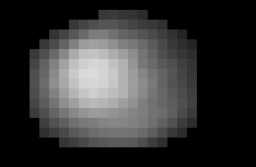

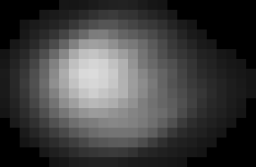

0.17076395340527406


head sum=23207, whole sum = 27986, % = 0.8292360465947259
0
(17, 26)
198 198


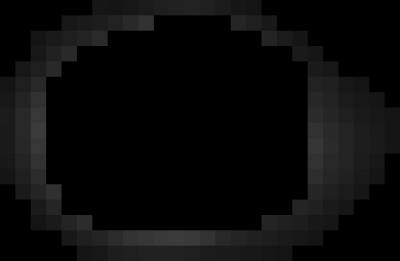

In [46]:
im = cv2.imread("/content/drive/MyDrive/PyCharm Projects/Low Damage C3/C3/comet148.png")
print(im.shape)
calculate_damage(im)
cv2_imshow(head)
cv2_imshow(whole)
hsum = np.sum(head)
wsum = np.sum(whole)
print(f'head sum={hsum}, whole sum = {wsum}, % = {hsum/wsum}')
w = whole.shape[1]
h = whole.shape[0]
print(whole[0,0])
print(whole.shape)
print(whole[8,11], head[8,11])
diff = whole-head
cv2_imshow(imutils.resize(diff, width=400))


/content/Low/comet118.png


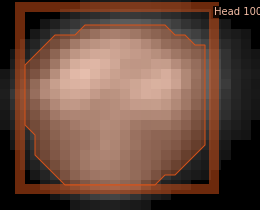

/content/Low/comet133.png


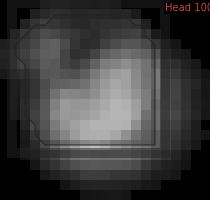

/content/Low/comet129.png


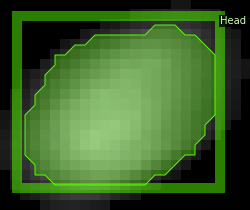

/content/Low/comet69.png


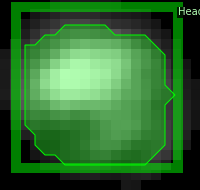

/content/Low/comet39.png


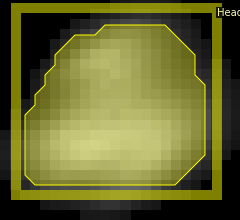

/content/Low/comet35.png


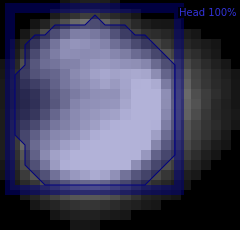

/content/Low/comet97.png


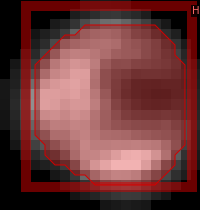

/content/Low/._comet6.png
null image read /content/Low/._comet6.png
/content/Low/comet64.png


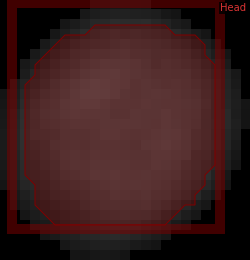

/content/Low/comet77.png


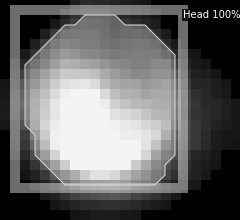

/content/Low/comet73.png


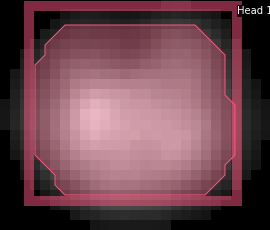

/content/Low/comet67.png


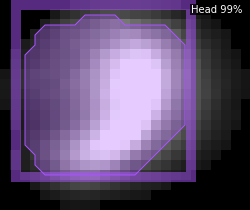

/content/Low/comet150.png


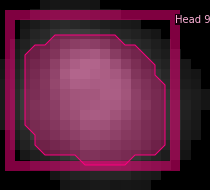

/content/Low/comet58.png


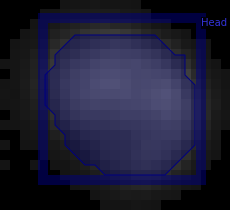

/content/Low/comet54.png


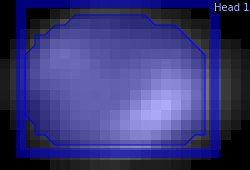

/content/Low/comet24.png


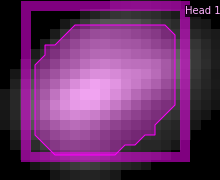

/content/Low/comet91.png


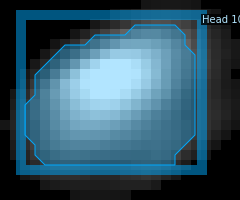

/content/Low/comet89.png


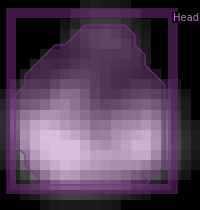

/content/Low/comet34.png


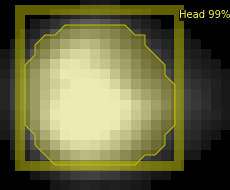

/content/Low/comet22.png


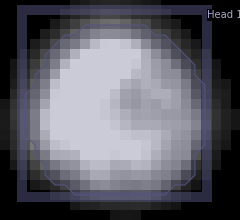

/content/Low/comet148.png


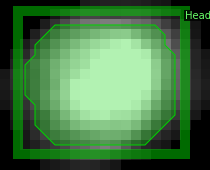

/content/Low/comet132.png


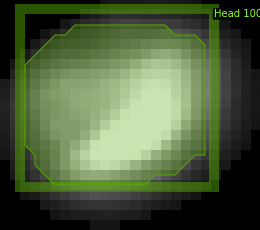

/content/Low/comet47.png


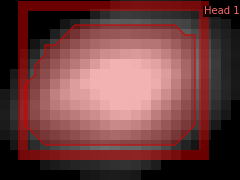

/content/Low/comet59.png


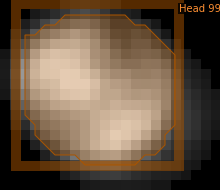

/content/Low/comet25.png


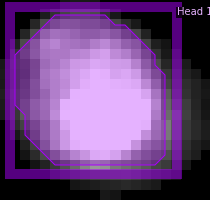

/content/Low/comet149.png


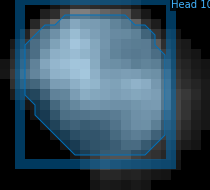

/content/Low/comet65.png


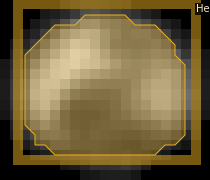

/content/Low/comet102.png


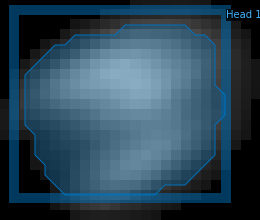

/content/Low/comet27.png


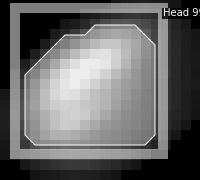

/content/Low/comet3.png


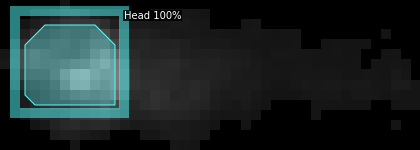

/content/Low/comet30.png


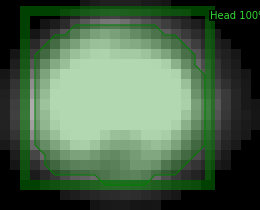

/content/Low/comet114.png


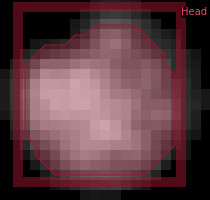

/content/Low/comet53.png


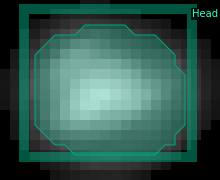

/content/Low/comet41.png


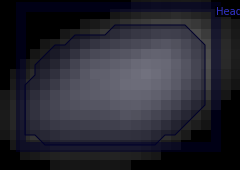

/content/Low/comet8.png


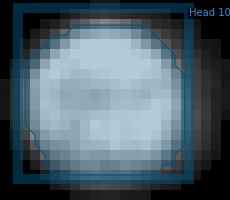

/content/Low/comet117.png


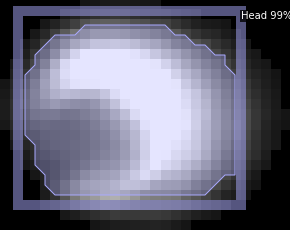

/content/Low/comet36.png


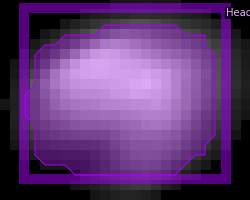

/content/Low/comet85.png


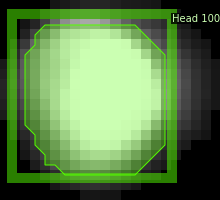

/content/Low/comet2.png


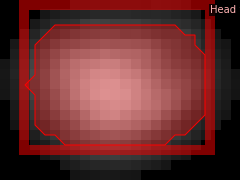

/content/Low/comet48.png


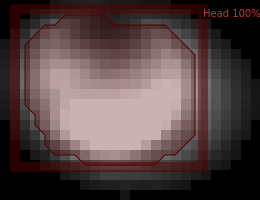

/content/Low/comet56.png


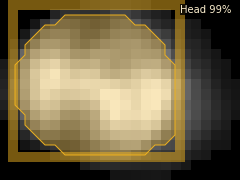

/content/Low/comet143.png


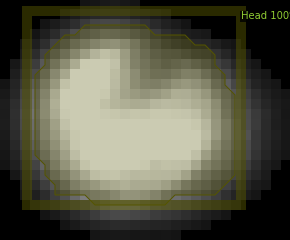

/content/Low/comet103.png


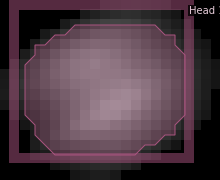

/content/Low/comet151.png


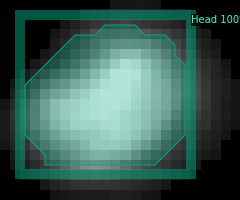

/content/Low/comet121.png


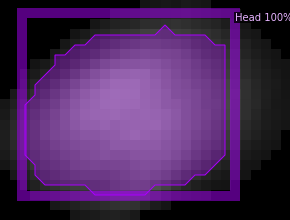

/content/Low/comet70.png


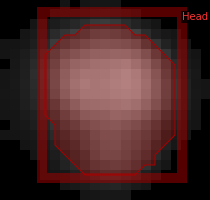

/content/Low/comet152.png


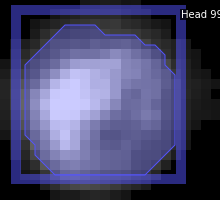

/content/Low/._comet30.png
null image read /content/Low/._comet30.png
/content/Low/comet99.png


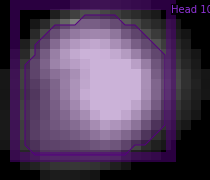

/content/Low/comet94.png


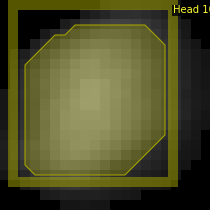

/content/Low/comet20.png


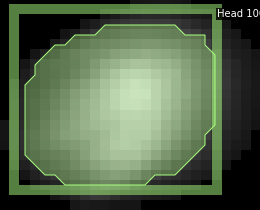

/content/Low/comet130.png


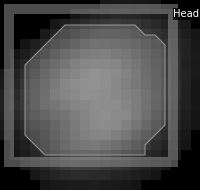

/content/Low/comet141.png


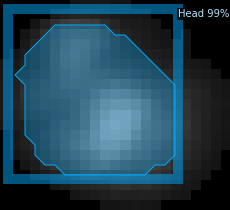

/content/Low/comet68.png


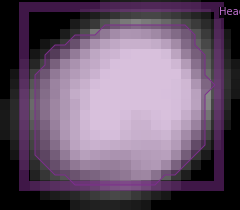

/content/Low/comet83.png


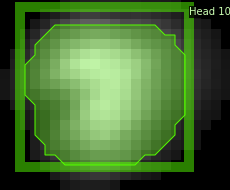

/content/Low/comet111.png


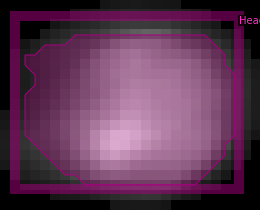

/content/Low/comet125.png


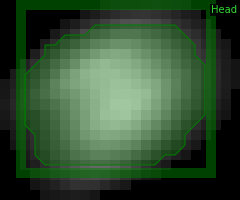

/content/Low/comet72.png


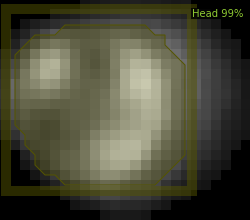

/content/Low/comet43.png


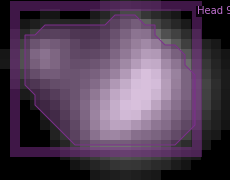

/content/Low/comet119.png


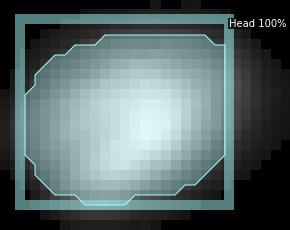

/content/Low/comet84.png


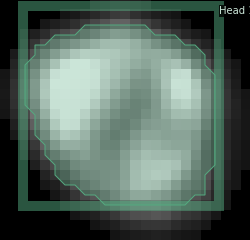

/content/Low/comet32.png


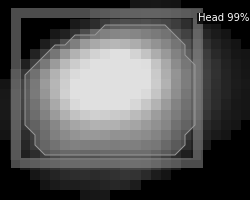

/content/Low/comet98.png


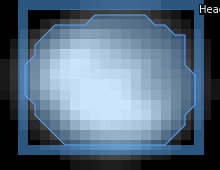

/content/Low/comet153.png


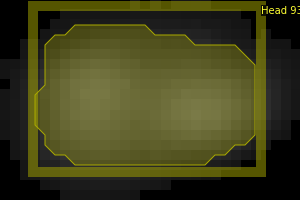

/content/Low/comet100.png


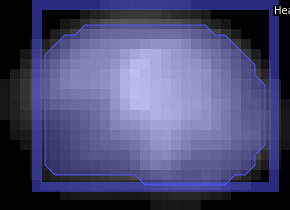

/content/Low/comet138.png


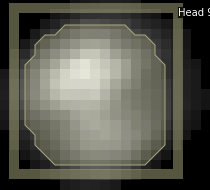

/content/Low/comet139.png


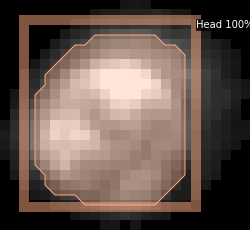

/content/Low/comet50.png


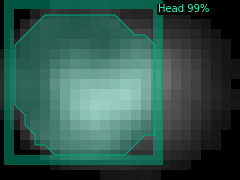

/content/Low/comet122.png


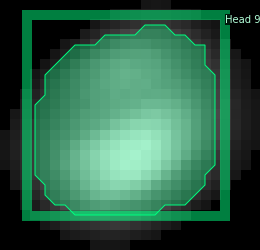

/content/Low/comet109.png


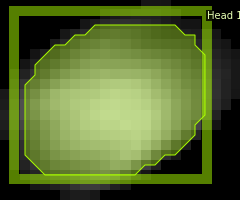

/content/Low/comet7.png


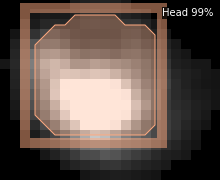

/content/Low/comet79.png


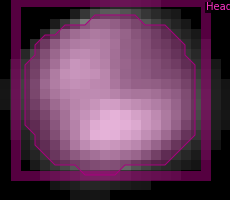

/content/Low/comet120.png


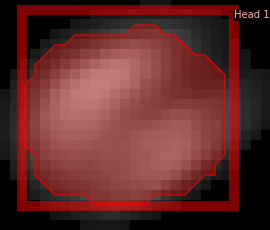

/content/Low/comet28.png


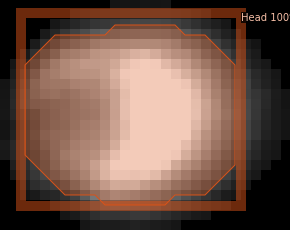

/content/Low/comet71.png


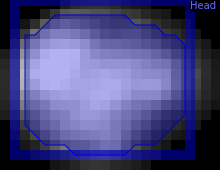

/content/Low/comet86.png


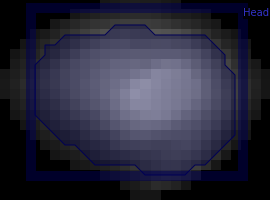

/content/Low/comet66.png


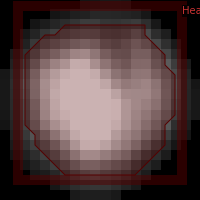

/content/Low/comet87.png


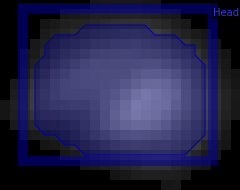

/content/Low/comet131.png


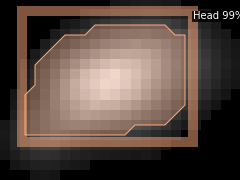

/content/Low/comet142.png


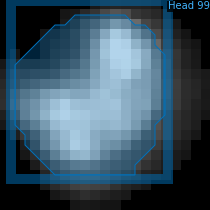

/content/Low/comet75.png


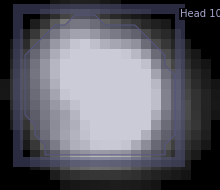

/content/Low/comet5.png


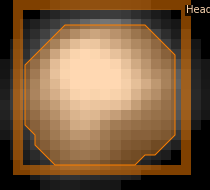

/content/Low/comet52.png


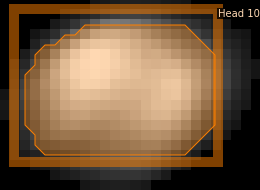

/content/Low/comet15.png


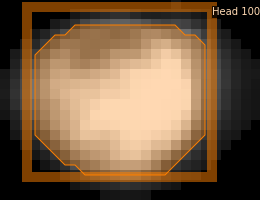

/content/Low/comet1.png


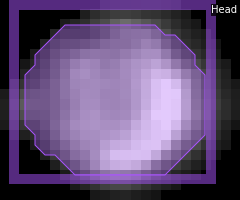

/content/Low/comet92.png


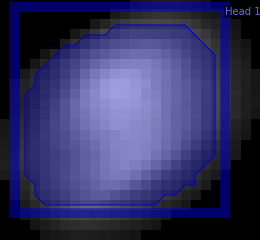

/content/Low/comet144.png


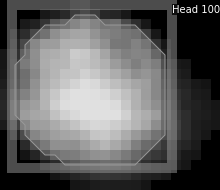

/content/Low/comet106.png


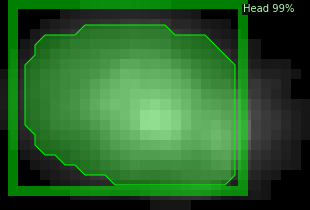

/content/Low/comet63.png


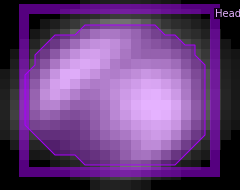

/content/Low/comet101.png


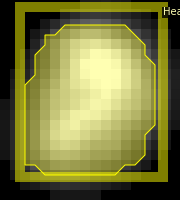

/content/Low/comet12.png


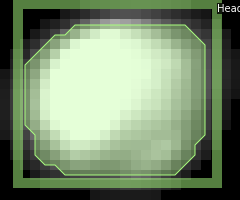

/content/Low/comet115.png


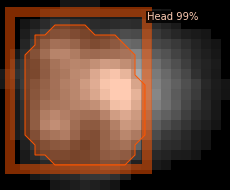

/content/Low/comet6.png


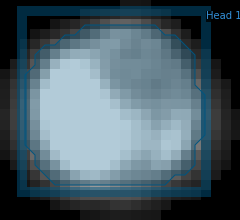

/content/Low/comet38.png


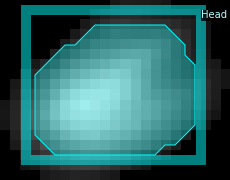

/content/Low/._comet85.png
null image read /content/Low/._comet85.png
/content/Low/comet45.png


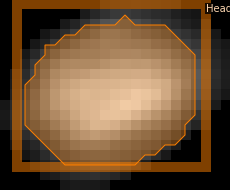

/content/Low/comet126.png


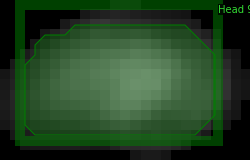

/content/Low/comet61.png


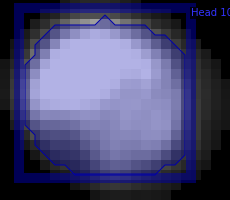

/content/Low/comet116.png


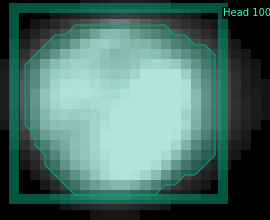

/content/Low/comet62.png


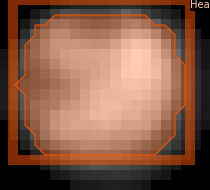

/content/Low/comet76.png


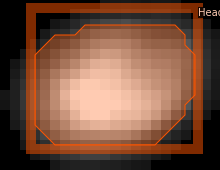

/content/Low/comet110.png


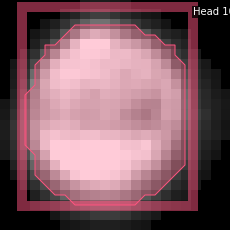

/content/Low/comet29.png


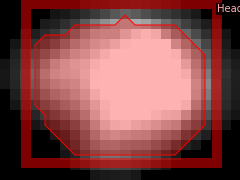

/content/Low/comet107.png


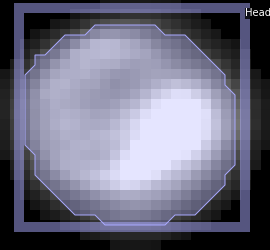

/content/Low/comet51.png


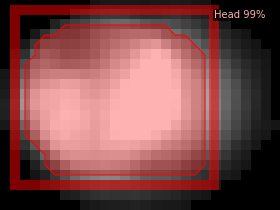

/content/Low/comet127.png


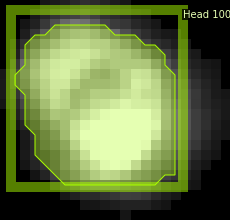

/content/Low/comet128.png


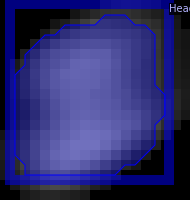

/content/Low/comet42.png


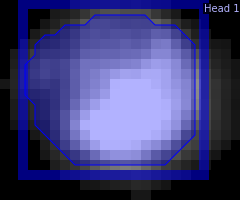

/content/Low/comet18.png


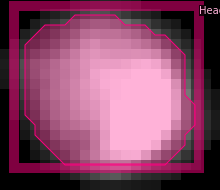

/content/Low/comet74.png


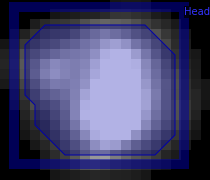

/content/Low/comet93.png


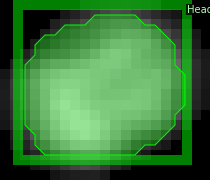

/content/Low/comet11.png


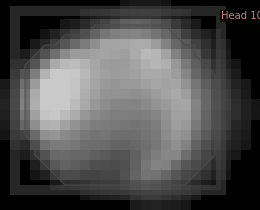

/content/Low/comet95.png


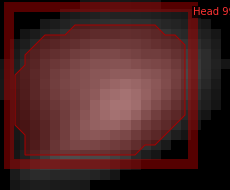

/content/Low/comet104.png


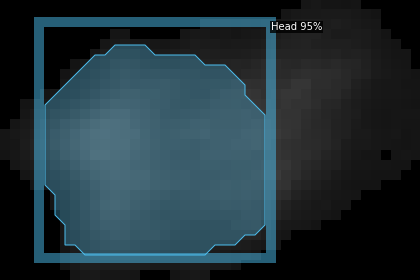

/content/Low/comet55.png


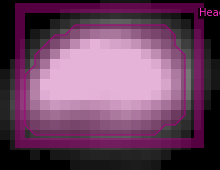

/content/Low/comet124.png


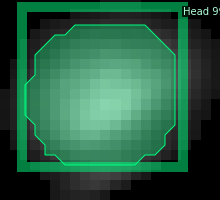

/content/Low/comet26.png


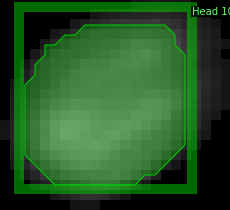

/content/Low/comet80.png


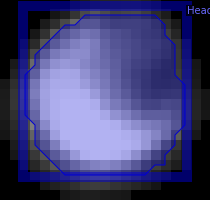

/content/Low/comet96.png


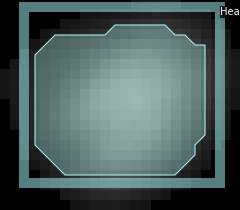

/content/Low/comet57.png


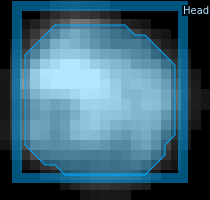

/content/Low/comet49.png


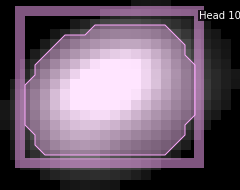

/content/Low/._comet106.png
null image read /content/Low/._comet106.png
/content/Low/comet140.png


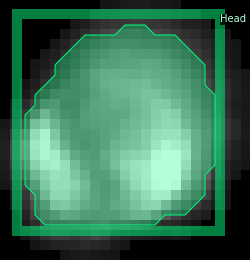

/content/Low/comet40.png


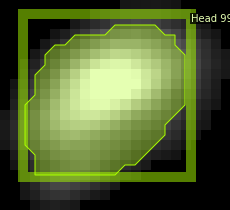

/content/Low/comet123.png


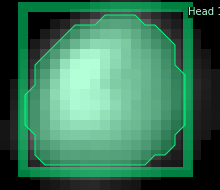

/content/Low/comet46.png


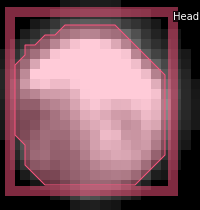

/content/Low/comet17.png


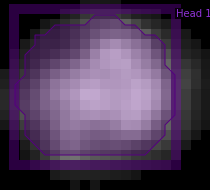

/content/Low/comet135.png


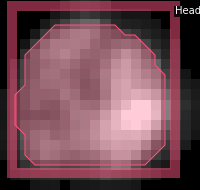

/content/Low/comet16.png


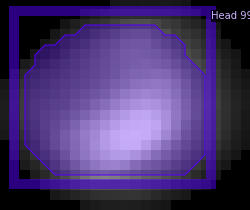

/content/Low/comet105.png


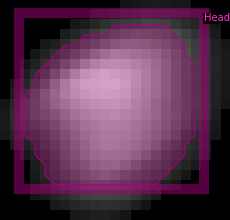

/content/Low/comet9.png


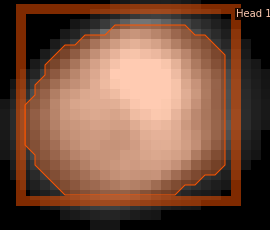

/content/Low/comet81.png


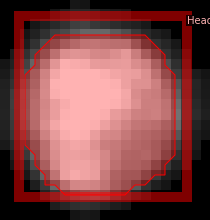

/content/Low/._comet49.png
null image read /content/Low/._comet49.png
/content/Low/comet146.png


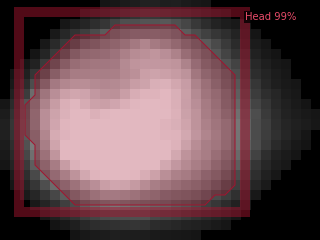

/content/Low/comet44.png


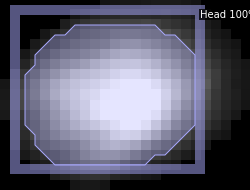

/content/Low/._comet66.png
null image read /content/Low/._comet66.png
/content/Low/comet19.png


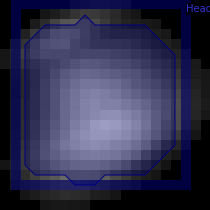

/content/Low/comet14.png


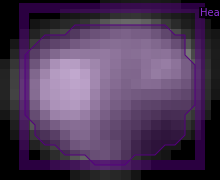

/content/Low/comet60.png


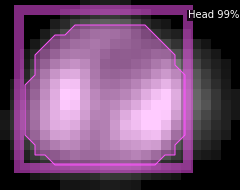

/content/Low/comet108.png


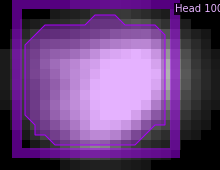

/content/Low/comet145.png


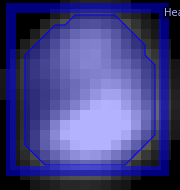

/content/Low/comet147.png


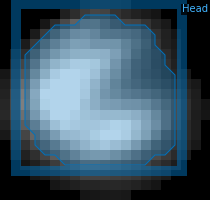

/content/Low/comet88.png


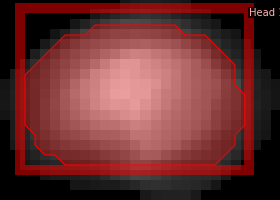

/content/Low/comet112.png


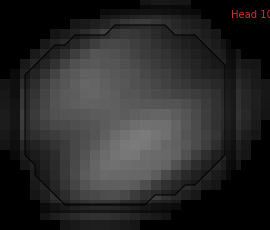

/content/Low/comet23.png


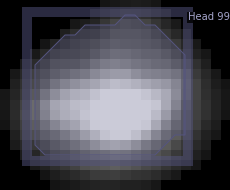

/content/Low/comet33.png


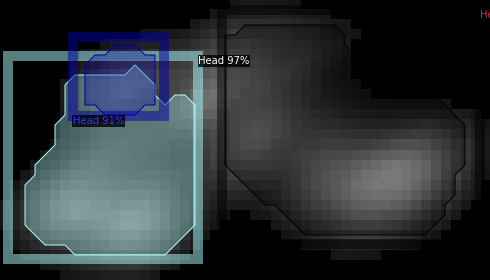

/content/Low/comet136.png


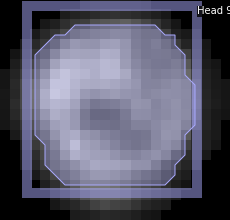

/content/Low/comet134.png


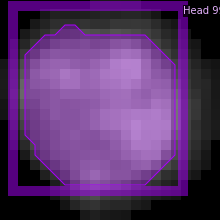

/content/Low/comet78.png


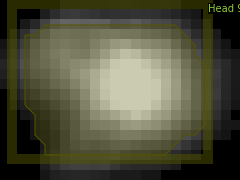

/content/Low/comet90.png


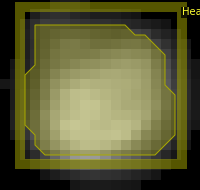

/content/Low/comet37.png


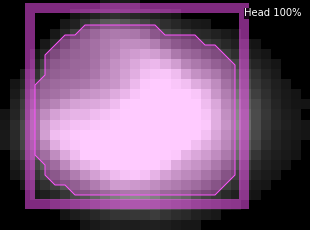

/content/Low/comet137.png


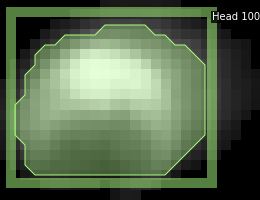

/content/Low/comet31.png


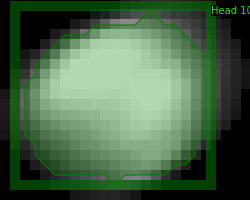

/content/Low/comet82.png


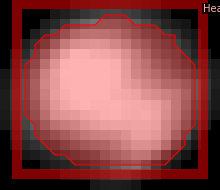

/content/Low/comet4.png


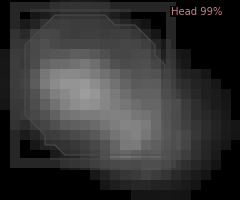

/content/Low/comet10.png


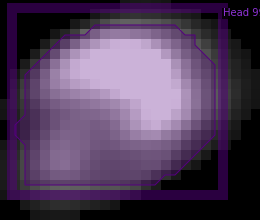

/content/Low/comet113.png


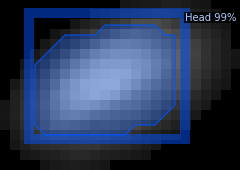

/content/Low/comet21.png


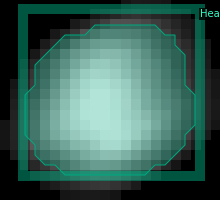

/content/Low/comet13.png


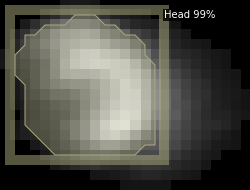

In [ ]:
from detectron2.utils.visualizer import ColorMode
import os


for d in os.listdir("/content/Low"):
    if not d.endswith("png"):
      continue
    file = f'/content/Low/{d}'
    print(file)
    im = cv2.imread(file)
    if im is None:
      print(f'null image read {file}')
      continue
    outputs = predictor(im)
    #import pdb; pdb.set_trace()    
    v = Visualizer(im[:, :, ::-1],
              metadata=metadata, 
              scale=10, 
              instance_mode=ColorMode.IMAGE_BW)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("balloon_val", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "balloon_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[07/08 22:50:43 d2.evaluation.coco_evaluation]: 'balloon_val' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[07/08 22:50:43 d2.data.datasets.coco]: Converting annotations of dataset 'balloon_val' to COCO format ...)
[07/08 22:50:43 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[07/08 22:50:43 d2.data.datasets.coco]: Conversion finished, #images: 13, #annotations: 50
[07/08 22:50:43 d2.data.datasets.coco]: Caching COCO format annotations at './output/balloon_val_coco_format.json' ...
[07/08 22:50:44 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|  balloon   | 50           |
|            |              |
[07/08 22:50:44 d2.data.common]: Serializing 13 elements to byte tensors and concatenating them all ...
[07/08 22:50:44 d2.data.common]: Serialized dataset takes 0.04 MiB
[07/08 22:50:44 d2.data.dataset_mapper]: Augmentations used in trai

OrderedDict([('bbox',
              {'AP': 66.7575984802854,
               'AP50': 84.71906024215401,
               'AP75': 79.6850976022887,
               'APl': 79.51426848548515,
               'APm': 54.933394319629045,
               'APs': 23.917443214909724}),
             ('segm',
              {'AP': 76.79883944079043,
               'AP50': 84.20295316611471,
               'AP75': 83.95779282808186,
               'APl': 93.57150630750836,
               'APm': 56.50588544163433,
               'APs': 5.8381956414264895})])

# Other types of builtin models

WARNING [10/15 06:33:32 d2.config.compat]: Config './detectron2_repo/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.


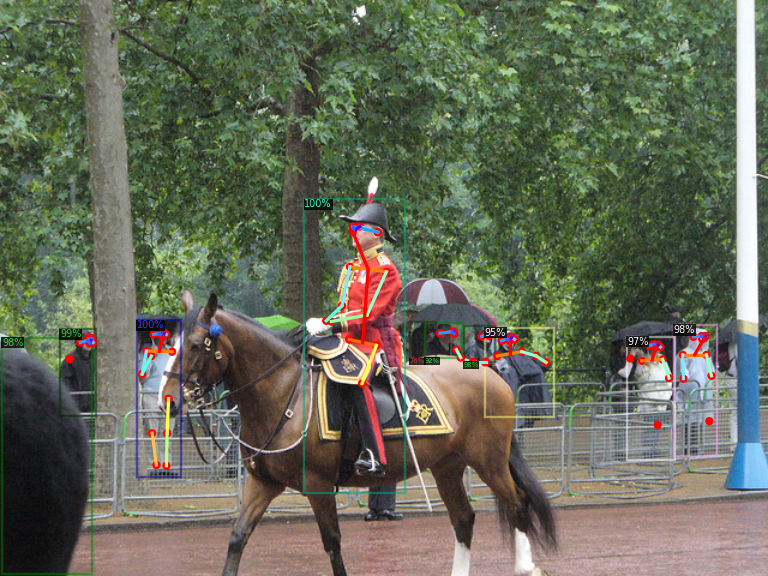

In [ ]:
# Inference with a keypoint detection model
cfg = get_cfg()   # get a fresh new config
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

WARNING [10/15 06:33:37 d2.config.compat]: Config './detectron2_repo/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.


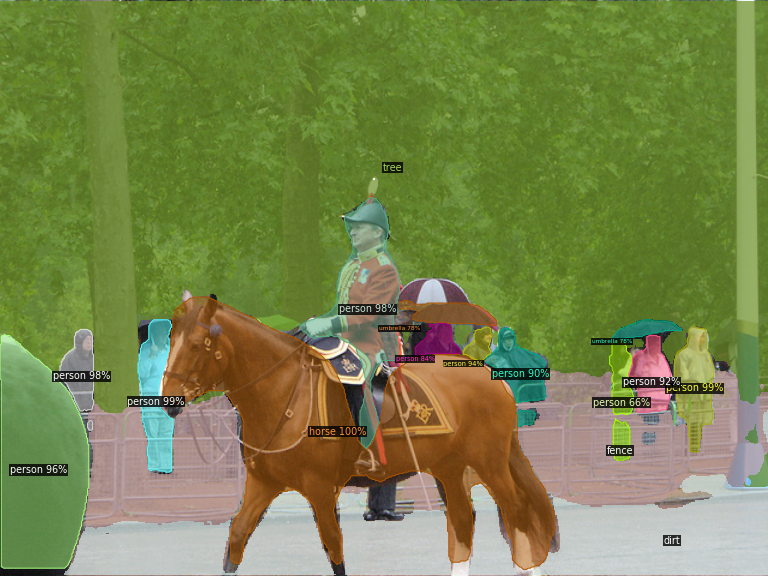

In [ ]:
# Inference with a panoptic segmentation model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(out.get_image()[:, :, ::-1])

# Run panoptic segmentation on a video

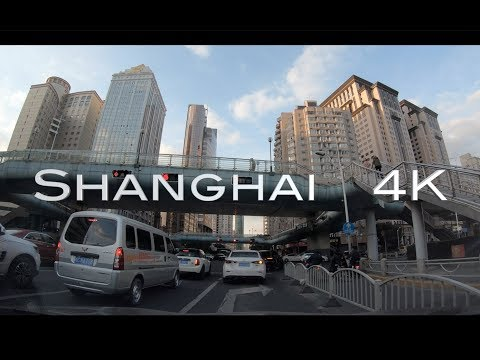

In [ ]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("ll8TgCZ0plk", width=500)
display(video)

In [ ]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!pip uninstall -y opencv-python-headless opencv-contrib-python
!apt install python3-opencv  # the one pre-installed have some issues
!youtube-dl https://www.youtube.com/watch?v=ll8TgCZ0plk -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

In [ ]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes) with the "demo.py" tool we provided in the repo.
!git clone https://github.com/facebookresearch/detectron2
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

In [ ]:
# Download the results
from google.colab import files
files.download('video-output.mkv')